In [1]:
import pandas as pd

# 读取Excel文件
df = pd.read_excel('bjsj(脱敏).xlsx')  # 替换为你的Excel文件路径

# 去除A列和B列的重复值
# 假设A列的列名是'ColumnA'，B列的列名是'ColumnB'
# 去除A列和B列的重复值，同时保留原始DataFrame的其他列
df_unique = df.drop_duplicates(subset=['bjnr报警内容'], keep='first')

# 将去除重复值后的DataFrame保存到新的Excel文件
df_unique.to_excel('data/unique_values.xlsx', index=False)  # 保存路径和文件名根据需要替换

In [2]:
import pandas as pd
import re

# 读取原始的Excel文件
file_path = './data/unique_values.xlsx'  # 替换为你的Excel文件路径
df = pd.read_excel(file_path)

# 选择需要保留的三列，假设这三列分别为 'bjnr报警内容', 'bjlbmc警情粗略类别', 'bjlxmc警情细致类别'
columns_to_keep = ['bjnr报警内容', 'bjlbmc警情粗略类别', 'bjlxmc警情细致类别']
df_subset = df[columns_to_keep]

# 定义一个函数来移除报警内容中的特定部分


# 读取停用词表
def load_stopwords(filepath):
    with open(filepath, 'r', encoding='utf-8') as file:
        stopwords = set(file.read().splitlines())
    return stopwords

stopwords = load_stopwords('model/stopwords.txt')


def remove_prefix(text):
    # 移除"报警："之前的内容
    match = re.search(r'报警：(.*)', text)
    cleaned_text = match.group(1) if match else text
    
    # 移除日期格式的内容，例如"2024年4月11日"或"2024-04-11"
    cleaned_text = re.sub(r'\d{4}[年-]\d{1,2}[月-]\d{1,2}[日]?', '', cleaned_text)

    #移除"接警称"之前的内容
    match = re.search(r'报警称(.*)', cleaned_text)
    cleaned_text = match.group(1) if match else cleaned_text

    #移除"门口"之前的内容
    match = re.search(r'门口(.*)', cleaned_text)
    cleaned_text = match.group(1) if match else cleaned_text

    #删除含有特定字符的句子
    specific_words=[]

    for word in specific_words:
        cleaned_text = cleaned_text.replace(word, '')

    # 移除括号（*）之间的所有内容
    cleaned_text = re.sub(r'\(.*?\)', '', cleaned_text)
    cleaned_text = re.sub(r'\（.*?\）', '', cleaned_text)

    # 移除"【"之后的所有内容
    cleaned_text = re.sub(r'【.*', '', cleaned_text)

    # 移除特定字符
    specific_chars=['XX','的','：','，','。','*','、',',','1','2','3','4','5','6','7','8','9','0','在','其','时','分','秒','<br/>','月','日','报警','对方','称'
                    ,'现','民警','有','将','称','与','此处','等人','‘','’','“','”','街','路', '号','院','小区','楼','栋','村', '区', '市', '县', '镇', '乡', '村',
                      '组','单元','户','室','层','(',')','（','）','-','--','.','@','口']
    for char in specific_chars:
        cleaned_text = cleaned_text.replace(char, '')

        # 移除停用词
    words = cleaned_text.split()
    cleaned_text = ' '.join(word for word in words if word not in stopwords)

    

    return cleaned_text

    


# 应用该函数到 'bjnr报警内容' 列
df_subset['bjnr报警内容'] = df_subset['bjnr报警内容'].apply(remove_prefix)

# 根据 'bjnr报警内容' 列内容进行去重
df_unique = df_subset.drop_duplicates(subset=['bjnr报警内容'], keep='first')

# 保存为新的Excel文件
output_file_path = './data/cleand.xlsx'  # 替换为你希望保存的新Excel文件路径
df_unique.to_excel(output_file_path, index=False)

print(f"已保存新文件至 {output_file_path}")


已保存新文件至 cleand.xlsx


C:\Users\18080\AppData\Local\Temp\ipykernel_3692\2449071187.py:72: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_subset['bjnr报警内容'] = df_subset['bjnr报警内容'].apply(remove_prefix)


In [4]:


# Load the provided Excel file
file_path = './data/cleand.xlsx'
data = pd.read_excel(file_path, sheet_name='Sheet1')


# Group by '警情粗略类别' and '警情细致类别' and count the occurrences
count_data = data.groupby(['bjlbmc警情粗略类别', 'bjlxmc警情细致类别']).size().reset_index(name='counts')

# Display the count data
print(count_data)

# Optionally, save the count data to a new Excel file
output_file_path = './警情类别计数结果.xlsx'
count_data.to_excel(output_file_path, index=False)

   bjlbmc警情粗略类别 bjlxmc警情细致类别  counts
0          举报线索       其它举报线索      20
1          举报线索         提供线索      19
2          交通警情         交通事故      20
3          交通警情         交通保障       5
4          交通警情         交通秩序      15
..          ...          ...     ...
59         群众求助  水、电、气、热险情求助      13
60         群众求助         自杀求助      15
61         群众求助         走失求助      14
62         群体事件       其它群体警情      19
63         群体事件         聚众上访      20

[64 rows x 3 columns]


In [4]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import jieba
from collections import Counter

Building prefix dict from the default dictionary ...
Loading model from cache C:\Users\18080\AppData\Local\Temp\jieba.cache
Loading model cost 0.524 seconds.
Prefix dict has been built successfully.


所有报警内容词频统计：
被: 211
人: 142
不: 76
发生: 69
男子: 67
内: 60
反映: 55
电话: 54
一名: 54
需要: 53
求助: 53
元: 47
后: 47
人员: 47
手机: 45
上: 44
问题: 44
殴打: 42
给: 40
发: 39
并: 38
被盗: 37
已: 37
价值: 36
一辆: 36
因: 35
一: 34
骗: 34
着火: 33
公司: 31
无: 30
情况: 29
看到: 28
是: 28
家中: 28
要求: 28
附近: 28
受伤: 28
车辆: 27
纠纷: 26
具体情况: 26
扰民: 26
中: 25
通过: 25
车: 25
余元: 24
电动车: 24
离开: 24
工作: 24
联系: 24
了: 24
酒店: 24
执法: 24
方向: 24
未: 23
此: 23
朋友: 23
要: 23
到场: 23
停放: 22
太原: 22
他人: 22
对面: 22
一直: 22
事故: 22
和: 21
微信: 21
场: 21
驾驶: 21
西: 21
交警: 21
自行车: 20
万元: 20
醉酒: 20
处理: 20
派出所: 20
购买: 20
裸聊: 20
小: 20
到: 20
孩子: 20
我: 20
赌博: 20
举报: 20
交通: 20
丈夫: 19
怀疑: 19
下: 19
让: 18
威胁: 18
宿舍: 18
所: 18
不清: 17
转账: 17
为: 17
涉嫌: 17
敲诈: 17
滋事: 17
卖淫嫖娼: 17
影响: 17
逃逸: 17
两名: 16
男友: 16
中环: 16
碰撞: 16
遗失: 16
监控: 15
南: 15
视频: 15
左右: 15
至: 15
信息: 15
严重: 15
旁边: 15
新: 15
北: 14
向: 14
女子: 14
找: 14
接到: 14
还: 14
无法: 14
收到: 14
线索: 14
身份证: 14
出租车: 14
东: 14
清徐: 14
打: 14
帮助: 14
自己: 14
调查: 14
通知: 14
不详: 14
抢走: 13
告知: 13
该: 13
花园: 13
网上: 13
看见: 13
许: 12
认识: 12
下午: 12
嫌疑人: 12
根据: 12
家: 1

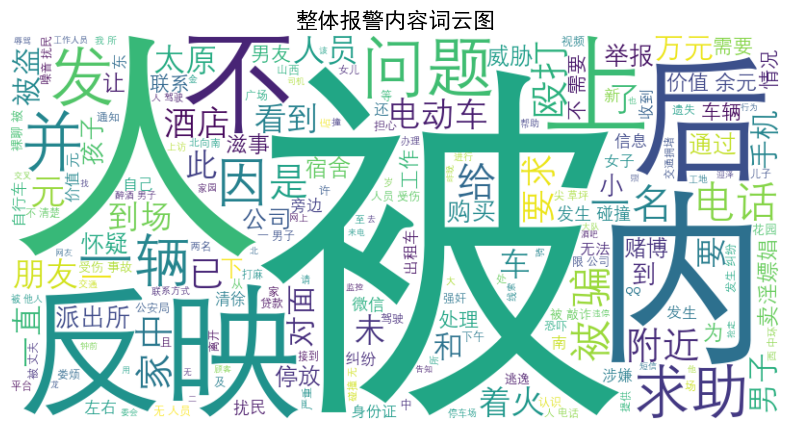

In [5]:
import pandas as pd
import jieba
from collections import Counter
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# 读取清洗后的 Excel 文件
df = pd.read_excel('./data/cleand.xlsx')

# 定义要清洗的列
df_subset = df[['bjnr报警内容']].dropna()

# 对报警内容进行分词，并将分词结果存储到新列，同时计算词频
all_words = []
df_subset['分词结果'] = df_subset['bjnr报警内容'].apply(lambda x: ' '.join(jieba.lcut(x)))
df_subset['分词列表'] = df_subset['bjnr报警内容'].apply(lambda x: jieba.lcut(x))
all_words = [word for sublist in df_subset['分词列表'].tolist() for word in sublist]

# 保存到新的 Excel 文件
df_subset.drop(columns=['分词列表'], inplace=True)
#df_subset.to_excel('cleaned1.xlsx', index=False)

# 计算词频
word_list_filtered = [word for word in all_words if word.strip() != '']
counter = Counter(word_list_filtered)

# 输出词频统计结果
print("所有报警内容词频统计：")
for word, count in counter.most_common():
    print(f"{word}: {count}")

# 生成词云
word_cloud_text = ' '.join(all_words)
wordcloud = WordCloud(font_path='./Deng.ttf', width=800, height=400, background_color='white').generate(word_cloud_text)

# 显示词云
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('整体报警内容词云图', fontname='SimHei', fontsize=16)
plt.show()


警情粗略类别: 举报线索 - 警情细致类别: 其它举报线索
未成年人: 6
举报: 4
酒吧: 4
进入: 3
消费: 3
人: 3
对面: 3
酒店: 3
黑桃: 2
小酒馆: 2
反映: 2
新: 2
看到: 2
要求: 2
扰民: 2
信息: 2
亲茂业: 2
此: 2
不: 2
打麻: 2
太原: 2
人员: 2
转接: 1
亚特: 1
莱帝斯酒: 1
吧: 1
人此: 1
捞: 1
地沟油: 1
一巷: 1
举报人: 1
下象棋: 1
行骗: 1
匿名: 1
下: 1
唐久: 1
便: 1
从早到晚: 1
使用: 1
高音喇叭: 1
噪音: 1
严重: 1
且: 1
身体: 1
不好: 1
根本无法: 1
入睡: 1
希望: 1
处置: 1
对: 1
保密: 1
方糖: 1
KTV: 1
举: 1
报偿: 1
陪侍: 1
南中: 1
麦克斯: 1
通过: 1
微信加: 1
同城: 1
好友: 1
提供: 1
陪: 1
玩: 1
喝酒: 1
等: 1
服务: 1
引诱: 1
到: 1
南如家华: 1
驿: 1
该: 1
登记: 1
入住: 1
身份证: 1
天寿座: 1
家人: 1
东曲: 1
左手: 1
家: 1
麻馆: 1
科技: 1
大学: 1
自行: 1
管理: 1
微信群: 1
昨发: 1
两名: 1
群内: 1
发送: 1
黄色: 1
视频: 1
需要: 1
接待: 1
敦化: 1
坊: 1
派出所: 1
水房: 1
内: 1
十几: 1
桶: 1
柴油: 1
存: 1
安全隐患: 1
胡同: 1
内发: 1
许女: 1
尖: 1
草坪: 1
实验: 1
小学: 1
双双: 1
文具: 1
商店: 1
该店: 1
卖炮: 1
钟前: 1
南: 1
高速: 1
龙悦: 1
一一: 1
会议厅: 1
场多: 1
人参: 1
会议: 1
场: 1
宣传: 1
中国: 1
梦: 1
每人: 1
缴纳: 1
元: 1
以后: 1
会: 1
获利: 1
余万元: 1
怀疑: 1
异常: 1
王兰馨: 1
幼儿园: 1
看见: 1
人持: 1
砍刀: 1
打架: 1
具体情况: 1
不详: 1
星辉: 1
国家: 1
正当: 1
茂业: 1
二期: 1
商铺: 1
巴夫: 1
猫: 1
未成年: 1
出入: 1




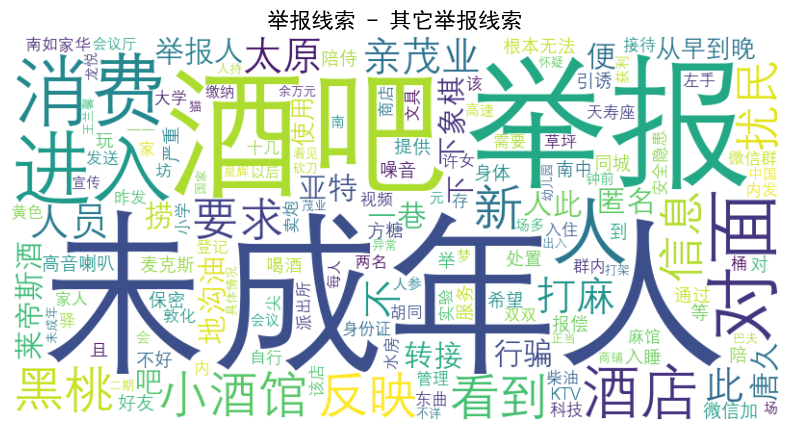

警情粗略类别: 举报线索 - 警情细致类别: 提供线索
举报: 8
赌博: 7
卖淫嫖娼: 5
反映: 4
内: 3
小姐: 3
一巷: 3
存: 3
要求: 3
小马: 2
孟家: 2
三巷: 2
行为: 2
打麻: 2
举报人: 2
四巷: 2
雅苑: 2
且: 2
下: 2
人员: 2
保密: 2
人: 2
五巷: 1
洗浴: 1
对面: 1
聚众赌博: 1
具体: 1
不清: 1
柳巷: 1
阿凡: 1
达: 1
奥林: 1
花园: 1
旁边: 1
理发店: 1
负一善: 1
云: 1
台球厅: 1
人以: 1
方式: 1
可: 1
联系: 1
北美: 1
金: 1
此人: 1
马庄星: 1
拨打: 1
多女: 1
清馨: 1
无法: 1
提供: 1
具体位置: 1
情况: 1
坚持: 1
到场: 1
处置: 1
迎盛科: 1
大厦: 1
电梯: 1
左手: 1
处: 1
匿名举报: 1
迎锦麟: 1
东方: 1
酒店: 1
北侧: 1
拉客: 1
住: 1
属: 1
要: 1
殴打: 1
他人: 1
具体情况: 1
讲不清: 1
并: 1
我台: 1
对: 1
信息: 1
龙源: 1
旅馆: 1
店内: 1
此: 1
个人信息: 1
此放: 1
烟花: 1
扰民: 1
巷子: 1
并且: 1
放哨: 1
北: 1
行为人: 1
就场: 1
需要: 1
答复: 1
蓝: 1
房间: 1
案发: 1
地人: 1
迎: 1
清新: 1
晚上: 1
后人: 1
卖淫: 1
不: 1
希望: 1
穿: 1
警服: 1
开: 1
警车: 1
前往: 1
一中: 1
山上: 1
娃哈哈: 1
桶装水: 1
门面: 1
金西: 1
朝和友: 1
棋牌: 1
该处: 1
扣: 1
点点: 1




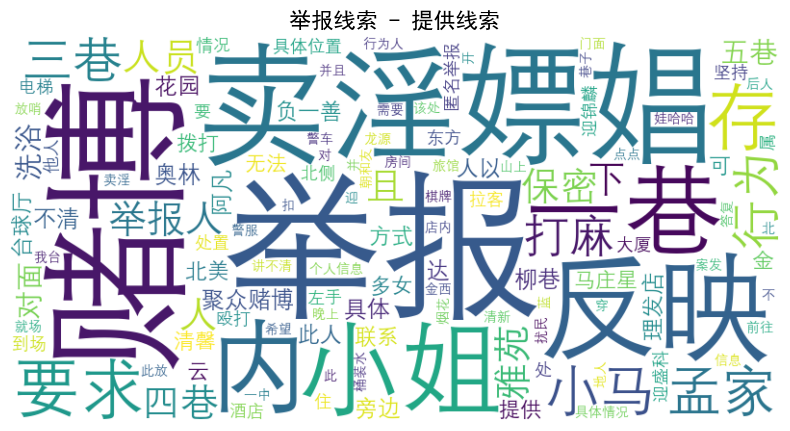

警情粗略类别: 交通警情 - 警情细致类别: 交通事故
发生: 34
事故: 19
受伤: 17
碰撞: 16
驾驶: 14
人员: 12
人: 11
车: 10
无: 10
一辆: 10
方向: 8
电动车: 7
刚刚: 6
刚: 6
自行车: 5
无人: 5
丰田: 4
由东向西: 4
车辆: 4
小型汽车: 4
由北向南: 4
停车场: 3
孩子: 3
<: 3
涉及: 3
>: 3
奥迪车: 3
需要: 3
停放: 3
太: 3
一辆车: 2
北: 2
出处: 2
骑: 2
联系方式: 2
倒车: 2
不: 2
中: 2
大众: 2
由南向北: 2
左右: 2
比亚迪: 2
北向南: 2
货车: 2
齿科: 2
对面: 2
凯美瑞: 2
汉兰达车: 2
:: 2
行至: 1
泥: 1
屯河: 1
家: 1
山: 1
为: 1
相撞: 1
荣清枫: 1
华景: 1
林肯车: 1
护栏: 1
杨先生: 1
吉利车: 1
方: 1
腿部: 1
着急: 1
上学: 1
未留下: 1
点: 1
导致: 1
旁边: 1
躲避: 1
摔倒: 1
头部: 1
擦伤: 1
公交: 1
出租车: 1
钟前: 1
奥斯卡: 1
内张: 1
先生: 1
红旗车: 1
香檀内: 1
地面: 1
物业: 1
王太: 1
生来: 1
电: 1
白色: 1
轿车: 1
防跟车: 1
杆: 1
马龙: 1
车面: 1
坑: 1
爆胎: 1
今天: 1
晚上: 1
医: 1
一名: 1
醉酒: 1
撞: 1
了: 1
沃尔沃: 1
车墙: 1
保利: 1
天珺恒: 1
大悦: 1
府: 1
之间: 1
巷子: 1
往东米: 1
孔昊: 1
深蓝: 1
半空: 1
悬挂: 1
电缆: 1
东巷: 1
程地: 1
库内: 1
帕萨特: 1
和: 1
千峰: 1
派出所: 1
朋友: 1
饮酒: 1
讹人: 1
已报: 1
去场: 1
处理: 1
吕晨方: 1
接警: 1
催警: 1
医北: 1
徐先生: 1
邮: 1
中医: 1
南门: 1
韩先生: 1
家属: 1
骑行: 1
南向: 1
标致: 1
被: 1
灰色: 1
理想: 1
车撞: 1
后: 1
离开: 1




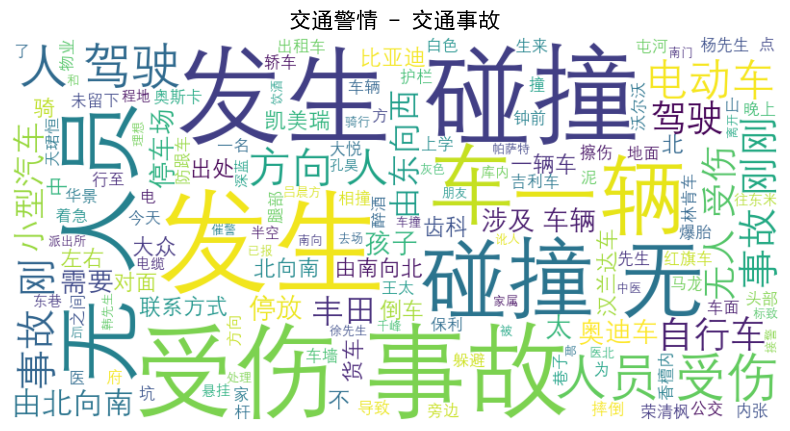

警情粗略类别: 交通警情 - 警情细致类别: 交通保障
多: 2
交通堵塞: 2
高速: 2
小: 1
黄河: 1
大道: 1
附近: 1
超载: 1
车辆: 1
较: 1
亲: 1
孩子: 1
脚趾: 1
骨折: 1
祁到: 1
太原: 1
上: 1
从: 1
迎西: 1
下: 1
前往: 1
山: 1
大二: 1
驾驶: 1
白色: 1
尼桑: 1
求助: 1
双: 1
严重: 1
清徐: 1
信灯: 1
故障: 1
造成: 1
起: 1
交通事故: 1




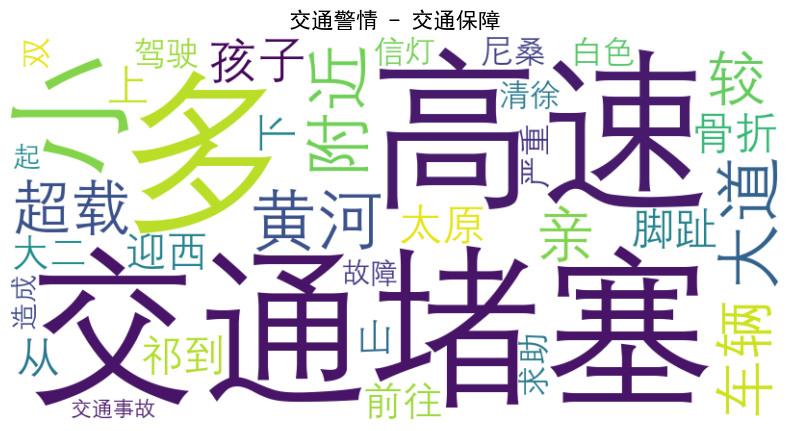

警情粗略类别: 交通警情 - 警情细致类别: 交通秩序
严重: 6
交通: 5
反映: 4
拥堵: 4
交通拥堵: 3
违章: 3
停车: 3
车辆: 2
造成: 2
交通堵塞: 2
堵车: 2
南向: 2
沙河: 2
堵塞: 2
北: 2
上: 2
附近: 2
柳巷: 1
外地: 1
游客: 1
乱: 1
行: 1
出租车: 1
网约车: 1
南: 1
南侧: 1
北格: 1
往滨: 1
北方: 1
向: 1
建南: 1
北岸: 1
多辆: 1
车: 1
反馈: 1
违停: 1
杨家: 1
峪: 1
高速: 1
沿岸: 1
儿童: 1
医: 1
西北角: 1
及乱: 1
象: 1
导致: 1
很多: 1
家长: 1
来接: 1
孩子: 1
开车: 1
交叉: 1
北向南: 1
此: 1
晋北: 1
中环: 1
一名: 1
男子: 1
积雪: 1
铲: 1
恐: 1
发生: 1
隐患: 1
通知: 1
台: 1
聚宝盆: 1
人此: 1
骑: 1
摩托车: 1
炸: 1




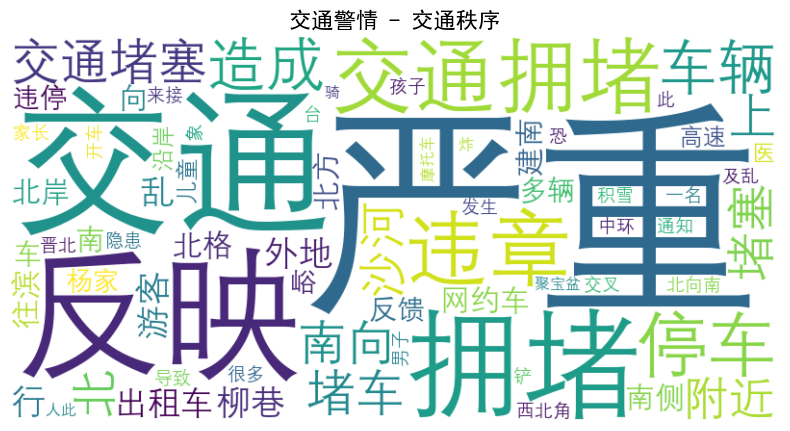

警情粗略类别: 交通警情 - 警情细致类别: 交通设施
信灯: 7
反映: 6
故障: 6
方向: 6
红灯: 5
五一广场: 4
绿灯: 4
信: 4
灯不亮: 4
一起: 3
亮: 3
迎: 3
同亮: 3
交通设施: 3
由南向北: 3
直行: 3
电话: 3
南向: 2
北: 2
危险: 2
红绿灯: 2
东: 2
需要: 2
西向东: 2
建: 2
左转: 2
只亮: 2
学生: 2
已: 2
反馈: 2
规范: 2
；: 2
到场: 2
执法: 2
是: 2
电平: 2
滨: 1
小店: 1
高速: 1
往南辅: 1
道: 1
上: 1
井盖: 1
移位: 1
比较: 1
肯德基: 1
对面: 1
北方: 1
向: 1
寇王: 1
两天: 1
尽快: 1
修复: 1
天天: 1
早上: 1
掉头: 1
车道: 1
每天: 1
拥堵: 1
麦当劳: 1
岗南: 1
向北: 1
一直: 1
黄灯: 1
闪: 1
由西向东: 1
及: 1
绿地: 1
无法: 1
正常: 1
左: 1
转灯: 1
灯: 1
左右: 1
恐: 1
过往: 1
永: 1
东西: 1
双向: 1
东面: 1
金汾: 1
交叉: 1
交警: 1
处理: 1
告知: 1
请: 1
指挥: 1
按照: 1
三: 1
填写: 1
处警: 1
单: 1
全程: 1
开启: 1
G: 1
记录仪: 1
辅警: 1
不得: 1
单独: 1
开具: 1
处罚: 1
文书处理: 1
事故: 1
认定: 1
责任: 1
华苑: 1
西巷: 1
人行道: 1
北面: 1
纯粹: 1
不亮: 1
南面: 1
南北: 1
建议: 1
调: 1
成: 1
之前: 1
加: 1
交通拥堵: 1
反段: 1
疑似: 1
我台: 1
指令: 1
设施: 1
处: 1
查看: 1
处置: 1
中环: 1
东向西: 1
通知: 1
间: 1
较: 1
长: 1
无: 1




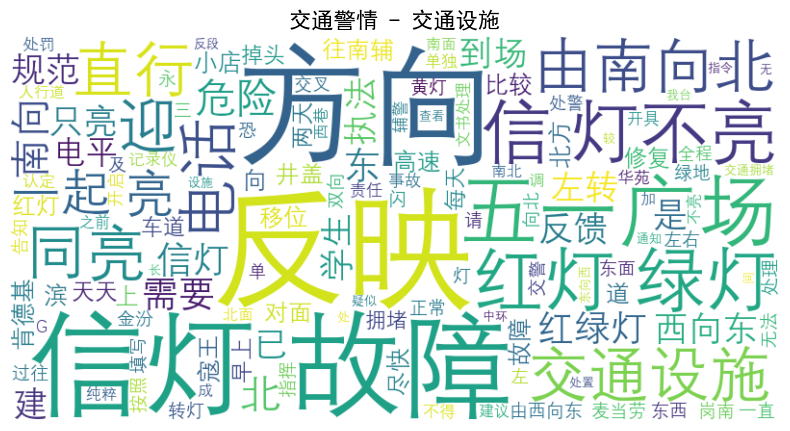

警情粗略类别: 交通警情 - 警情细致类别: 交通违法
违章: 8
交通: 8
交警: 8
不: 7
影响: 6
车辆: 6
违停: 6
停放: 5
处理: 5
车: 5
停车: 4
无法: 4
段: 4
电话: 4
方向: 3
一辆: 3
人: 3
内: 3
需要: 3
本田: 3
到场: 3
要求: 3
作为: 3
自己: 3
由北向南: 2
便: 2
道: 2
拒绝: 2
西向东: 2
反映: 2
宝马: 2
是: 2
举报: 2
发生: 2
违法: 2
严重: 2
保密: 2
此: 2
情况: 2
法: 2
大于: 2
情: 2
如果: 2
要: 2
联系人: 2
亲往: 1
西米南: 1
吉普车: 1
堵住: 1
由西向东: 1
出租车: 1
挪车: 1
鸿发: 1
洗车行: 1
比亚迪: 1
南内环: 1
快到: 1
被: 1
别停: 1
并且: 1
方: 1
怀疑: 1
方酒: 1
驾: 1
红星: 1
紫御: 1
半山: 1
期段: 1
多人: 1
未通: 1
天然气: 1
家中: 1
都: 1
煤气罐: 1
火灾: 1
消防车: 1
通过: 1
安全隐患: 1
贴单: 1
北: 1
启辰车: 1
追加: 1
来电: 1
此车: 1
还场: 1
督促: 1
南: 1
杨先生: 1
吉利车: 1
危险: 1
驾驶: 1
别人: 1
视频: 1
点: 1
黄色: 1
小巴: 1
报废: 1
并: 1
长期: 1
占用: 1
兜售: 1
水果: 1
人报: 1
发动机: 1
归属: 1
交警队: 1
管辖: 1
如意: 1
龙城: 1
湾: 1
西门: 1
北米: 1
龙: 1
铁皮: 1
围挡: 1
处: 1
黑色: 1
大众: 1
白色: 1
万后漪: 1
通行: 1
西: 1
联系方式: 1
违法行为: 1
长: 1
国兴: 1
西巷: 1
每天晚上: 1
停: 1
两侧: 1
各: 1
两排: 1
以前: 1
回复: 1
晚上: 1
不贴: 1
单是: 1
规定: 1
拿出: 1
明文规定: 1
安全法: 1
还是: 1
？: 1
答复: 1
扬言: 1
到: 1
上级部门: 1
人自是: 1
纳税人: 1
政府: 1
万: 1
解决: 1
太原: 1
就: 1
可能: 1
成为: 1
文人: 1
休息: 1
不能: 1
配合: 1
迎段: 1
事

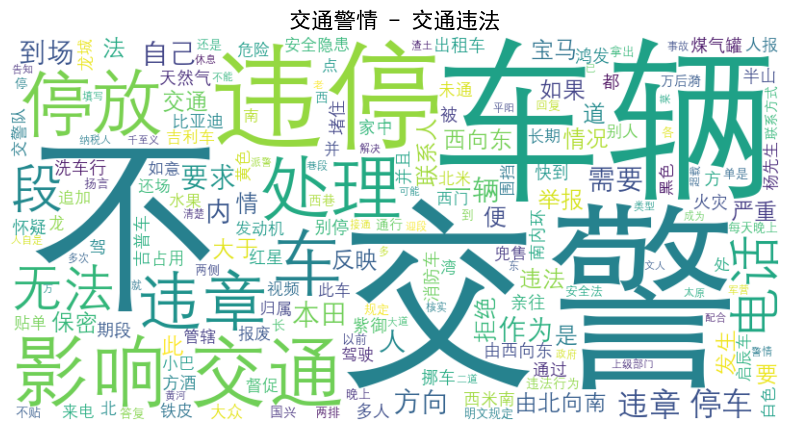

警情粗略类别: 交通警情 - 警情细致类别: 交通逃逸
逃逸: 17
被: 14
蹭: 7
撞: 7
一辆: 7
刮: 6
肇事: 5
肇事车: 4
车: 4
车辆: 4
受伤: 4
娄烦: 3
孩子: 3
一辆车: 2
停放: 2
发: 2
御景苑: 2
下: 2
电动车: 2
了: 2
国道: 2
附近: 2
人: 2
铲车: 2
医: 1
停车: 1
厂: 1
为车: 1
不详: 1
宝马车: 1
昨晚: 1
大盂: 1
西北: 1
二环: 1
工地: 1
雪佛兰: 1
他: 1
停: 1
A: 1
小轿车: 1
灰色: 1
自行: 1
去医: 1
B: 1
一下: 1
她: 1
吉利车: 1
停下: 1
富海: 1
加油站: 1
厢: 1
货车: 1
撞死: 1
一条: 1
狗: 1
下庄花: 1
南侧: 1
广汽传祺车: 1
右前: 1
保险杠: 1
黑色: 1
无: 1
人员: 1
东于: 1
农商: 1
银行: 1
对面: 1
QQ: 1
腾飞: 1
段: 1
五菱: 1
自行车: 1
后: 1
无人: 1
城往: 1
太忻: 1
大道: 1
草坪: 1
和: 1
树: 1
压坏: 1
槐韵: 1
山庄: 1
大众: 1
早上: 1
:: 1
山西: 1
厚生: 1
新: 1
材料: 1
公司: 1
西门: 1
为: 1
长安: 1
车撞: 1
到: 1
南门: 1
望景: 1
花园: 1
哥哥: 1
牛: 1
小车: 1
广他: 1
吉利: 1
熊猫: 1
电车: 1




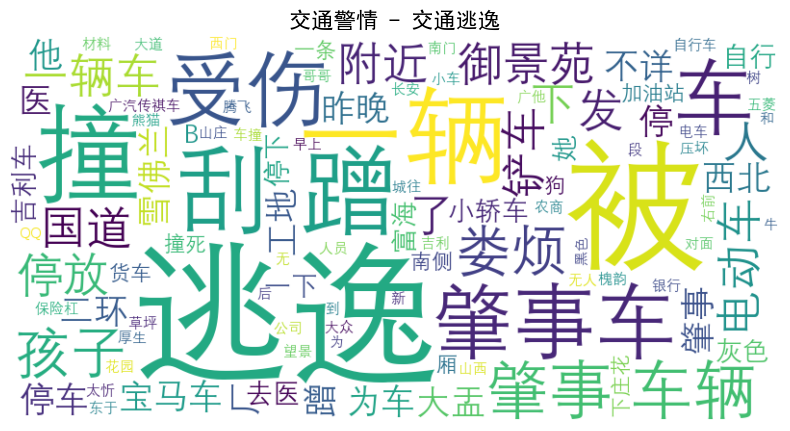

警情粗略类别: 交通警情 - 警情细致类别: 其它交通管理
上: 7
交通拥堵: 6
疏导: 5
一名: 4
看见: 4
内: 4
方向: 4
需要: 4
交警: 4
交通: 4
北向南: 3
步行: 3
告知: 3
电话: 3
通知: 3
处理: 3
到场: 3
南向: 3
北: 3
南: 2
公里: 2
桥: 2
西: 2
人: 2
行人: 2
最: 2
左侧: 2
车道: 2
老: 2
军营: 2
面: 2
情况: 2
司机: 2
了: 2
存: 2
安全隐患: 2
已: 2
车辆: 2
高架桥: 2
指挥: 2
吉利车: 2
由南向北: 2
并: 2
影响: 2
反馈: 2
规范: 2
；: 2
执法: 2
西快: 1
到: 1
处: 1
老上: 1
平阳: 1
中环: 1
快到: 1
迎桥: 1
科技: 1
大学: 1
东巷: 1
亲: 1
由东向西: 1
机动: 1
三轮车: 1
停: 1
机动车道: 1
睡着: 1
滨东: 1
由北向南: 1
辅内: 1
过: 1
皮卡车: 1
着火: 1
已经: 1
下车: 1
消防: 1
东北: 1
往南米: 1
一辆车: 1
违规: 1
掉头: 1
系: 1
方式: 1
保密: 1
东: 1
一条: 1
已钟: 1
距离: 1
大井峪: 1
新能源: 1
车: 1
冒烟: 1
南屯: 1
摆: 1
庙会: 1
导致: 1
拨打: 1
转警: 1
派警: 1
晋阳: 1
大道: 1
法官: 1
学信: 1
灯下: 1
找要: 1
去: 1
玉泉山: 1
导航: 1
让: 1
自己: 1
走: 1
非机动车: 1
道: 1
逆行: 1
反: 1
中间: 1
花池: 1
内名: 1
老人: 1
拥堵: 1
严重: 1
由: 1
二: 1
维也纳: 1
段: 1
武宿: 1
高速: 1
报过: 1
男子: 1
岁: 1
左右: 1
行走: 1
东向西: 1
行驶: 1
过程: 1
中: 1
没油: 1
转: 1
安排: 1
反映: 1
三个: 1
垃圾桶: 1
黄线: 1
放着: 1
和: 1
坐轮椅: 1
倒: 1
地上: 1
通行: 1
过去: 1
请: 1
按照: 1
三: 1
填写: 1
处警: 1
单: 1
全程: 1
开启: 1
G: 1
记录仪: 1
辅警: 1
不得: 1
单独: 1
开具: 1
处罚: 

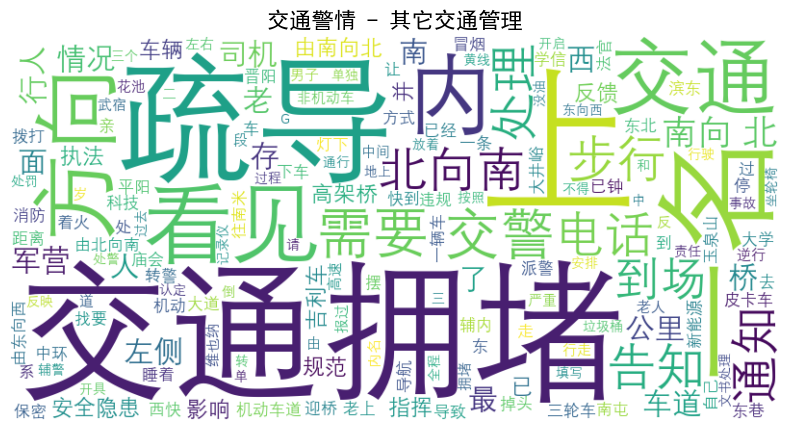

警情粗略类别: 其他报警类别 - 警情细致类别: 其它报警类型
按照: 4
工作: 4
要求: 4
请: 3
出警: 3
并: 3
闭环: 3
管理: 3
场: 2
纠纷: 2
派出所: 2
多报: 2
情况: 2
不: 2
挂断: 2
三: 2
反馈: 2
及: 2
警情级: 2
持续: 2
跟进: 2
中心: 2
舆情: 2
炒作: 2
亲茂业: 1
黑桃: 1
小酒馆: 1
反映: 1
未成年人: 1
进入: 1
等: 1
不满: 1
岁: 1
进: 1
酒吧: 1
家庭: 1
报过: 1
警想: 1
定位: 1
已: 1
告知: 1
咨询: 1
他人: 1
发生: 1
它: 1
拒讲: 1
唐明: 1
所: 1
我: 1
台: 1
讲话: 1
报过警: 1
兴华: 1
刑警队: 1
先: 1
指令: 1
接待: 1
人: 1
了解: 1
依法: 1
妥善处理: 1
严格: 1
省公安厅: 1
携带: 1
M: 1
对讲机: 1
完整: 1
填报: 1
": 1
间: 1
内容: 1
执法: 1
记录仪: 1
编请局: 1
盯: 1
办: 1
处置: 1
结果: 1
属地: 1
过程: 1
中: 1
严格遵守: 1
接处警: 1
规定: 1
规范: 1
佩戴: 1
单警: 1
装备: 1
局: 1
同步进行: 1
检点: 1
做好: 1
视频: 1
源头: 1
管控: 1
；: 1
请局: 1
同步: 1
原则: 1
及警: 1
情级: 1
盯办: 1
防止: 1
如发: 1
网络: 1
或: 1
迹象: 1
及局: 1
情指: 1
报: 1
通知: 1
局网安: 1
大队: 1
开展: 1
咨所: 1
显示: 1
查: 1
车主: 1
电话: 1
自行: 1




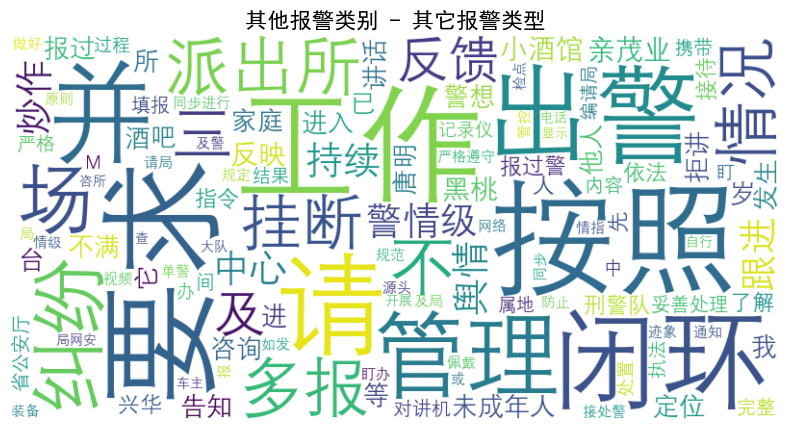

警情粗略类别: 刑事案件 - 警情细致类别: 伤害
被: 3
犯罪: 2
嫌疑人: 2
宋鹏: 2
用: 2
水果刀: 2
职: 1
刑警队: 1
接到: 1
上级: 1
指派: 1
山西省: 1
公安局: 1
山西: 1
转型: 1
综合: 1
改革: 1
局教: 1
派出所: 1
秦凯: 1
带领: 1
四名: 1
辅警杏大: 1
朱: 1
寻找: 1
工作: 1
过程: 1
中: 1
手持: 1
菜刀: 1
秦开: 1
头部: 1
左侧: 1
砍伤: 1
许柳: 1
巷茂业: 1
百货: 1
停车场: 1
入处: 1
和: 1
发生: 1
角后: 1
一名: 1
男子: 1
划伤: 1
脖子: 1
观内: 1
丈夫: 1
朋友: 1
从: 1
背后: 1
捅破: 1
肺部: 1
人省: 1
人民: 1
医: 1
急诊: 1
抢救: 1




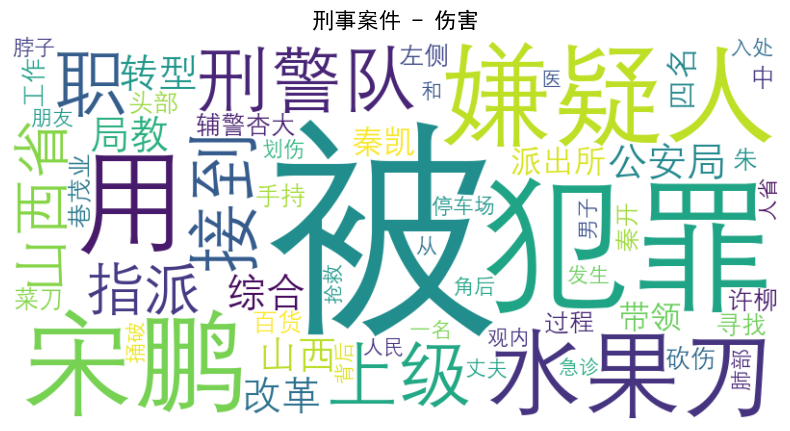

警情粗略类别: 刑事案件 - 警情细致类别: 其它刑警情
被: 8
公司: 7
派出所: 6
并: 5
骗: 5
涉嫌: 5
报案: 4
限: 4
年: 4
情况: 3
联系: 3
我: 3
了: 3
合同: 3
元: 3
商业银行: 3
到: 3
桃园: 3
发: 3
后: 3
许: 3
工作: 3
宋: 3
向前: 3
肖向兰: 3
闫所亮: 3
行为: 3
卖淫嫖娼: 3
打: 3
为: 3
辱骂: 3
父母: 3
房产: 3
下: 2
贷款: 2
男友: 2
不: 2
还: 2
单位: 2
签订: 2
《: 2
服务器: 2
销售: 2
》: 2
购买: 2
支付: 2
后发: 2
收到: 2
货物: 2
严重: 2
股份: 2
我局: 2
支行: 2
等: 2
办公: 2
微信: 2
汇星: 2
APP: 2
万元: 2
国雅城: 2
购房: 2
开发商: 2
他人: 2
至今: 2
天前: 2
清徐: 2
让: 2
中发: 2
所: 2
卖淫: 2
传唤: 2
接受: 2
调查: 2
公安局: 2
资金: 2
线索: 2
光大银行: 2
犯罪: 2
嫌疑人: 2
介绍: 2
工作人员: 2
瑞云: 2
陈进: 2
万漪: 2
叠翠: 2
坊: 2
套: 2
开汉庭: 1
酒店: 1
斜对面: 1
哲摄镜: 1
儿童: 1
摄影: 1
昨: 1
前男友: 1
不知情: 1
拿: 1
身份证: 1
手机: 1
万余元: 1
钱: 1
孔: 1
繁鑫来: 1
孔繁鑫: 1
山西: 1
柒韵: 1
文化: 1
科技: 1
用于: 1
冰河: 1
KsM: 1
金额: 1
约定: 1
不符: 1
并孔: 1
繁鑫拉黑: 1
遂: 1
来: 1
赵益明: 1
周世学: 1
使用: 1
伪造: 1
转型: 1
商业: 1
承兑汇票: 1
资料: 1
四川: 1
广元: 1
利州: 1
开立: 1
对公: 1
账: 1
闹事: 1
滞留: 1
干扰: 1
秩序: 1
左右: 1
至许: 1
山西省: 1
许西内: 1
陌生人: 1
添加: 1
账后: 1
根据: 1
提示: 1
操作: 1
下载: 1
刷单: 1
水: 1
锦绣: 1
商务: 1
做: 1
跨境: 1
电商: 1
收款: 1
邮箱: 1
换掉: 1
受损: 1
约: 1
多万: 1
因国雅城: 1
经济

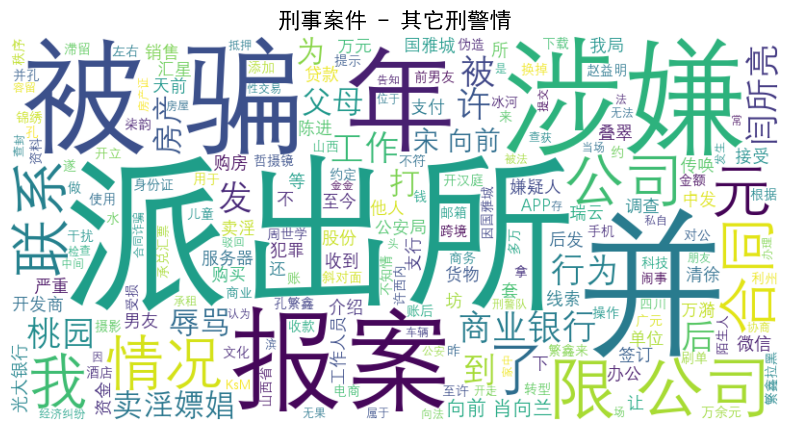

警情粗略类别: 刑事案件 - 警情细致类别: 强奸
被: 16
强奸: 12
男子: 7
人: 6
怀孕: 5
是: 5
一: 4
酒店: 4
发生: 4
妻子: 4
关系: 3
前妻: 3
昨晚: 3
后: 3
醉酒: 3
女儿: 3
和: 2
名叫: 2
约: 2
至: 2
未: 2
电话: 2
挂断: 2
昨天: 2
发: 2
陌生: 2
怀疑: 2
房间: 2
一直: 2
清徐: 2
两人: 2
孩子: 2
当: 2
已: 2
左右: 2
十二: 1
中: 1
外孙女: 1
一名: 1
女同学: 1
公交车站: 1
摸: 1
腿: 1
拉手: 1
黄寨: 1
新阳: 1
大酒店: 1
老婆: 1
赵运佳: 1
兴乾泽苑: 1
一期: 1
左手: 1
家: 1
卖淫嫖娼: 1
并: 1
赵运佳以: 1
玩游戏: 1
为: 1
由: 1
龙: 1
龙城: 1
天悦: 1
附近: 1
强行: 1
提供: 1
个人信息: 1
铜锣湾: 1
屋顶: 1
酒吧: 1
晚许: 1
立诚: 1
培训: 1
机构: 1
同学: 1
猥亵: 1
下午: 1
南环: 1
四巷: 1
康悦: 1
足疗: 1
店: 1
V: 1
房间内: 1
姚守仓: 1
未遂: 1
大: 1
东: 1
回家: 1
家中: 1
名: 1
因: 1
患: 1
抑郁症: 1
丽都: 1
美墅: 1
到: 1
谈: 1
工作: 1
一夜: 1
未归: 1
今天: 1
问: 1
岳龙刚: 1
灌酒: 1
岳龙: 1
刚家: 1
下: 1
迎泽: 1
世纪: 1
城: 1
A座: 1
意识: 1
不清: 1
前男友: 1
进入: 1
迷奸: 1
不敢: 1
近发: 1
灵石: 1
东北角: 1
美仑: 1
网友: 1
机场: 1
交叉: 1
如家华: 1
驿: 1
精选: 1
凌晨: 1
许: 1
雷亚楠: 1
带: 1
联系: 1
不上: 1
该: 1
位于: 1
事发: 1
处: 1
等待: 1
橡胶厂: 1
李: 1
腾飞: 1
见面: 1
车内: 1
丈夫: 1
朋友: 1
看到: 1
视频: 1
转发: 1
微信: 1
群内: 1
一会: 1
自行: 1
去: 1
当地: 1
公安局: 1
内: 1
养父: 1
不: 1
确定: 1
谁: 1
需要: 1
一笔: 1
费用: 1
打: 1
掉: 1


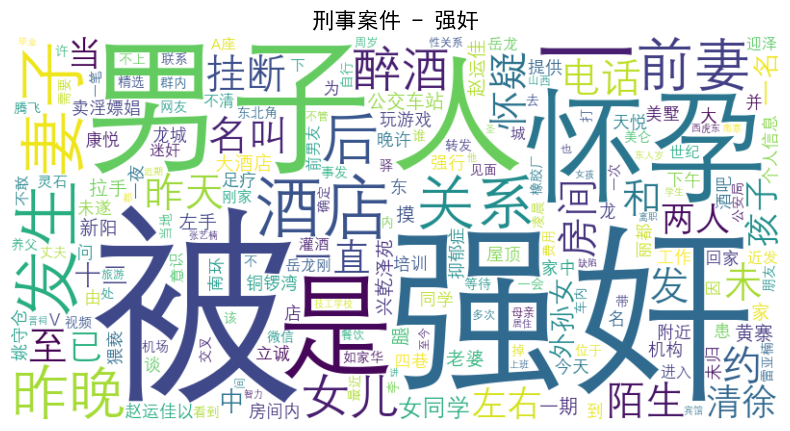

警情粗略类别: 刑事案件 - 警情细致类别: 抢劫
男子: 12
手机: 11
人: 11
被: 10
并: 9
抢走: 8
殴打: 7
后: 6
余元: 5
价值: 4
两名: 4
已: 3
离开: 3
抢劫: 3
陌生: 3
一部: 2
一: 2
给: 2
吃饭: 2
苹果: 2
华为: 2
摩托车: 2
内: 2
等: 2
金: 2
名: 2
让: 2
朋友: 2
到达: 2
手持: 2
一把: 2
微信: 2
要: 2
向: 2
未: 2
一辆: 2
不: 2
家中: 2
万元: 2
拦住: 2
醉酒: 1
该店: 1
工作人员: 1
丈夫: 1
OPPO: 1
自行: 1
调: 1
出场: 1
监控: 1
长风: 1
二期: 1
下许: 1
刷: 1
礼物: 1
约: 1
见面: 1
手中: 1
且: 1
南内环: 1
西南角: 1
十几: 1
钟: 1
之前: 1
骑着: 1
两人: 1
骑: 1
着: 1
向东: 1
阳光: 1
数码港: 1
商铺: 1
万科: 1
如如园期: 1
人家: 1
门: 1
撬: 1
丢失: 1
余金: 1
纪念币: 1
格林豪: 1
泰: 1
南: 1
卫生: 1
服务中心: 1
后面: 1
国丰: 1
便利店: 1
店内: 1
收银台: 1
控制: 1
住: 1
一名: 1
遇到: 1
帮忙: 1
跟随: 1
B: 1
民宿: 1
看到: 1
屋内: 1
多名: 1
邀请: 1
拒绝: 1
带上: 1
菜刀: 1
水果刀: 1
威胁: 1
交出: 1
告知: 1
锁屏: 1
支付: 1
密码: 1
转: 1
走: 1
红包: 1
内元该: 1
沟通: 1
回家: 1
该: 1
回元费: 1
承诺: 1
送给: 1
录音: 1
是: 1
自愿: 1
发生: 1
违法犯罪: 1
事情: 1
父亲: 1
刚: 1
太原: 1
希望: 1
警方: 1
介入: 1
处理: 1
玉河: 1
骏景此: 1
他人: 1
合租房: 1
间: 1
看清: 1
二: 1
正对面: 1
商店: 1
里: 1
一条: 1
香烟: 1
高速: 1
晋祠: 1
大桥: 1
南向: 1
北方: 1
汽车: 1
下来: 1
三人: 1
钢管: 1
拦车: 1
进行: 1
需要: 1
救护车: 1
拉上: 1
福特车: 1
包: 1
和: 1
内元: 1

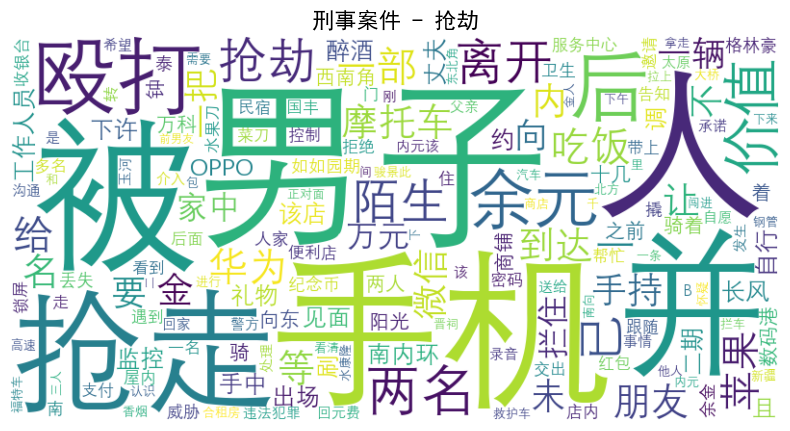

警情粗略类别: 刑事案件 - 警情细致类别: 抢夺
手机: 4
摩托车: 4
两名: 4
男子: 4
被: 3
抢走: 3
踏板: 3
金: 2
后: 2
不: 2
驾驶: 2
女子: 2
骑: 2
离开: 2
抢: 2
地铁: 2
及: 1
身上: 1
四五: 1
人: 1
殴打: 1
强行: 1
拿走: 1
原因: 1
清人: 1
场: 1
等: 1
千禧锦边: 1
行至: 1
一人: 1
从: 1
身边: 1
经过: 1
把: 1
价值: 1
元: 1
坞: 1
城: 1
世纪: 1
花园: 1
南门: 1
两人带: 1
黑: 1
棒球帽: 1
蓝罩: 1
一辆: 1
抢夺: 1
走: 1
看到: 1
东西: 1
沿往: 1
西: 1
没: 1
追上: 1
返回: 1
场后: 1
找: 1
不到: 1
南: 1
往南: 1
钟前: 1
黑色: 1
未遂: 1
骑车: 1
往南方: 1
向: 1
逃跑: 1
一: 1
陌生: 1
自是: 1
医: 1
肿瘤科: 1
医生: 1
趁: 1
注意: 1
袋里: 1




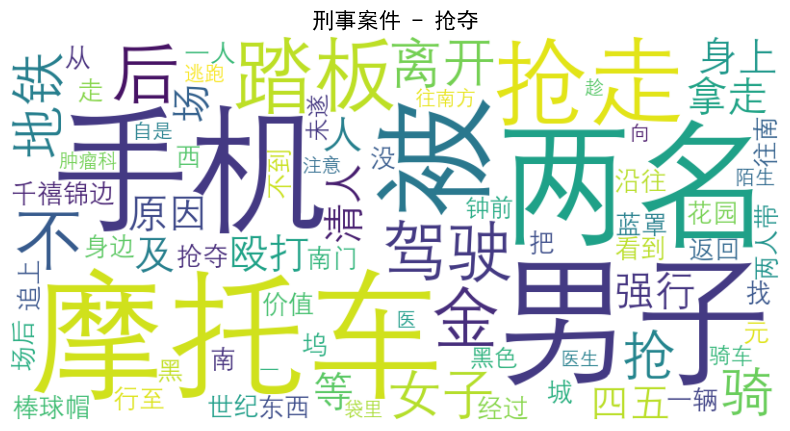

警情粗略类别: 刑事案件 - 警情细致类别: 敲诈勒索
被: 17
裸聊: 11
万元: 9
敲诈: 8
敲诈勒索: 6
转账: 5
元: 5
视频: 5
人: 5
并: 4
要求: 4
威胁: 3
拿走: 3
已: 3
网上: 3
QQ: 3
进行: 3
给: 3
核查: 2
涉嫌: 2
一名: 2
身份证: 2
家中: 2
让: 2
软件: 2
认识: 2
添加: 2
后: 2
发给: 2
孙岩: 2
按: 2
宿舍: 2
通过: 2
聊天: 2
对面: 2
我局: 1
网安: 1
大队: 1
局: 1
下发: 1
关于: 1
河北: 1
保定: 1
案: 1
预警: 1
假: 1
记者: 1
网络: 1
水军: 1
全国: 1
集群: 1
线索: 1
任务: 1
请示: 1
经: 1
初步: 1
发: 1
为: 1
郭迎: 1
男子: 1
选因: 1
男友: 1
陈殿林: 1
拒绝: 1
手今: 1
早: 1
殴打: 1
持刀: 1
随后: 1
银行卡: 1
元金: 1
离开: 1
场: 1
兴东: 1
漪: 1
流碧苑: 1
独山: 1
西晋: 1
泰: 1
会计师: 1
事务所: 1
推特: 1
一: 1
网友: 1
录不雅: 1
否则: 1
通讯录: 1
好友: 1
民: 1
健富: 1
因: 1
商家: 1
拒收: 1
快: 1
递给: 1
客派件: 1
晚: 1
了: 1
一天: 1
物件: 1
没: 1
任何: 1
损害: 1
收货人: 1
找麻烦: 1
并且: 1
赔付: 1
晋源: 1
管理中心: 1
转元: 1
份: 1
电康馨苑: 1
朋友: 1
若: 1
不: 1
做: 1
就: 1
去: 1
工作: 1
地方: 1
滋事: 1
贷款: 1
转给: 1
且: 1
也: 1
建机巷: 1
玉河: 1
家园: 1
A: 1
万: 1
小米: 1
国际: 1
同: 1
城: 1
交友: 1
万余元: 1
许: 1
地质队: 1
骗: 1
金: 1
李保英: 1
丈夫: 1
王泽明: 1
小: 1
东流: 1
丰庆苑: 1
昨找: 1
梁瑞华: 1
高山: 1
惠: 1
夫妻: 1
二人: 1
办理: 1
出租车: 1
过: 1
问题: 1
索要: 1
敲诈嫌疑: 1
锦江: 1
都城: 1
酒店: 1
他人: 1
左右: 1
太原: 1
南站:

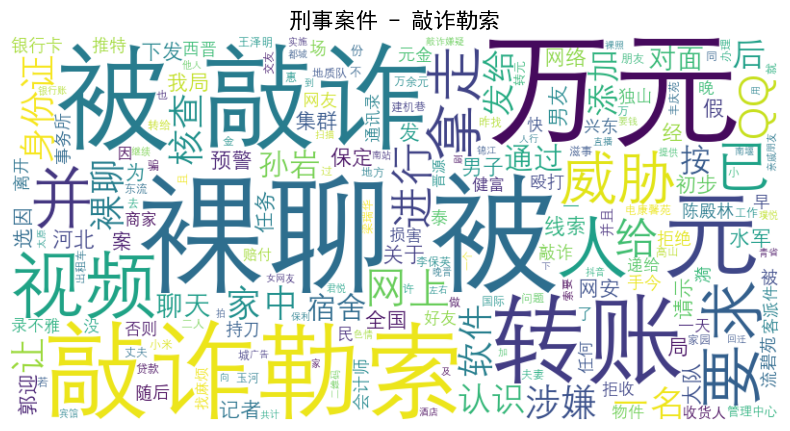

警情粗略类别: 刑事案件 - 警情细致类别: 盗窃
被盗: 16
价值: 13
手机: 8
余元: 7
内: 6
元: 6
一辆: 5
放袋: 4
无: 4
一部: 3
袋内: 3
发: 3
自行车: 3
停放: 3
贷款: 3
地下: 3
北: 2
被: 2
放: 2
华为: 2
人: 2
电动车: 2
监控: 2
车辆: 2
纠纷: 2
女朋友: 1
苹果: 1
沙天: 1
和: 1
房门: 1
锁子: 1
打不开: 1
门锁: 1
上: 1
砸: 1
痕迹: 1
恐家: 1
进入: 1
小偷: 1
余: 1
情况: 1
不清: 1
寇往: 1
北米: 1
西处: 1
VIVO: 1
衣服: 1
三元催化: 1
锦东: 1
商务酒店: 1
发放: 1
vivo: 1
上放: 1
一: 1
挂包: 1
包内: 1
金: 1
银行卡: 1
等: 1
物品: 1
山水: 1
嘉源: 1
昨天: 1
轩逸车: 1
自车: 1
抵押: 1
南内: 1
领合荣: 1
发店: 1
内放店: 1
电话: 1
山投: 1
城上城: 1
电动: 1
丽中: 1
海天: 1
钻: 1
建工: 1
地: 1
未: 1
锁门: 1
因: 1
闲置: 1
万元: 1
长: 1
余米: 1
粗: 1
电缆: 1
使用: 1
个: 1
绿源: 1
万达: 1
车库: 1
昨晚: 1
许: 1
蓝色: 1
威马牌: 1
轿车: 1
此: 1
早晨: 1
查看: 1
中午: 1
人车: 1
开走: 1
不: 1
认识: 1
三巷: 1
恒通: 1
烤肉店: 1
后: 1
:: 1
人停: 1
东风: 1
货车: 1
拖车: 1
拖走: 1
人自: 1
中边: 1
场: 1
小前: 1
长百: 1
果园: 1
华润: 1
悦府: 1
店: 1
附近: 1
另: 1
留电话: 1




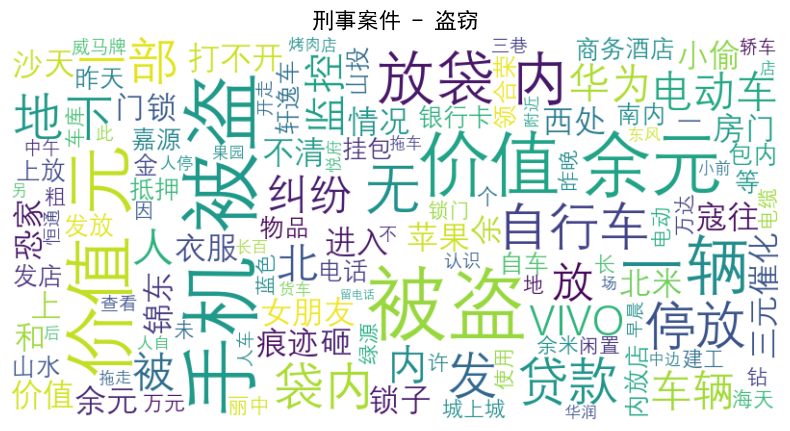

警情粗略类别: 刑事案件 - 警情细致类别: 纵火
徘徊: 1
钟: 1
着火: 1
人: 1
怀疑: 1
该: 1
男子: 1
纵火: 1
人民: 1
边: 1
四米: 1
二: 1
自卸车: 1
被: 1
烧毁: 1
已: 1
到场: 1
火: 1
扑灭: 1




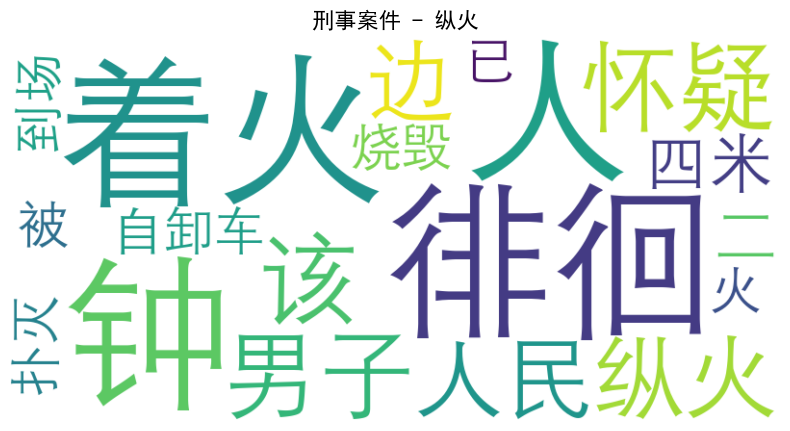

警情粗略类别: 刑事案件 - 警情细致类别: 绑架
儿子: 4
绑架: 3
被: 2
人: 2
初中: 1
同学: 1
使用: 1
码给: 1
来电: 1
自: 1
山西: 1
大医: 1
附近: 1
让: 1
帮助: 1
不然: 1
就要: 1
没命: 1
了: 1
太原: 1
一小: 1
前: 1
接到: 1
侯肖刚: 1
打来: 1
电话: 1
接: 1
摊位: 1
人因: 1
经济纠纷: 1
不知: 1
所: 1
何处: 1
向: 1
要钱: 1




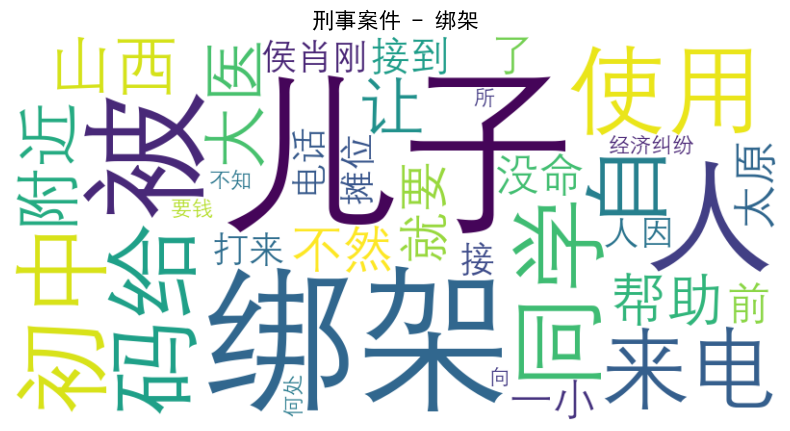

警情粗略类别: 刑事案件 - 警情细致类别: 诈骗
被: 15
骗: 12
元: 6
通过: 6
购买: 6
下载: 5
转账: 5
操作: 5
万元: 5
APP: 4
提示: 4
让: 3
内: 3
微信: 3
和: 3
链接: 3
万余元: 3
上: 3
合同: 3
根据: 3
联系: 3
充值: 2
受骗: 2
网上: 2
卖: 2
按: 2
转元发: 2
贷款: 2
要求: 2
人: 2
给: 2
认识: 2
群中: 2
刷单: 2
银行卡: 2
平台: 2
要: 2
还款: 2
且: 2
一期: 2
云: 2
百万: 2
保障: 2
电话: 2
公司: 2
摩托车: 2
并: 2
不: 2
工商银行: 2
短信: 2
太原: 1
科技: 1
大学: 1
色情: 1
会员: 1
约: 1
出来: 1
还: 1
双金闲: 1
鱼: 1
结婚: 1
用品: 1
需要: 1
缴纳: 1
保证金: 1
手机: 1
银行: 1
白求恩: 1
医: 1
外科: 1
找: 1
个人: 1
先付: 1
利息: 1
押金: 1
许闲鱼: 1
手串: 1
冒充: 1
买家: 1
发来: 1
一条: 1
网络: 1
带: 1
炒股: 1
许金桥: 1
双语学校: 1
朋友: 1
拉: 1
进: 1
一个: 1
聚星: 1
北格晶: 1
科工: 1
工地: 1
借条: 1
申请: 1
输入: 1
审核: 1
一位数: 1
出错: 1
导致: 1
借款: 1
未: 1
入账: 1
但: 1
显示: 1
乙方: 1
不能取消: 1
否则: 1
赔付: 1
%: 1
违约金: 1
发: 1
当代: 1
MOMA: 1
中: 1
文化: 1
义井: 1
家园: 1
下午: 1
接到: 1
关闭: 1
骗元金: 1
富力: 1
城合: 1
谷: 1
网页: 1
看到: 1
一家: 1
以: 1
代替: 1
债权: 1
沟通: 1
问题: 1
为: 1
由: 1
诈骗: 1
只: 1
双方: 1
一起: 1
具体情况: 1
说不清: 1
红星: 1
紫御: 1
半山: 1
昨抖音: 1
推送: 1
添加: 1
销售: 1
黄越康: 1
随后: 1
签订: 1
工厂: 1
告知: 1
无法: 1
发货: 1
更高: 1
价值: 1
车辆: 1
重: 1
签合同: 1
退押: 1
金发: 1
亲

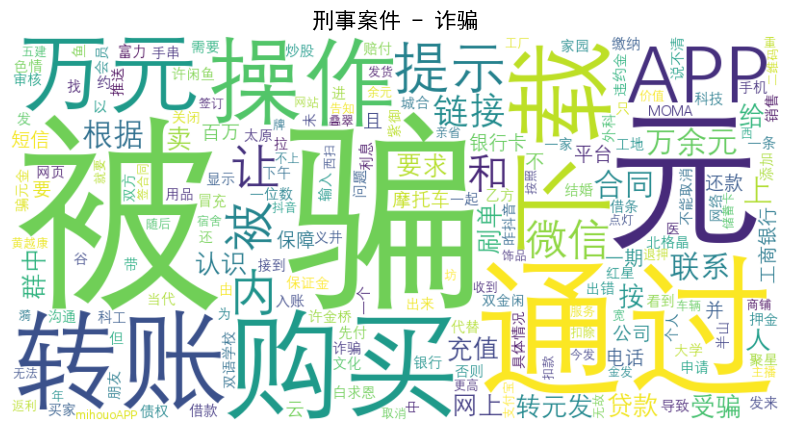

警情粗略类别: 刑事案件 - 警情细致类别: 贩毒
购买: 3
三唑仑: 3
嫌疑人: 3
工作: 2
男子: 2
药品: 2
快递: 2
曹焕章: 2
毒品: 2
线索: 2
犯罪: 2
南希: 2
交城: 2
公安局: 2
清徐: 2
我局: 1
联合: 1
海关: 1
缉私局: 1
经: 1
侦查: 1
发一: 1
从: 1
境外: 1
邮寄: 1
精麻: 1
经对: 1
信息: 1
核实: 1
发该: 1
名叫: 1
抓获: 1
到案: 1
后: 1
共同: 1
前往: 1
龙堡: 1
绿洲: 1
菜鸟: 1
驿站: 1
本人: 1
取出: 1
当面: 1
清点: 1
共: 1
一板: 1
共粒: 1
我: 1
队: 1
中: 1
根据: 1
掌握: 1
于: 1
尖恒大: 1
附近: 1
传唤: 1
至: 1
公安: 1
尖: 1
草坪: 1
局: 1
执法: 1
办案: 1
中心: 1
接受: 1
讯问: 1
经查明: 1
通过: 1
互联网: 1
非法: 1
贩卖: 1
精: 1
麻类: 1
移交: 1
禁毒: 1
大队: 1
贩毒: 1
吸毒: 1
人员: 1
任志功: 1
武宇: 1
江于: 1
向: 1
李建生: 1
冰毒: 1




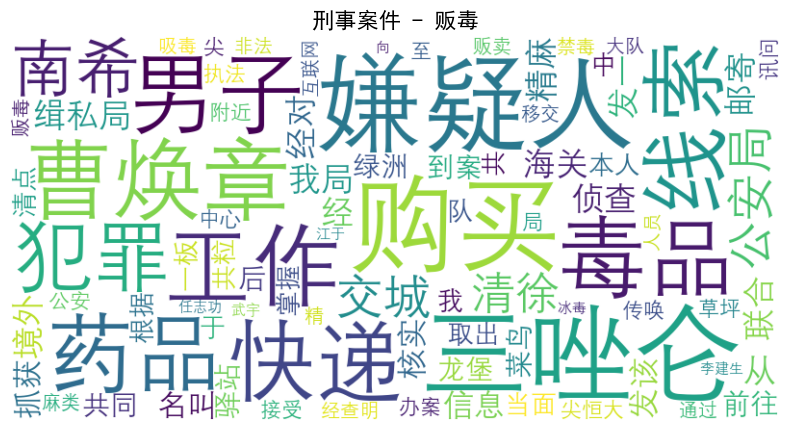

警情粗略类别: 刑事案件 - 警情细致类别: 非法拘禁
被: 2
太原: 2
学姐: 2
了: 2
元: 2
一次: 2
银海: 1
歌城: 1
房间: 1
凌晨: 1
抖音: 1
平台: 1
约: 1
到: 1
消费: 1
当: 1
钱: 1
没付: 1
够: 1
欠: 1
及: 1
丈夫: 1
和: 1
五台: 1
老: 1
殴打: 1
还: 1
拘禁: 1
房间内: 1
后: 1
给: 1
磕头: 1
认错: 1
才: 1
让: 1
出来: 1
声: 1
也: 1
没用: 1
自己: 1
关系: 1
如: 1
就: 1
见: 1
打: 1
所以: 1
迟迟: 1
未: 1




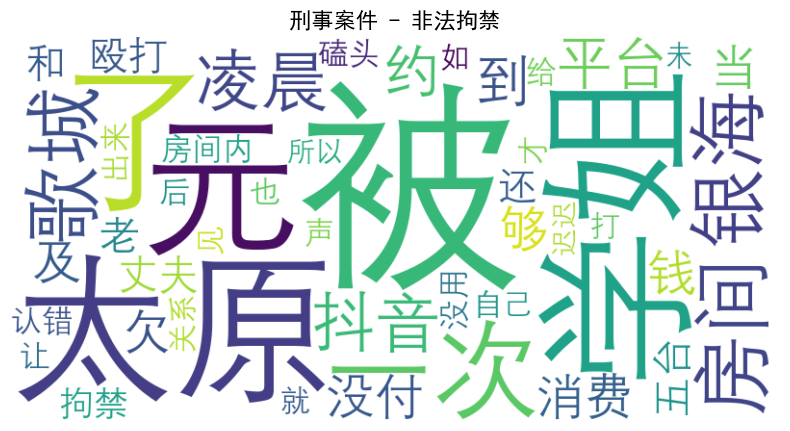

警情粗略类别: 投诉监督 - 警情细致类别: 其他投诉监督
无: 2
接待: 2
是: 1
山东人: 1
自: 1
香港: 1
陌生人: 1
换钱: 1
涉案: 1
资金: 1
转到: 1
卡: 1
上万: 1
柏林: 1
反诈: 1
中心: 1
大厅: 1
态度恶劣: 1
已: 1
年: 1
花费: 1
元: 1
购买: 1
自行车: 1
被盗: 1
后: 1
小店: 1
所: 1
认为: 1
案件: 1
处理: 1
进展: 1
请: 1
核实: 1
情况: 1
依法: 1
妥善: 1
答复: 1
人: 1
并: 1
反馈: 1




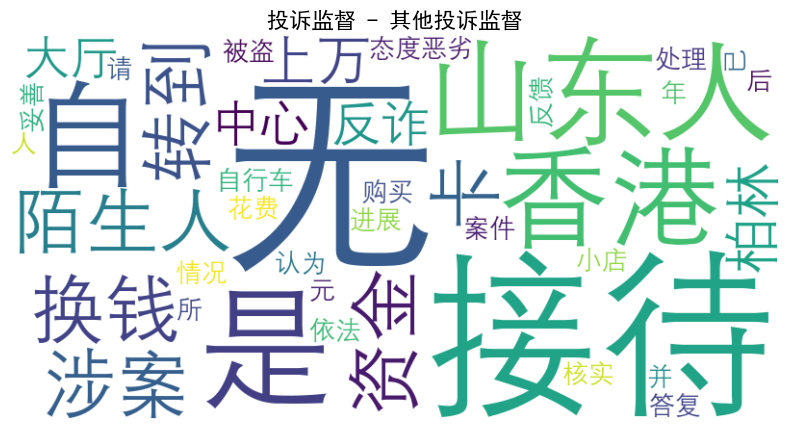

警情粗略类别: 投诉监督 - 警情细致类别: 群众投诉
处理: 4
小店: 3
派出所: 3
殴打: 3
被: 3
所: 2
处理结果: 2
不: 2
要求: 2
找: 2
王喆: 2
关系: 2
后: 2
调解: 2
一直: 2
出租车: 2
内: 2
乘客: 2
给: 2
但是: 2
未: 2
第三天: 2
昨天: 1
接到: 1
电话: 1
自: 1
因: 1
上访: 1
问题: 1
威胁: 1
梁先生: 1
来电: 1
下午: 1
使用: 1
纠纷: 1
对: 1
敦化: 1
坊: 1
出警: 1
满意: 1
督察: 1
部门: 1
反映: 1
古城: 1
张帆: 1
人: 1
利益: 1
去: 1
年份: 1
受伤: 1
自是: 1
先去: 1
医医: 1
诊断: 1
证明: 1
事后: 1
帮助: 1
两次: 1
拒绝: 1
拖: 1
到场: 1
没: 1
凌晨: 1
点: 1
中: 1
对面: 1
醉酒: 1
还: 1
车费: 1
监控: 1
视频: 1
提供: 1
警方: 1
王小芳: 1
当后: 1
带回: 1
登记: 1
信息: 1
多次: 1
联系: 1
理由: 1
是: 1
不到: 1
人人: 1
跟: 1
换: 1
负责: 1
请: 1
给予: 1
妥善: 1
答复: 1




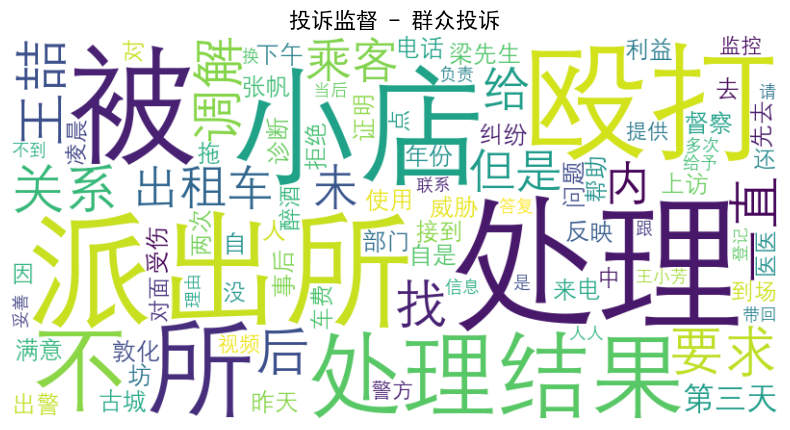

警情粗略类别: 治安警情 - 警情细致类别: 伪造票证、凭证
公司: 7
限: 4
清徐: 2
山东: 2
大华: 2
建筑: 2
劳务: 2
太原: 2
我: 1
所接: 1
人民: 1
法: 1
移交: 1
线索: 1
黄春林: 1
因: 1
给: 1
员工: 1
投保: 1
中国: 1
平安: 1
财产保险: 1
股份: 1
意外险: 1
需要: 1
经: 1
法定代表: 1
人田玉玉喜: 1
同意: 1
东于: 1
私刻: 1
了: 1
工作: 1
真: 1
康宁: 1
大厦: 1
B座: 1
云鸣: 1
认证: 1
该: 1
办: 1
假证: 1
人: 1
不: 1
东悦: 1
广场: 1
安厦: 1
建设工程: 1
和: 1
哥哥: 1
鹏: 1
双禄: 1
伪造: 1
公章: 1
进行: 1
担保: 1
贷款: 1
联系: 1
不上: 1




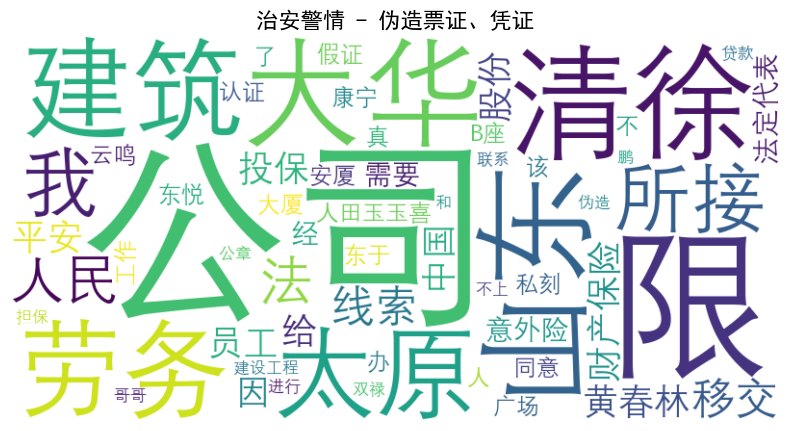

警情粗略类别: 治安警情 - 警情细致类别: 侵犯人身权利
被: 9
身份证: 7
扣留: 3
不: 3
长: 2
锦麟: 2
东方: 2
旁边: 2
宾馆: 2
着: 2
给: 2
限制: 2
人身自由: 2
因: 2
纠纷: 2
信息: 2
公司: 2
老板: 2
工作: 2
对: 2
北格张: 1
保安队: 1
太原: 1
站: 1
对面: 1
聚源: 1
快捷: 1
被扣: 1
富力: 1
天禧: 1
城: 1
B: 1
北门: 1
前天: 1
下午: 1
点多: 1
放高利贷: 1
人员: 1
今: 1
凌晨: 1
两点: 1
通过: 1
朋友: 1
钱: 1
还: 1
上: 1
后: 1
才: 1
放走: 1
滨河: 1
家园: 1
离婚: 1
问题: 1
丈夫: 1
黄: 1
洋洋: 1
发: 1
家中: 1
安装: 1
了: 1
窃听器: 1
且: 1
频繁: 1
微信: 1
抖音: 1
平台: 1
发布: 1
诽谤性: 1
代: 1
自由: 1
广场: 1
B座: 1
发年: 1
冒用: 1
注册: 1
人: 1
无锡: 1
南: 1
一米阳光: 1
住宿: 1
发生: 1
自: 1
应聘: 1
工资: 1
万: 1
柏林: 1
天际: 1
国际: 1
赛车场: 1
找: 1
酒店: 1
工作人员: 1
扣: 1
狄: 1
碧桂园: 1
玖: 1
玺: 1
台: 1
个人身份: 1
前: 1
同事: 1
盗用: 1
开: 1
担心: 1
个人: 1
权利: 1
造成: 1
影响: 1
神堂: 1
沟: 1
勤务: 1
大队: 1
因找: 1
孩子: 1
扣押: 1
归还: 1
我: 1
所接: 1
网安: 1
线索: 1
反映: 1
许中: 1
元宵节: 1
文艺演出: 1
中: 1
演出: 1
场: 1
一: 1
男子: 1
女演员: 1
肢体: 1
接触: 1




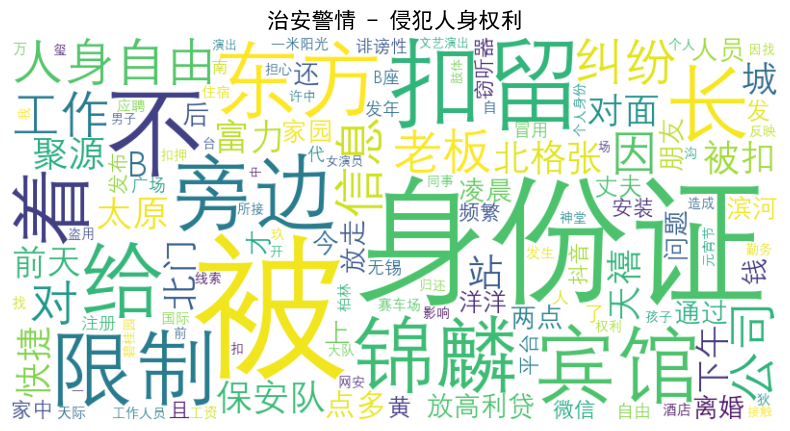

警情粗略类别: 治安警情 - 警情细致类别: 其它治安警情
被: 6
一名: 6
男子: 6
我: 4
发: 3
所: 3
嫌疑人: 3
至: 3
调查: 3
涉嫌: 3
大: 2
个人: 2
持刀: 2
详细情况: 2
拒讲: 2
需要: 2
中环: 2
因: 2
问题: 2
拒: 2
不让: 2
离开: 2
传唤: 2
接受: 2
控制: 2
人: 2
女儿: 2
具体情况: 2
不清: 2
人员: 2
到场: 2
根据: 2
线索: 2
内: 2
吸毒: 2
尖: 2
草坪: 2
殴打: 2
一直: 2
违法: 2
求助: 2
东人: 1
网: 1
红牛: 1
直播间: 1
谩骂: 1
并: 1
显示: 1
照片: 1
对: 1
进行: 1
人身攻击: 1
小店: 1
和谐: 1
公园: 1
和方: 1
商店: 1
只人: 1
准备: 1
砍: 1
不: 1
东: 1
宜佳上: 1
东城: 1
刚: 1
回家: 1
门锁: 1
上: 1
塞上: 1
小: 1
木棍: 1
不知: 1
何人: 1
为: 1
交通事故: 1
赔偿: 1
含服: 1
丁丙诺啡: 1
牛立军: 1
公安: 1
经过: 1
猥褒: 1
同至: 1
西南角: 1
岁: 1
进入: 1
酒吧: 1
发且: 1
一: 1
成年: 1
发生: 1
关系: 1
均: 1
全景: 1
晋阳湖: 1
附近: 1
梵舍: 1
酒店: 1
房间内: 1
入住: 1
偷拍: 1
并发: 1
网上: 1
队: 1
万: 1
长风: 1
观苑: 1
二期: 1
抓获: 1
经查: 1
该: 1
名叫: 1
李达: 1
随即: 1
依法: 1
公安局: 1
局: 1
执法: 1
办案: 1
中心: 1
方糖: 1
KTV: 1
他人: 1
电话: 1
中: 1
争吵: 1
多岁: 1
段: 1
来回: 1
骑: 1
自行车: 1
看到: 1
女性: 1
就: 1
露出: 1
生殖器: 1
拉客: 1
旁边: 1
老板: 1
持: 1
酒瓶: 1
受伤: 1
躺: 1
地上: 1
双方: 1
已开: 1
等: 1
所局: 1
指定: 1
管辖: 1
我局: 1
治安管理: 1
大队: 1
办理: 1
兴: 1
无名: 1
按摩房: 1
卖淫嫖娼: 1
案中: 1
提供线索: 1
卖淫: 1
王晓荣: 1
和: 1


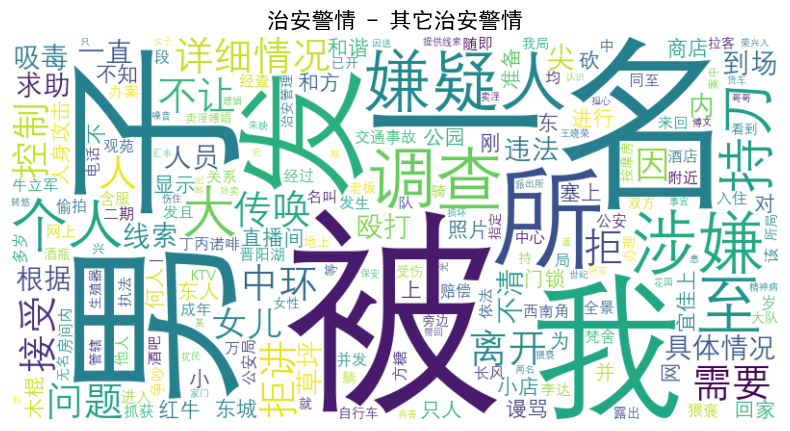

警情粗略类别: 治安警情 - 警情细致类别: 制贩、使用假币
假币: 5
一张: 4
店: 2
元: 2
一名: 2
顾客: 2
新: 1
丽水: 1
苑百: 1
果园: 1
收款: 1
后发: 1
面值: 1
黑土: 1
巷卖: 1
废品: 1
回收: 1
人员: 1
给: 1
金元: 1
到: 1
银行: 1
存钱: 1
发: 1
是: 1
联系: 1
不: 1
承认: 1
华德: 1
广场: 1
金虎: 1
便利店: 1
换: 1
金发: 1
商家: 1
发生: 1
纠纷: 1
中信银行: 1
支行: 1
女性: 1
存款: 1
万金: 1
中万: 1
郑天鑫: 1
家园: 1
底商: 1
青青: 1
造型: 1
开晋: 1
AD: 1
白色: 1
面包车: 1
理完: 1
发给: 1




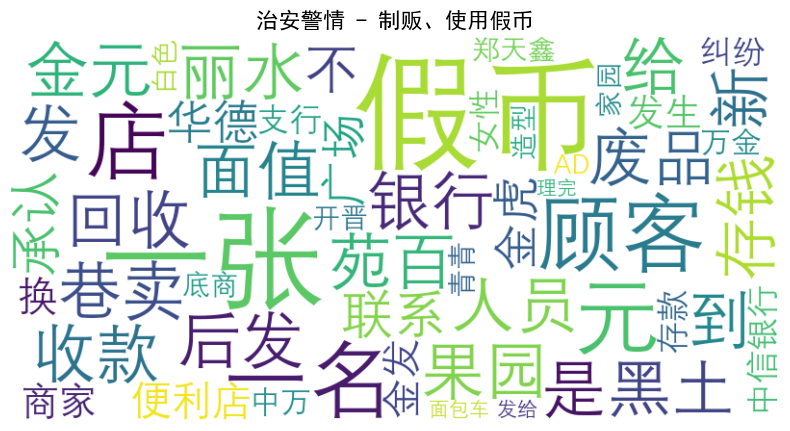

警情粗略类别: 治安警情 - 警情细致类别: 妨碍公务
执法: 15
受阻: 9
交警: 8
场: 6
小: 5
人: 3
阻碍: 3
辱骂: 3
一名: 2
办理: 2
中: 2
西: 2
东南角: 2
一: 2
男子: 2
反映: 1
政府: 1
对面: 1
双: 1
东北角: 1
期间: 1
女子: 1
西南角: 1
此: 1
康: 1
干部: 1
发悬: 1
委会: 1
内: 1
两张: 1
版面: 1
丢失: 1
造成: 1
邢家社: 1
纪委: 1
常: 1
工作: 1
无法: 1
序: 1
开展: 1
经晋源局: 1
领导批示: 1
晋源: 1
局义井: 1
刑警队: 1
任立灿: 1
袭警案: 1
件: 1
移交: 1
至: 1
罗城: 1
派出所: 1
古城: 1
营新: 1
车主: 1
新: 1
唐人: 1
电话: 1
千新理: 1
违停: 1
过程: 1
韩勇: 1
绍九巷: 1
妨碍: 1
滨: 1
桥下: 1
往南米: 1
汾河: 1
停车场: 1
孙骑: 1
电动机: 1
自行车: 1
违章: 1
处理: 1
该: 1
往: 1
身上: 1
吐水: 1
扣车: 1
南站: 1
广场: 1
被: 1
司机: 1
黄河: 1
大道: 1
迎泽: 1
大队: 1
来电: 1
坞: 1
此查: 1
酒: 1
驾车: 1
主不: 1
配合: 1




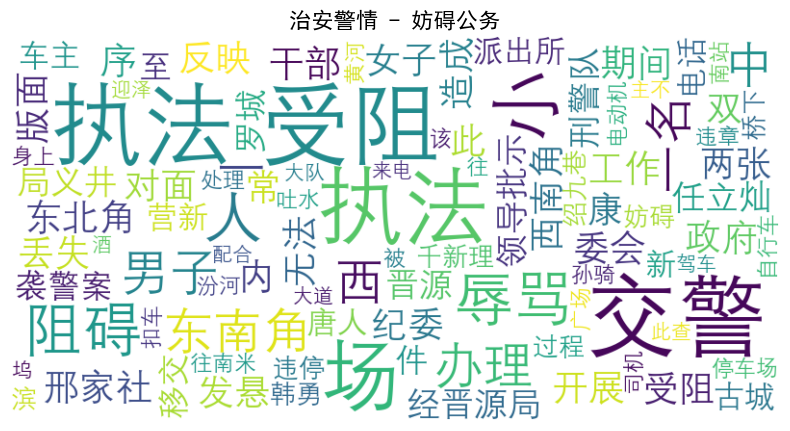

警情粗略类别: 治安警情 - 警情细致类别: 家庭暴力
被: 16
丈夫: 11
殴打: 9
家暴: 5
需要: 3
花园: 3
人: 2
爱人: 2
一直: 2
不: 2
头部: 2
受伤: 2
康宁: 1
雅苑: 1
掐: 1
脖子: 1
原因: 1
不明: 1
哭泣: 1
旧: 1
一: 1
湖滨: 1
晋庭: 1
恒大未: 1
鸿峰: 1
西: 1
恒大: 1
滨河: 1
府: 1
女儿: 1
推打: 1
到场: 1
劝导: 1
滨汇: 1
锦: 1
华宇: 1
绿洲: 1
儿媳妇: 1
并西: 1
一巷: 1
上: 1
A座: 1
七平: 1
中恒: 1
公园: 1
华府: 1
售部: 1
北人: 1
前: 1
北屯: 1
文兴苑: 1
怀孕: 1
个: 1
西山: 1
门牌: 1
讲不清: 1
太原: 1
小: 1
一期: 1
天新: 1
西岸: 1
酒店: 1




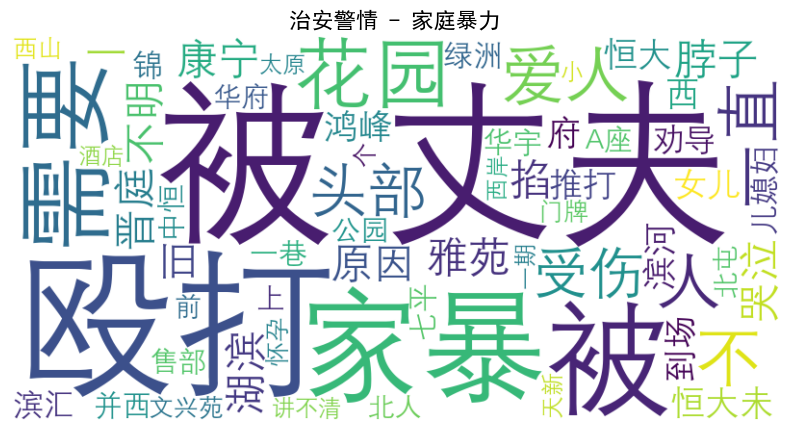

警情粗略类别: 治安警情 - 警情细致类别: 恐吓
恐吓: 11
威胁: 10
被: 5
要: 4
打电话: 4
给: 4
打: 4
人: 3
微信: 3
纠纷: 3
接到: 3
来: 3
电话: 3
通过: 3
因: 2
维权: 2
花园: 2
发: 2
找: 2
到: 2
家中: 2
之前: 2
人员: 2
信息: 2
附近: 2
他: 2
小: 1
五巷: 1
欠款: 1
问题: 1
汾: 1
招商: 1
代因: 1
业主: 1
们: 1
讨论: 1
去: 1
没用: 1
他人: 1
添加: 1
一直: 1
千: 1
大唐: 1
世纪: 1
南门: 1
家庭: 1
妹夫: 1
哥哥: 1
张伟: 1
大井峪美地: 1
新: 1
领域: 1
装修: 1
工人: 1
语音: 1
裕峰: 1
网上: 1
灭蟑螂: 1
公司: 1
金: 1
地: 1
格林: 1
昨: 1
:: 1
她: 1
且: 1
明是: 1
朋友: 1
郝旸: 1
旸: 1
指示: 1
西北角: 1
频繁: 1
收到: 1
认识: 1
发来: 1
城: 1
宿舍: 1
男友: 1
大: 1
东关: 1
消防队: 1
推销: 1
课程: 1
拒绝: 1
后: 1
辱骂: 1
还: 1
用: 1
孩子: 1
全: 1
德菲: 1
菲: 1
美甲: 1
美睫: 1
店员: 1
兼: 1
学员: 1
赵芳芳: 1
因退: 1
学费: 1
扬言: 1
不: 1
退费: 1
就要: 1
砸: 1
店: 1
逸景: 1
公寓: 1
A座: 1
昨天: 1
催收: 1
五龙: 1
场排: 1
闫记: 1
熟肉: 1
今: 1
店铺: 1
抢: 1
了: 1
客服: 1
弄死: 1
并: 1
跟踪: 1
家人: 1
为: 1
男性: 1
马: 1
张斌: 1
表哥: 1
殴打: 1
娄烦: 1
上红人: 1
孵化: 1
基地: 1
抖音: 1
及: 1
大因: 1
车费: 1
醉酒: 1
乘客: 1
发微信: 1
小马: 1
小学: 1
前男友: 1
王永红: 1
发短信: 1




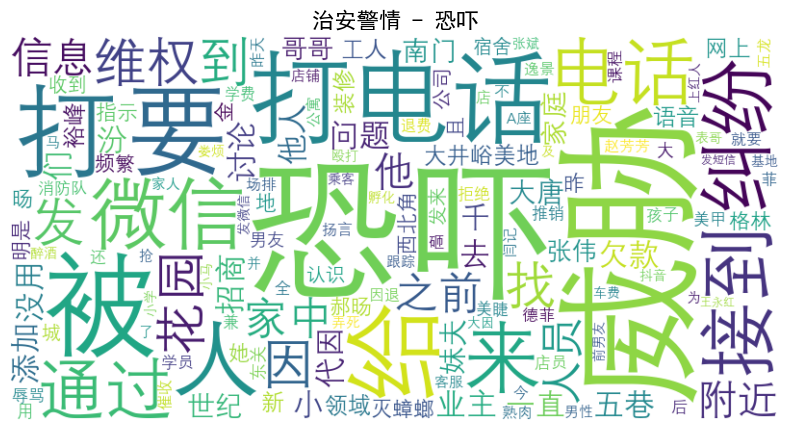

警情粗略类别: 治安警情 - 警情细致类别: 打架斗殴
被: 16
殴打: 13
需要: 9
不: 8
他人: 5
男子: 4
双方: 4
醉酒: 3
均场: 3
发生: 3
打架: 3
具体情况: 3
不详: 3
原因: 3
两名: 3
一名: 2
到场: 2
名: 2
恒大御: 2
无故: 2
受伤: 2
救护车: 2
中: 2
人: 2
电话: 2
只: 2
同学: 2
打: 2
人员: 2
未: 2
南: 2
朋友: 2
事宜: 2
躺: 1
着: 1
医护人员: 1
该: 1
景湾: 1
车库: 1
但: 1
已开: 1
等: 1
景湾期: 1
地库: 1
北出: 1
我台: 1
询问: 1
过程: 1
挂断: 1
滨: 1
供销社: 1
宿舍: 1
哭泣: 1
迎: 1
山西: 1
金融: 1
职业: 1
学内: 1
帮助: 1
钟前: 1
司法: 1
学校: 1
男生宿舍: 1
已: 1
离开: 1
它: 1
情况: 1
说不清: 1
十里铺: 1
加油站: 1
自不: 1
具体: 1
拒讲: 1
太钢: 1
东门: 1
旁边: 1
铁道: 1
处: 1
讲: 1
中环: 1
清控: 1
东侧: 1
出: 1
小: 1
四川: 1
饭店: 1
持: 1
酒瓶: 1
通知: 1
台: 1
小井: 1
峪华: 1
一直: 1
争吵: 1
小店: 1
因打麻: 1
产生: 1
角: 1
掌: 1
掴: 1
下: 1
滨湘邀: 1
粤菜: 1
新: 1
湘菜: 1
内: 1
同事: 1
旧省: 1
警校: 1
家属: 1
看到: 1
十余名: 1
持械: 1
不明: 1
西岸: 1
内因: 1
哥哥: 1
去世: 1
因: 1
处理: 1
后事: 1
家人: 1
纠纷: 1




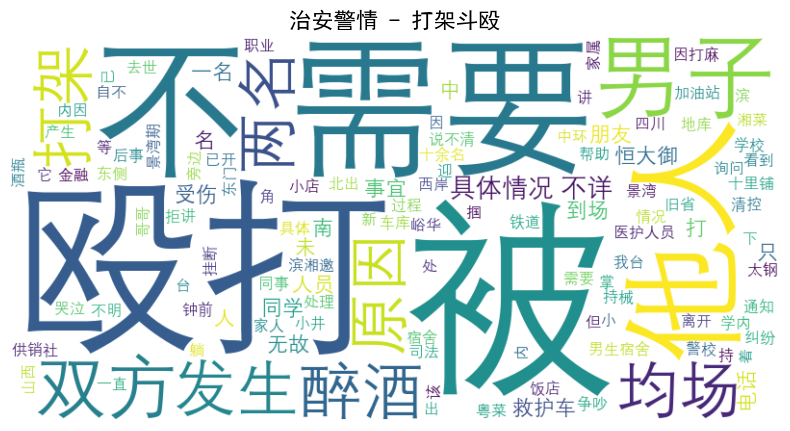

警情粗略类别: 治安警情 - 警情细致类别: 扰乱秩序
滋事: 16
一名: 5
醉酒: 5
一: 4
男子: 4
顾客: 3
纠纷: 3
朋友: 3
因上: 2
因: 2
对面: 2
原因: 2
办公: 2
店: 2
云水: 1
世纪: 1
明珠: 1
下: 1
李: 1
十八: 1
旺旺: 1
老: 1
火锅: 1
卫生间: 1
事宜: 1
女: 1
广场: 1
东子: 1
烧烤店: 1
旁: 1
小龙虾: 1
店人: 1
拿: 1
烟头烫: 1
客人: 1
怡和: 1
巷: 1
川菜馆: 1
另: 1
商家: 1
持: 1
酒瓶: 1
玉门: 1
花园: 1
E: 1
千峰: 1
派出所: 1
骑: 1
电动车: 1
撞: 1
到: 1
车上: 1
该车: 1
主: 1
盛德: 1
两名: 1
宜家: 1
尚: 1
东城: 1
感情: 1
前男友: 1
门外: 1
省: 1
警校: 1
东因: 1
哥哥: 1
前天: 1
和: 1
喝酒: 1
后该: 1
酒后: 1
身体: 1
不适: 1
去世: 1
名该: 1
家属: 1
上门: 1
具体情况: 1
暂: 1
不: 1
清楚: 1
旧: 1
省内: 1
人: 1
小学: 1
南侧: 1
交叉: 1
不明: 1
南黑: 1
窑庙: 1
我: 1
支队: 1
工作: 1
中: 1
发: 1
土库曼斯坦: 1
OV: 1
BERDI: 1
持新: 1
护照: 1
入境: 1
后: 1
未: 1
按规定: 1
内: 1
办理: 1
居留: 1
事项: 1
变更: 1
登记: 1
华一: 1
女子: 1
此: 1
具体: 1
不清: 1
卫健委: 1
七十多岁: 1
老大爷: 1
因要: 1
见: 1
五十年: 1
前: 1
被: 1
弃养: 1
孩子: 1
问题: 1
保利: 1
百合: 1
邻居: 1
敲门: 1
西: 1
中环: 1
太: 1
冀西: 1
五巷: 1
智通: 1
汽服: 1
一个: 1
股东: 1
堵门: 1
富力: 1
城启栖谷: 1
中人: 1
迎泽: 1
全友: 1
家具店: 1
内一: 1
影响: 1
正常: 1
营业: 1




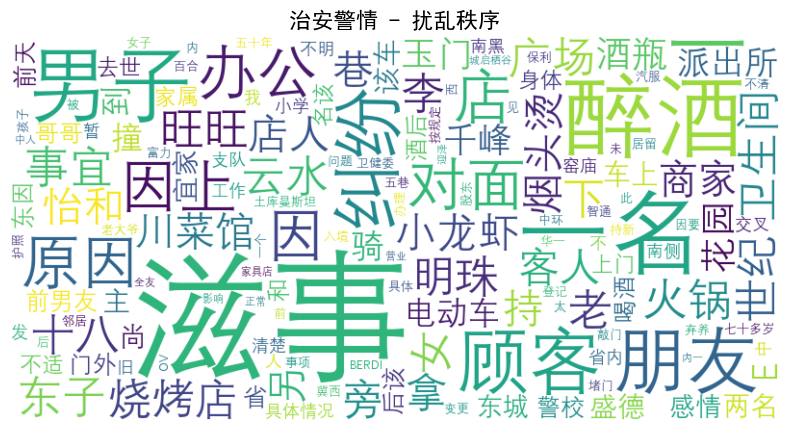

警情粗略类别: 治安警情 - 警情细致类别: 抢夺
手机: 4
男子: 4
被盗: 3
价值: 3
元: 3
被: 3
一: 3
丢失: 2
余元: 2
抢: 2
一名: 2
抢走: 2
未: 2
一辆: 1
自行车: 1
半个: 1
以前: 1
挖机: 1
停放: 1
泥: 1
屯发: 1
挖: 1
机上: 1
柴油: 1
和: 1
电瓶: 1
是: 1
理发店: 1
员工: 1
宿舍: 1
今天: 1
店内来: 1
了: 1
一位: 1
新: 1
同事: 1
放: 1
床头: 1
苹果: 1
袋: 1
水泥: 1
迎泽: 1
下: 1
公交站: 1
旁边: 1
控制: 1
住: 1
具体情况: 1
讲不清: 1
名叫: 1
刘洪波: 1
无故: 1
电脑: 1
人: 1
他: 1
情况: 1
讲完: 1
挂断: 1
东西: 1
体育场: 1
盛元: 1
羊汤: 1
醉酒: 1
抢夺: 1
许花间: 1
密码: 1
花店: 1
上午: 1
点: 1
岁: 1
左右: 1
中年男子: 1
付钱: 1
便: 1
花: 1
拿走: 1
驾驶: 1
灰色: 1
轿车: 1




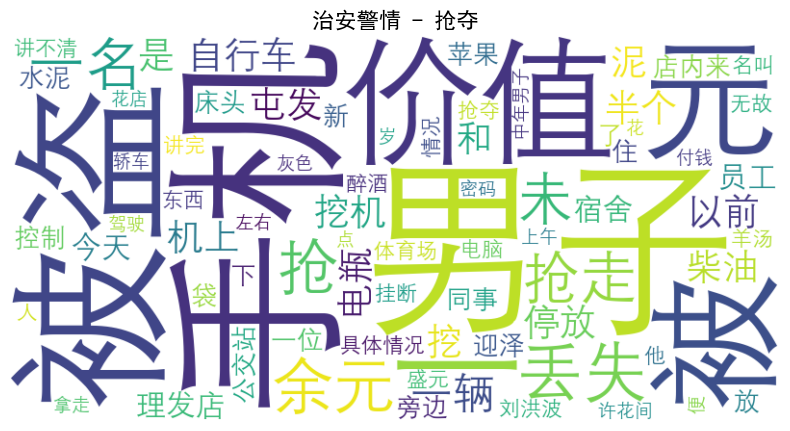

警情粗略类别: 治安警情 - 警情细致类别: 故意毁坏公私财物
被: 11
人: 6
停放: 4
故意: 4
砸: 4
停车场: 3
一辆: 2
车身: 2
划损: 2
怀疑: 2
所: 2
为: 2
轮胎: 2
车牌: 2
损坏: 2
挡风玻璃: 2
监控: 2
家中: 2
发: 2
需要: 2
帮助: 2
车胎: 2
龙内: 1
晋: 1
ADD: 1
特斯拉: 1
扯: 1
前机: 1
盖: 1
右侧: 1
富力: 1
城: 1
二期: 1
云栖谷: 1
菜油: 1
泼家: 1
房门: 1
上: 1
邻居: 1
实地: 1
紫腾: 1
电动车: 1
保安: 1
扎损: 1
万水澜庭: 1
南门: 1
学弗兰车: 1
后: 1
客人: 1
奔驰车: 1
前: 1
裂: 1
附近: 1
停: 1
天朗: 1
缤智前: 1
外地: 1
回到: 1
东西: 1
是: 1
丈夫: 1
到场: 1
核实: 1
新: 1
中医药大学: 1
附属: 1
医: 1
因车: 1
堵车: 1
主给: 1
放气: 1
踹: 1
损: 1
后视镜: 1
凯美瑞: 1
车: 1
被划: 1
泥屯: 1
泥: 1
屯: 1
山石: 1
段车: 1
砸坏: 1
发前: 1
折断: 1
保利: 1
香槟: 1
奔驰: 1
他人: 1
恶意: 1
拿: 1
刀: 1
扎破: 1
金内: 1
发车: 1
天窗: 1
未发: 1
被盗: 1
物品: 1
场: 1
小马: 1
花园: 1
西: 1
反映: 1
自行车: 1
倒: 1
闸: 1




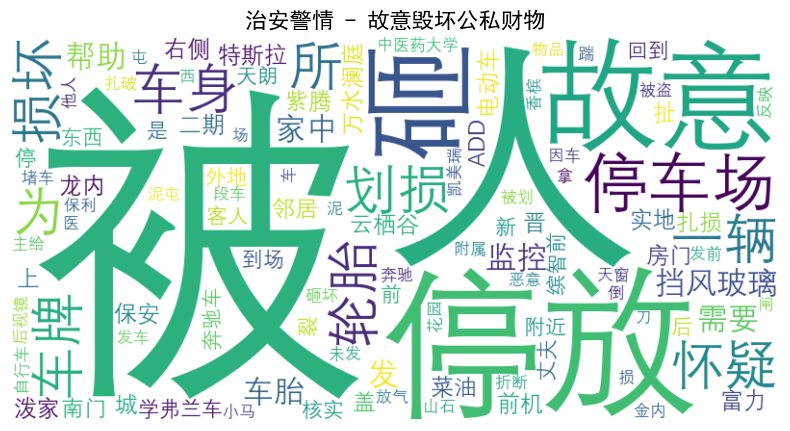

警情粗略类别: 治安警情 - 警情细致类别: 敲诈勒索
被: 12
裸聊: 9
敲诈: 9
元: 5
索要: 5
未: 4
后: 4
视频: 4
QQ: 4
收到: 3
网上: 3
通过: 3
短信: 3
手机: 3
让: 3
链接: 3
向: 3
转账: 3
好友: 3
游戏: 3
他人: 2
P: 2
骗: 2
酒店: 2
网友: 2
人: 2
点击: 2
照片: 2
朋友: 2
威胁: 2
暂未: 2
汇款: 2
因: 2
账: 2
信息: 2
财物: 2
第二: 1
人民: 1
医: 1
中医科: 1
色情图: 1
勒索钱财: 1
南往: 1
东点: 1
左右: 1
驾驶: 1
起亚: 1
车人: 1
碰倒: 1
给: 1
怀疑: 1
悦华: 1
未遂: 1
前煜卫泽园: 1
遭到: 1
转帐: 1
见面: 1
到达: 1
见: 1
联系: 1
此: 1
回收: 1
价值: 1
意图: 1
增加: 1
好处费: 1
中北大学: 1
内文: 1
瀛: 1
宿舍: 1
推特: 1
以: 1
为: 1
要挟: 1
西华: 1
苑期: 1
底商: 1
商铺: 1
不: 1
雅: 1
至: 1
塞纳: 1
家: 1
疑似: 1
从事: 1
传销: 1
活动: 1
已: 1
找: 1
借: 1
乘火车: 1
离开: 1
太原: 1
但: 1
已登记: 1
身份证: 1
及: 1
担心: 1
新: 1
华润: 1
大厦: 1
T: 1
陌陌: 1
聊天: 1
用: 1
隐私: 1
仍: 1
古城: 1
西门: 1
详细情况: 1
人要: 1
到场: 1
了解: 1
火车: 1
南站: 1
东: 1
广场: 1
附近: 1
利用: 1
拍摄: 1
道场: 1
万水澜庭: 1
右手边: 1
房间: 1
无: 1
财产损失: 1
云泮棠果: 1
山西大学: 1
店: 1
下午: 1
加微信: 1
扫码: 1
发: 1
更: 1
改为: 1
未成年: 1
问: 1
自己: 1
变更: 1
尖: 1
草坪: 1
太: 1
钢厂: 1
集团: 1
机关: 1
办公: 1
头像: 1
成: 1
黄色: 1
天朗: 1
拷贝: 1
了: 1
内: 1
不良信息: 1
要求: 1
汇钱: 1
否则: 1
会: 1
发给: 1
家人: 1
刚刚: 1
红星: 1
紫玉: 1
半山: 1
龙:

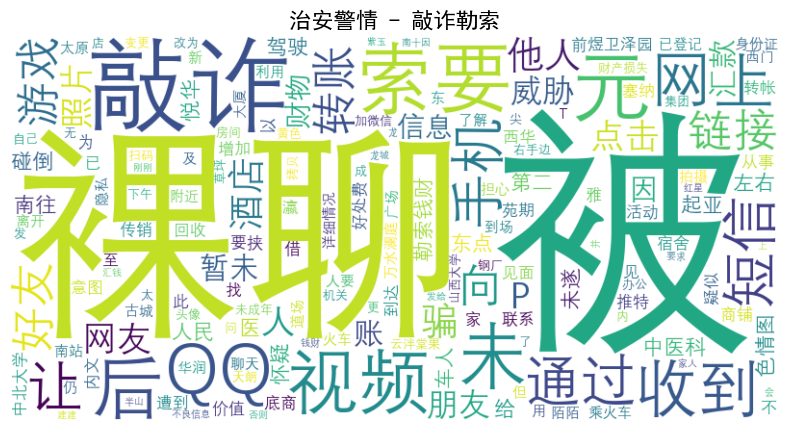

警情粗略类别: 治安警情 - 警情细致类别: 治安纠纷
纠纷: 10
发生: 8
人: 5
骚扰电话: 3
问题: 3
被: 3
他人: 3
因: 3
收到: 3
接到: 2
正常: 2
生活: 2
引发: 2
评价: 2
频繁: 2
还: 2
车: 2
车行: 2
恒台: 1
不断: 1
影响: 1
虎峪河: 1
因代驾: 1
接单: 1
东人: 1
信访: 1
满意度: 1
个人: 1
权利: 1
已: 1
使用: 1
后: 1
川西: 1
三小: 1
宿舍: 1
龙: 1
北侧: 1
乘客: 1
怀疑: 1
西高: 1
白段: 1
牙发生: 1
和场: 1
辱骂: 1
威胁: 1
殴打: 1
躲车: 1
内: 1
桥东: 1
L: 1
和: 1
家属: 1
一名: 1
自: 1
律师: 1
干扰: 1
泥屯: 1
因种民: 1
福兴: 1
雅苑: 1
工资: 1
王答: 1
公交站: 1
因拉货: 1
港丽城: 1
东边: 1
两个: 1
汽车轮胎: 1
气门: 1
针: 1
拔: 1
坞: 1
认识: 1
欠款: 1
填写: 1
是: 1
紧急: 1
联系人: 1
催款: 1
公司: 1
打: 1
来: 1
骚扰: 1
各: 1
平台: 1
发来: 1
验证码: 1
信息: 1
陈庄场: 1
对面: 1
矛盾: 1
蓝海: 1
国际: 1
汽配城: 1
未来: 1
名车: 1
抵押: 1
给: 1
拒: 1
不: 1
双方: 1
双: 1
体育馆: 1
不同: 1
码: 1
打来: 1




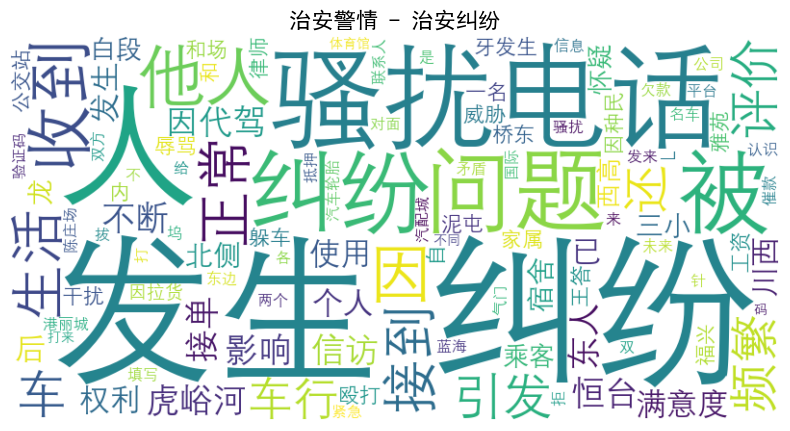

警情粗略类别: 治安警情 - 警情细致类别: 盗窃
价值: 12
被盗: 12
电动车: 8
元: 6
余元: 6
上: 4
公司: 3
发: 3
电线: 3
丢失: 3
一辆: 3
停放: 3
内: 3
自行车: 3
被: 3
盗走: 3
库房: 2
为: 2
宿舍: 2
昨晚: 2
电瓶: 2
查看: 2
监控: 2
男子: 2
一名: 2
工人: 2
许: 1
巡查: 1
人员: 1
储存: 1
后面: 1
空地: 1
废弃: 1
长度: 1
米: 1
规格: 1
芯: 1
黑色: 1
总价值: 1
左右: 1
爱玛: 1
万达: 1
广场: 1
附近: 1
发车: 1
双双: 1
塔: 1
B: 1
放置: 1
农机: 1
去年: 1
购买: 1
尖: 1
草坪: 1
地铁站: 1
A: 1
出: 1
几百元: 1
忘记: 1
车: 1
南内环: 1
凤凰: 1
牌子: 1
需要: 1
帮助: 1
长场: 1
永久: 1
牌: 1
黑土: 1
巷东: 1
发电: 1
瓶: 1
中铁: 1
三局: 1
医内: 1
昨许: 1
小推车: 1
经: 1
一人: 1
放到: 1
汽车: 1
然后: 1
离开: 1
万新: 1
中级人民: 1
法: 1
东南角: 1
幸福: 1
家园: 1
下: 1
烟酒: 1
商行: 1
一条: 1
中华: 1
香烟: 1
两名: 1
中午: 1
放: 1
富士康: 1
北门: 1
太重: 1
煤: 1
机制: 1
冷: 1
装备: 1
限: 1
工具包: 1
电: 1
扳手: 1
薛店: 1
物业: 1
货架: 1
快递: 1
停: 1
绿缘: 1
车牌: 1
不: 1
清楚: 1
浙江: 1
虎通: 1
工地: 1
电动工具: 1
撬: 1
开门: 1
场: 1




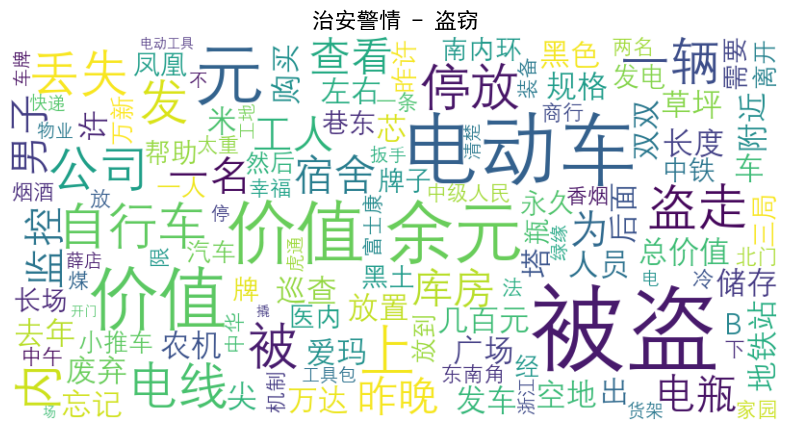

警情粗略类别: 治安警情 - 警情细致类别: 色情淫秽
卖淫嫖娼: 7
涉嫌: 6
调查: 6
举报: 5
嫖娼: 4
传唤: 4
一名: 4
我: 4
根据: 3
线索: 3
公安局: 3
中心: 3
内: 3
酒店: 3
小姐: 3
卖淫: 3
女子: 3
人: 3
服务: 3
并: 3
所: 3
抓获: 3
男子: 3
补录: 2
派出所: 2
违法: 2
嫌疑人: 2
草坪: 2
执法: 2
办案: 2
反映: 2
旁边: 2
店: 2
小: 2
印文: 2
接受: 2
洗浴: 2
此: 2
色情: 2
名叫: 2
进行: 2
偿: 2
公安机关: 2
岳伟: 2
至: 2
公元: 2
代城: 2
会: 2
安文婷: 2
放哨: 2
许: 1
新城: 1
电话: 1
联系: 1
王统: 1
至尖: 1
接收: 1
送: 1
外卖: 1
看到: 1
象: 1
新世纪: 1
剔尖馆: 1
往北二: 1
杜: 1
先生: 1
拨打: 1
北京: 1
代: 1
S: 1
黄河: 1
对面: 1
巷子: 1
被: 1
穿着: 1
暴露: 1
拉: 1
住: 1
怀疑: 1
体亲: 1
南: 1
举报人: 1
汽车玻璃: 1
上: 1
张贴: 1
黄色: 1
广告: 1
队: 1
核查: 1
发罗: 1
嫌疑: 1
我队: 1
遂: 1
罗: 1
回: 1
清徐: 1
治安: 1
大队: 1
转办: 1
世贸中心: 1
维纳斯: 1
ktv: 1
每: 1
开始: 1
情况: 1
教场: 1
巷: 1
全季: 1
具体情况: 1
拒讲: 1
迎西: 1
歌城: 1
红红: 1
家: 1
歌厅: 1
丈夫: 1
张: 1
阳阳: 1
景江: 1
都城: 1
附近: 1
面上: 1
淫秽: 1
卡片: 1
义井: 1
后面: 1
阳光: 1
之前: 1
上班: 1
听: 1
他人: 1
讲述: 1
领域: 1
娱乐: 1
一: 1
王丽慧: 1
女: 1
工作: 1
中: 1
李凤英: 1
任雪飞: 1
查获: 1
带回: 1
尖龙: 1
城内: 1
经查: 1
该名: 1
随即: 1
依法: 1
尖: 1
局: 1
管理中心: 1
万: 1
李旭梅经: 1
发万: 1
新: 1
都: 1
还: 1
违法行为: 1
后于: 1
做: 1
进一步: 1
体君泰代: 1
二: 

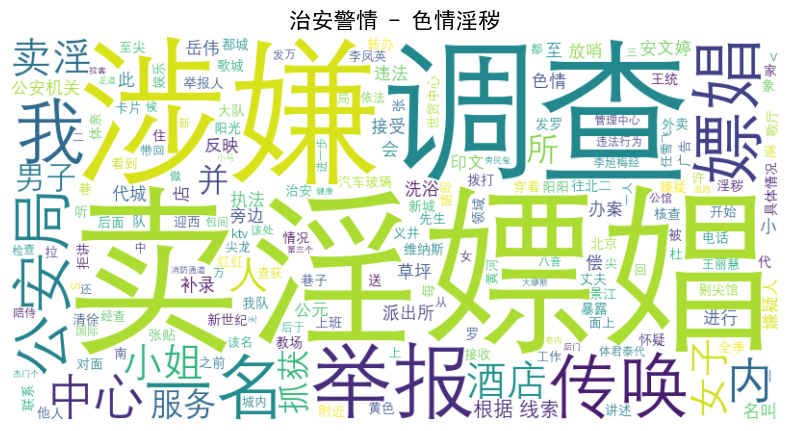

警情粗略类别: 治安警情 - 警情细致类别: 虐待
孩子: 2
殴打: 2
需要: 2
紫檀: 1
会馆: 1
往东: 1
胡同: 1
内: 1
看见: 1
一名: 1
家长: 1
自己: 1
具体情况: 1
不清: 1
不: 1
东涧河: 1
春天: 1
幼儿园: 1
岁: 1
女儿: 1
被: 1
两名: 1
老师: 1
共同: 1
就场: 1
处理: 1




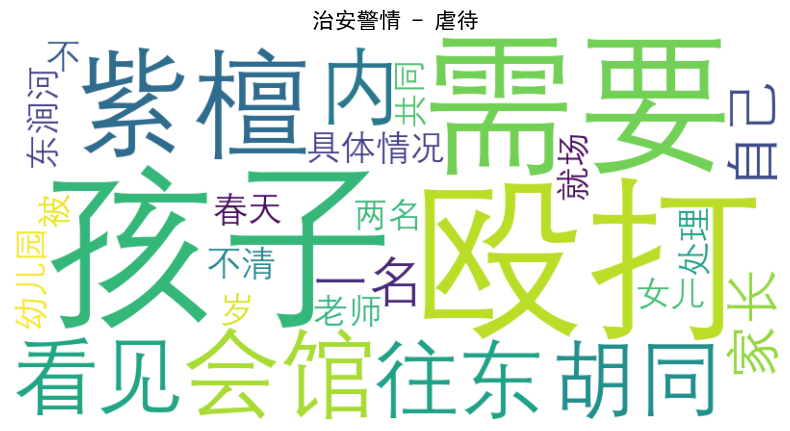

警情粗略类别: 治安警情 - 警情细致类别: 诈骗
被: 17
骗: 14
给: 9
游戏: 7
元: 6
怀疑: 6
发: 6
账: 5
购买: 5
联系: 5
是: 5
上: 4
需要: 4
转账: 4
人: 4
操作: 3
受骗: 3
接到: 3
电话: 3
银行卡: 3
诈骗: 3
办理: 3
母亲: 3
告知: 3
余元: 3
关门: 3
网上: 3
认识: 2
卖: 2
按照: 2
提示: 2
内: 2
通过: 2
微信: 2
不: 2
山西: 2
学: 2
QQ: 2
Q: 2
币: 2
转帐: 2
后: 2
一直: 2
收到: 2
已: 2
会员: 2
提供: 2
人员: 2
主播: 2
刷: 2
礼物: 2
认为: 2
此: 2
元后: 2
不上: 2
一名: 2
并: 2
验证码: 2
网友: 2
手机: 2
鱼塘: 2
付款: 2
电脑: 2
维修: 2
充值: 2
该店: 2
贷款: 2
光信: 1
帝景: 1
华府: 1
闲鱼: 1
先: 1
验证: 1
骗取: 1
接待: 1
富士: 1
买: 1
衣服: 1
发货: 1
北格: 1
应用: 1
科技: 1
钱: 1
从: 1
下午: 1
未: 1
并且: 1
无法: 1
卖家: 1
网上交易: 1
支付宝: 1
东: 1
中环: 1
上午: 1
左右: 1
抖音开: 1
每: 1
扣费: 1
如要: 1
解除: 1
暂无: 1
损失: 1
昨天: 1
了: 1
多元: 1
我台: 1
答复: 1
成年人: 1
自愿: 1
行为: 1
构成: 1
案件: 1
自己: 1
智力: 1
残疾: 1
诱导: 1
执意: 1
红星: 1
紫御: 1
找: 1
公司: 1
注销: 1
事宜: 1
为: 1
太航: 1
大酒店: 1
今天: 1
早晨: 1
点: 1
自太: 1
原籍: 1
警: 1
曾经: 1
身份证: 1
借给: 1
他人: 1
该: 1
身份: 1
犯罪: 1
记录: 1
根据: 1
引导: 1
个人信息: 1
录入: 1
人脸: 1
暂未发: 1
经济损失: 1
许许: 1
金闲鱼: 1
售卖: 1
电动: 1
座椅: 1
按: 1
要求: 1
点击: 1
链接: 1
输入: 1
金: 1
被盗: 1
海棠: 1
家园: 1
账后: 1
润: 1
景园: 1
著闲鱼: 1
平台

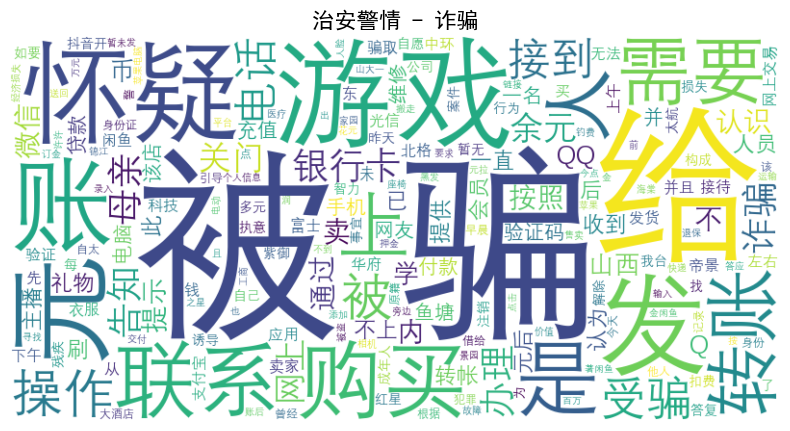

警情粗略类别: 治安警情 - 警情细致类别: 赌博
赌博: 12
打麻: 5
人: 5
娄烦: 4
棋牌: 3
旁边: 3
我: 3
发: 3
方式: 3
工作: 3
形式: 2
家人: 2
线索: 2
APP: 2
后: 2
参: 2
所: 2
中: 2
网络: 2
可以: 2
转办: 1
滨庞: 1
委会: 1
东侧: 1
米左右: 1
家: 1
聚众赌博: 1
北洋: 1
洋生: 1
门面房: 1
人以: 1
闫爱: 1
平和: 1
武变英: 1
胜利: 1
桥西: 1
诺冠: 1
台球厅: 1
北格梁: 1
张小卷: 1
不: 1
需要: 1
接待: 1
太钢: 1
西: 1
年许: 1
所接: 1
上级: 1
下发: 1
居住: 1
南江: 1
凯物: 1
内: 1
宿舍: 1
张艺辉: 1
通过: 1
手机: 1
下载: 1
香妃: 1
登录: 1
该: 1
利用: 1
摇: 1
色子: 1
比: 1
大小: 1
清徐: 1
孟封人: 1
董健: 1
嫌疑: 1
传唤: 1
回: 1
公安机关: 1
接受: 1
调查: 1
二中: 1
往西: 1
惠民: 1
南: 1
七巷: 1
靠左边: 1
倒数: 1
第五个: 1
大门: 1
昌: 1
政府: 1
附近: 1
微信: 1
群内: 1
看到: 1
人员: 1
以炸: 1
金花: 1
要求: 1
信息: 1
对外: 1
保密: 1
联系: 1
中海: 1
环宇: 1
代: 1
一期: 1
北门: 1
馆人: 1
并且: 1
扰民: 1
南门: 1
停车场: 1
自行车: 1
棚人: 1
移民: 1
二期: 1
东人: 1
中发: 1
刘泰年: 1
以来: 1
涉嫌: 1
太原: 1
晋武: 1
纸箱厂: 1
西南: 1
米滨北: 1
举报: 1
余人以: 1
倒: 1
胡: 1
外围: 1
放哨: 1
鹅接: 1
人人: 1
给: 1
位置: 1
下午: 1
马家庄: 1
派出所: 1
根据: 1
掌握: 1
城西: 1
打麻扣: 1
点点: 1
进行: 1
冯国珍: 1
张: 1
海生: 1
王: 1
保存: 1
冀俊爱: 1
四人: 1
查获: 1




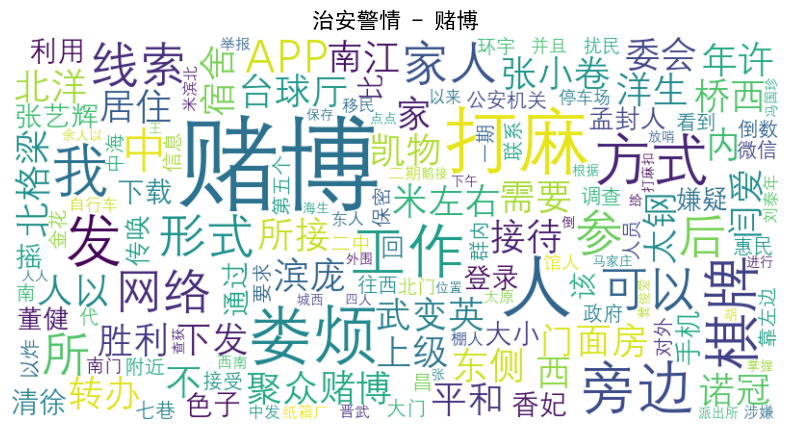

警情粗略类别: 治安警情 - 警情细致类别: 非法侵入他人住宅
自己: 5
闯入: 3
不: 2
非法: 2
微信: 2
人私: 2
闯: 2
民宅: 2
家中: 2
小中通: 1
快递: 1
第三排: 1
五人: 1
翻墙: 1
进入: 1
租住: 1
子问: 1
原因: 1
清楚: 1
中铁: 1
诺德: 1
城人: 1
家: 1
北美: 1
N: 1
新奥莱: 1
旁边: 1
海棠: 1
公馆: 1
昨晚: 1
发: 1
店内: 1
被盗: 1
用: 1
并且: 1
以: 1
名义: 1
之前: 1
顾客: 1
拉进: 1
知名: 1
群里: 1
许东: 1
安置: 1
余未: 1
讲: 1
机场: 1
一: 1
男子: 1
欠: 1
他: 1
钱: 1
山投: 1
城上城: 1
名要: 1
债人: 1
王家: 1
龙城: 1
新苑: 1
H: 1
人: 1
入侵: 1
住宅: 1
昆仑: 1
御: 1
北门: 1
后: 1
听: 1
不到: 1
声音: 1




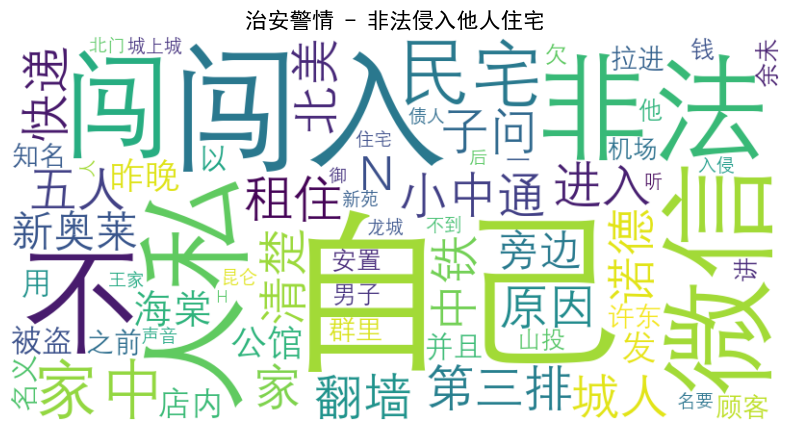

警情粗略类别: 消防救援 - 警情细致类别: 其它消防救援
着火: 10
看到: 6
情况: 6
人: 6
具体情况: 4
不清: 4
不详: 4
已: 3
不: 3
电梯: 2
他: 2
接: 2
家中: 2
到场: 2
钟前: 2
内: 2
来电: 2
中: 2
电话: 2
被困: 2
一: 2
了: 2
西: 1
中环: 1
东: 1
昇: 1
佳: 1
园内: 1
美都汇: 1
购物广场: 1
一名: 1
行人: 1
卡: 1
处: 1
通知: 1
南: 1
保利: 1
东俊下: 1
门面: 1
二: 1
它: 1
均: 1
讲: 1
清场: 1
联系电话: 1
国泰: 1
龙城: 1
湾: 1
C: 1
民报: 1
两岁: 1
孩子: 1
被: 1
反锁: 1
需要: 1
破门: 1
请: 1
帮助: 1
大: 1
宝林寺: 1
旁未: 1
交付: 1
住宅: 1
明火: 1
老: 1
军营: 1
第三: 1
实验: 1
小学: 1
电动车: 1
棚: 1
未: 1
人员: 1
受伤: 1
是: 1
学校: 1
对面: 1
上: 1
居民: 1
无线电: 1
一厂: 1
旁: 1
平龙星程: 1
酒店: 1
巷子: 1
内过: 1
墙上: 1
电表箱: 1
电火花: 1
恐: 1
万达: 1
广场: 1
城隍庙: 1
文华: 1
小小: 1
商铺: 1
火已: 1
灭: 1
联系方式: 1
接民新: 1
交叉: 1
冒: 1
黑烟: 1
具体: 1
滨往: 1
方向: 1
草地: 1
起火: 1
消防人员: 1
赶赴: 1
场余: 1
清人: 1
故意: 1
点火: 1
煤炭: 1
医家: 1
属: 1
高: 1
两人: 1
星河湾: 1
园: 1
闻到: 1
该: 1
烟味: 1
消防: 1
警员: 1
男子: 1
娄烦: 1
马家庄: 1
安: 1
地方: 1
伞儿: 1
树: 1
A: 1
加五: 1
D座: 1
道: 1
失火: 1
晋祠: 1
无: 1
具体位置: 1
小孩: 1
说: 1
家里: 1
快: 1
来: 1
随后: 1
挂断: 1
回拨: 1
接听: 1
南内环: 1
华邦: 1
国际: 1
E座: 1
e: 1
油烟机: 1
详细情况: 1




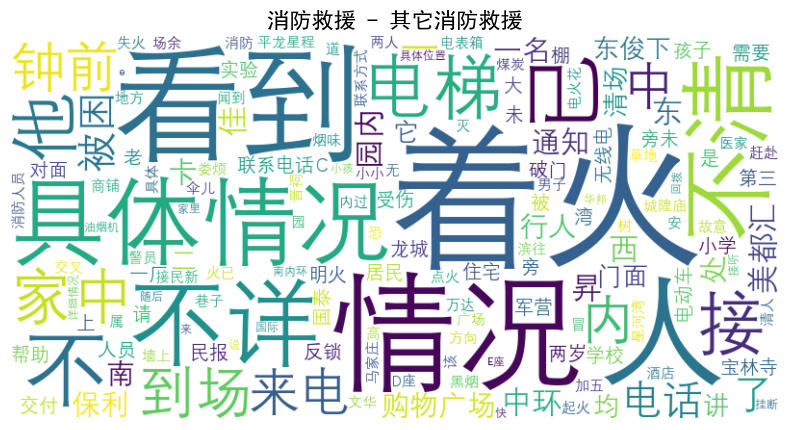

警情粗略类别: 消防救援 - 警情细致类别: 抢险救援
着火: 2
天然气: 2
坞: 1
万景: 1
家园: 1
综合: 1
困: 1
电梯: 1
内: 1
求助: 1
龙富力: 1
尚悦: 1
居民: 1
出门: 1
忘记: 1
拿: 1
钥匙: 1
厨房: 1
还开: 1
需要: 1
破门: 1
无人: 1
被困: 1
昌: 1
肯德基: 1
后: 1
施工: 1
管道: 1
挖断: 1
泄露: 1
请: 1
帮助: 1
维持: 1
场: 1
秩序: 1
房子: 1
电话: 1
南寒寺: 1
都: 1
斩: 1
到: 1
邻居家: 1
打架: 1
声音: 1




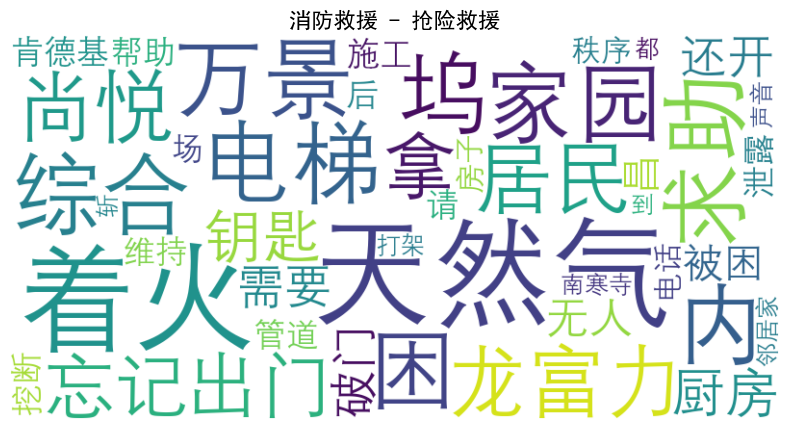

警情粗略类别: 消防救援 - 警情细致类别: 火灾
着火: 13
电话: 5
家中: 5
具体情况: 4
附近: 4
人: 4
不: 3
不清: 3
情况: 3
电线: 3
看到: 2
火势: 2
较大: 2
清人: 2
交叉: 2
看见: 2
失火: 2
我台: 2
内: 2
发: 2
调查: 2
消防: 2
火灾: 2
他: 2
一: 2
住: 2
接民: 1
来电: 1
新开: 1
南巷: 1
外部: 1
电梯: 1
泥向线: 1
二: 1
电厂: 1
徐沟: 1
东门: 1
半挂车: 1
无: 1
人员: 1
被困: 1
北格: 1
自建房: 1
余: 1
不详: 1
报: 1
物业: 1
使用: 1
反映: 1
十七: 1
局五: 1
公司: 1
宿舍: 1
百德: 1
情结: 1
比较: 1
激动: 1
它: 1
无法: 1
提供: 1
回拔: 1
一直: 1
占线: 1
晋祠: 1
中午: 1
杂草: 1
消防人员: 1
已火: 1
扑灭: 1
民: 1
梨树: 1
被: 1
损坏: 1
让: 1
赔偿: 1
要求: 1
介入: 1
我: 1
所: 1
接尖: 1
救援: 1
大队: 1
移交: 1
下午: 1
许尖: 1
马头: 1
水上: 1
发生: 1
违法: 1
嫌疑: 1
李宏: 1
祭扫: 1
过程: 1
中: 1
过失: 1
引起: 1
龙康: 1
新: 1
烟头: 1
点燃: 1
物品: 1
钢城: 1
公寓: 1
联系人: 1
火已: 1
灭: 1
草地: 1
祈福: 1
寺接: 1
民报: 1
寺庙: 1
已到: 1
正: 1
工作: 1
中庙: 1
没人: 1
太原: 1
无线电: 1
一住: 1
厨房: 1
具体: 1
详情: 1
清楚: 1
联系方式: 1
兴中: 1
人家: 1
对面: 1
该: 1
冒烟: 1
龙: 1
西南角: 1
聚: 1
场内: 1
饭店: 1
情况不明: 1
引燃: 1
瓦房: 1




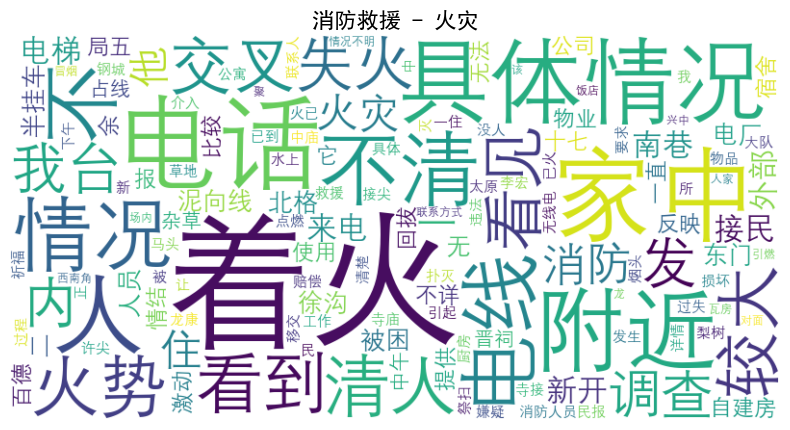

警情粗略类别: 灾害事故 - 警情细致类别: 其它灾害事故
后面: 1
山上: 1
电线杆: 1
冒: 1
火花: 1




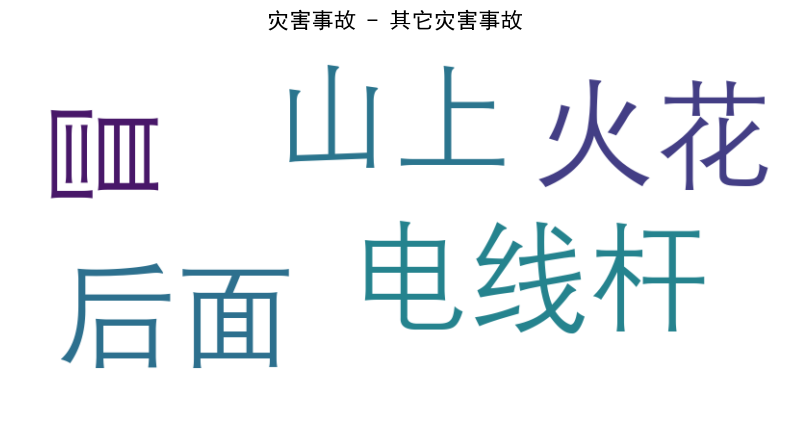

警情粗略类别: 社会联动 - 警情细致类别:  林水管理 
迎: 1
粮食局: 1
宿舍: 1
西侧: 1
拉面馆: 1
高音喇叭: 1
扰民: 1




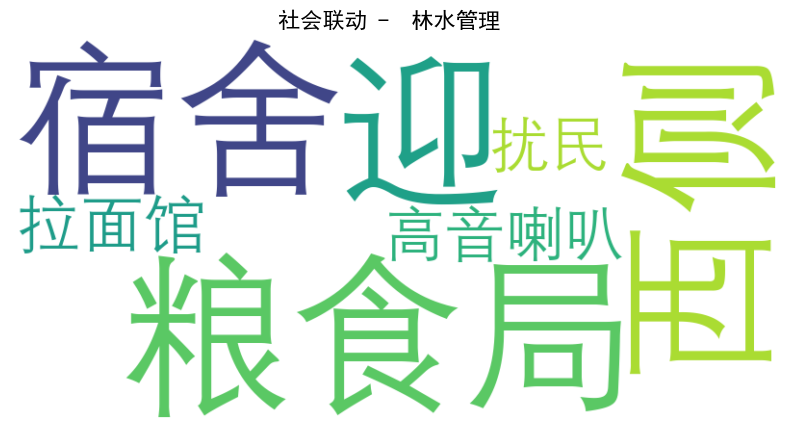

警情粗略类别: 社会联动 - 警情细致类别: 其它社会联动
转接: 5
看到: 3
已: 3
破损: 3
反映: 2
地面: 2
人: 2
西: 2
中环: 2
指示牌: 2
往西米: 2
公安: 2
上: 2
存: 2
安全隐患: 2
玉门: 2
沿岸: 2
水泥块: 2
往: 2
交通: 2
护栏: 2
许葡边: 1
露天: 1
烧烤: 1
无净烟: 1
装置: 1
我台: 1
塌陷: 1
已用: 1
警戒线: 1
围挡: 1
九州: 1
家具城: 1
顾客: 1
投诉: 1
被: 1
工商部门: 1
封店: 1
杏: 1
杏花: 1
岭: 1
一条: 1
往东米: 1
南: 1
电力: 1
宿舍: 1
门前: 1
公交: 1
杏晋: 1
南唐: 1
久: 1
便利: 1
对面: 1
马: 1
连营: 1
广汽: 1
丰田: 1
黄河: 1
店收: 1
押金: 1
不退: 1
万科: 1
翡翠: 1
工地: 1
欠工: 1
北便: 1
道: 1
天网: 1
监控: 1
设施: 1
门: 1
下雨天: 1
飞线: 1
充: 1
电动车: 1
米杰: 1
二场: 1
买: 1
电车: 1
出门: 1
后发: 1
故障: 1
河北: 1
北侧: 1
地下通道: 1
积水: 1
不: 1
清楚: 1
是否: 1
水管: 1
破裂: 1
暂未: 1
被困: 1
人员: 1
车辆: 1
无法: 1
通行: 1
至: 1
北向南: 1
面上: 1
两: 1
三块: 1
大: 1
若干: 1
小: 1
尖: 1
草坪: 1
富力: 1
天禧: 1
城: 1
B: 1
灯牌: 1
一直: 1
亮: 1
着: 1
影响: 1
休息: 1
坞: 1
东米南: 1
第灯: 1
杆: 1
检修: 1
缺失: 1
郝: 1
辰阳: 1
西条: 1
西米北: 1
车行道: 1
拆除: 1
遗留下: 1
残桩: 1
高于: 1
瓦流南: 1
二条: 1
河南: 1
往南米: 1
东: 1
机动车道: 1
损坏: 1
脱扣: 1




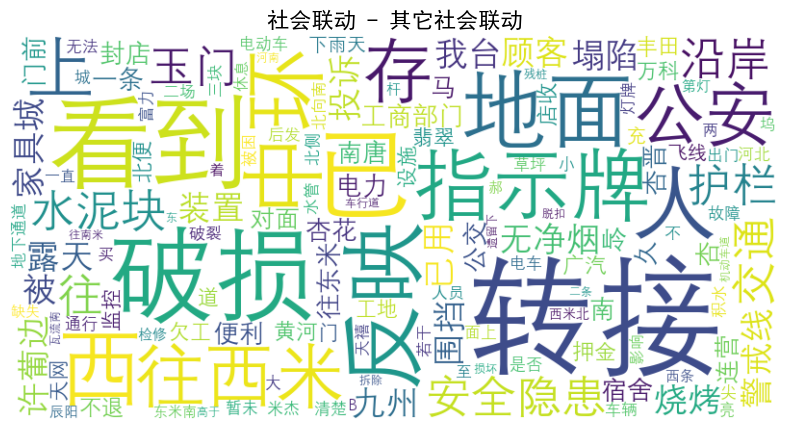

警情粗略类别: 社会联动 - 警情细致类别: 安全生产监督
燃放烟花: 7
爆竹: 7
人员: 5
民: 5
电话: 5
反映: 4
转办: 4
保密: 3
工地: 2
内: 2
此: 2
要求: 2
制止: 2
尖: 1
草坪: 1
沪: 1
硅: 1
发生: 1
刮: 1
蹭: 1
K: 1
下: 1
噪音: 1
扰民: 1
亲: 1
北侧: 1
操场: 1
人此: 1
人正: 1
老军: 1
西侧: 1
盆景园: 1
卧: 1
东侧: 1
米: 1
龙泉: 1
反内: 1




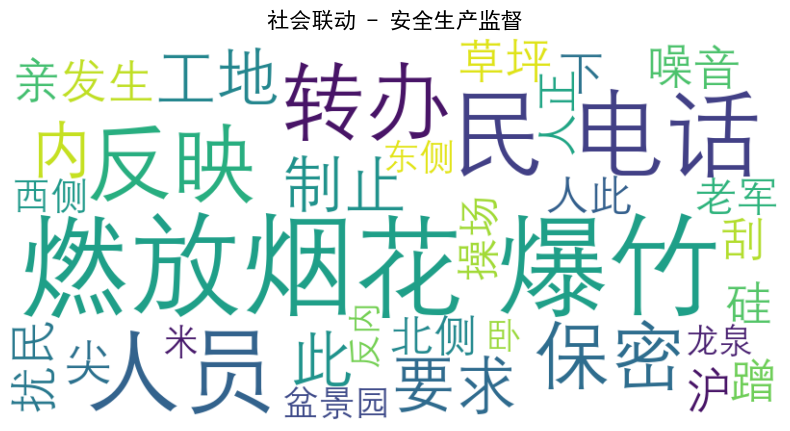

警情粗略类别: 社会联动 - 警情细致类别: 文广管理
柳巷: 1
风云: 1
再起: 1
游戏厅: 1
工作人员: 1
未成年人: 1
可以: 1
进入: 1
人家: 1
岁: 1
孩子: 1
正: 1
里面: 1
消费: 1
求助: 1




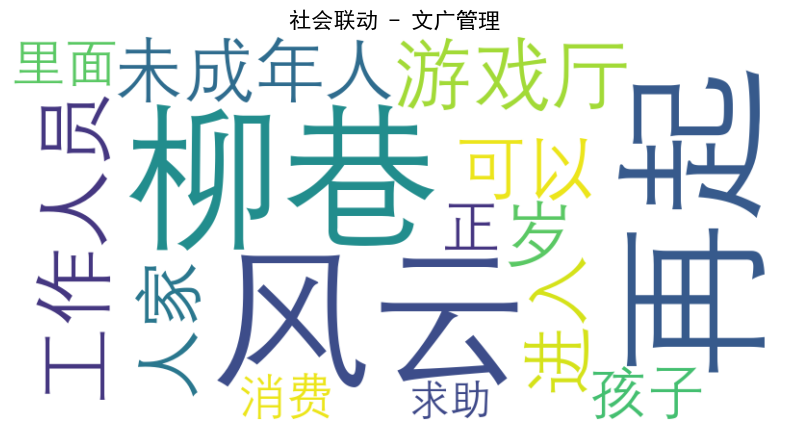

警情粗略类别: 社会联动 - 警情细致类别: 水气热抢修
三江: 1
源: 1
旁边: 1
热力: 1
管道: 1
暖气: 1
管跑: 1
水: 1




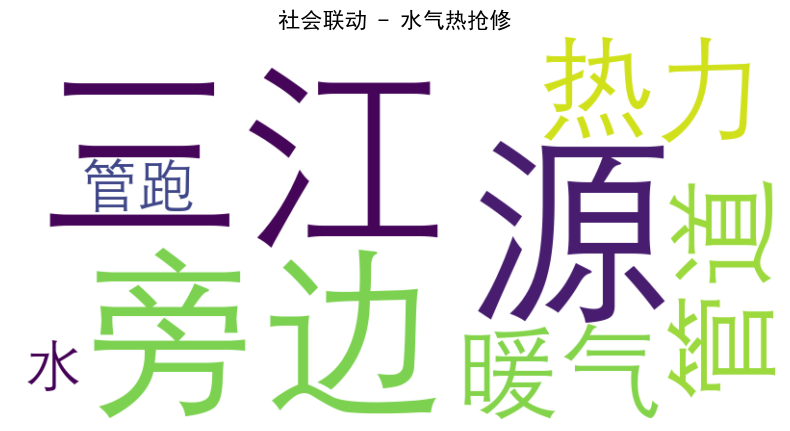

警情粗略类别: 社会联动 - 警情细致类别: 环保执法
扰民: 19
噪音: 9
声音: 7
高音喇叭: 5
过大: 4
烧烤: 4
西北角: 4
底商: 3
求助: 3
反映: 3
使用: 3
人: 3
装修: 2
下: 2
播放: 2
音乐: 2
电话: 2
保密: 2
高: 2
迎: 2
老二: 2
人员: 2
就餐: 2
吃饭: 2
严重: 2
土豆粉: 1
阳光: 1
摩登: 1
秀场: 1
迪厅: 1
低音炮: 1
新开: 1
南巷: 1
摊: 1
顾客: 1
喧哗: 1
杏花: 1
岭: 1
五龙: 1
往南米: 1
西: 1
东北: 1
雪儿: 1
底: 1
商民: 1
喧哗声: 1
交办: 1
民: 1
千: 1
交叉: 1
潮漫: 1
酒店: 1
新疆: 1
兴: 1
饭店: 1
还: 1
营业: 1
平阳: 1
景苑: 1
该: 1
住: 1
发出声音: 1
需要: 1
接待: 1
答复: 1
南侧: 1
无名: 1
麻馆: 1
打麻: 1
铲车: 1
一直: 1
施工: 1
较: 1
影响: 1
孩子: 1
休息: 1
开蜜雪: 1
冰城: 1
此商: 1
如意: 1
龙城: 1
湾: 1
一: 1
居民: 1
家: 1
发出: 1
疑似: 1
打架: 1
要求: 1
常期: 1
此: 1
每天晚上: 1
开始: 1
拖拽: 1
椅子: 1
制造: 1
多次: 1
协商: 1
未果: 1
台民: 1
天龙: 1
盛旁: 1
小帅: 1
浇: 1
卤: 1
串串香: 1
每: 1
晚上: 1
人下: 1
烧烤店: 1
唱歌: 1
太: 1
大: 1
郝庄芳: 1
林寺: 1
附近: 1
唱戏: 1
嘉: 1
东侧: 1
底商商: 1
寇文兴: 1
独商: 1
瓦: 1
银海: 1
KTV: 1




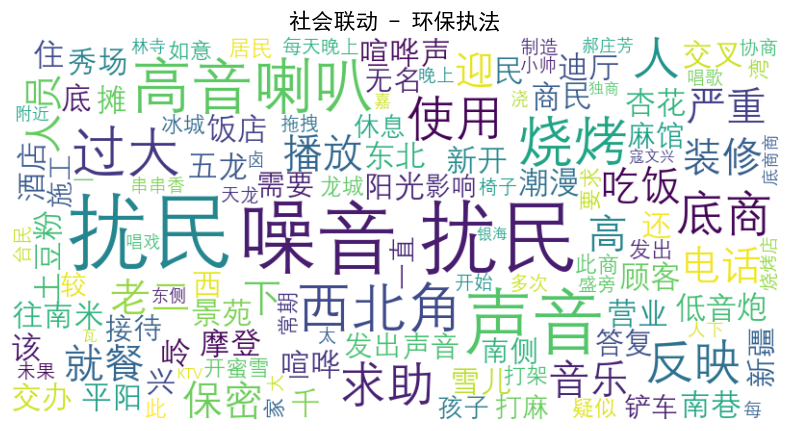

警情粗略类别: 社会联动 - 警情细致类别: 食品药品管理
百姓: 1
饭店: 1
人家: 1
中办: 1
白事: 1
从: 1
昨天中午: 1
到: 1
共: 1
十五六个: 1
人: 1
吃饭: 1
后: 1
拉肚子: 1




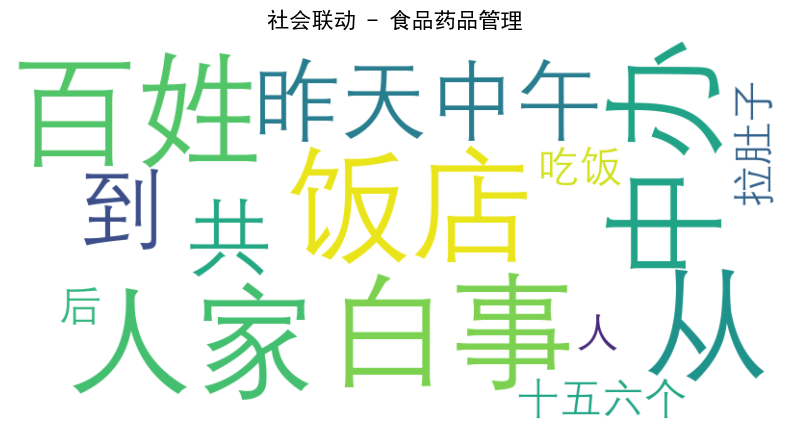

警情粗略类别: 群众求助 - 警情细致类别: 其它群众求助
求助: 13
发生: 8
一名: 8
男子: 8
危险: 6
人: 5
西: 5
中环: 5
躺: 4
恐: 4
看见: 4
离开: 3
具体情况: 3
给: 3
要: 3
担心: 3
醉酒: 3
桥: 3
北向南: 3
看到: 3
电话: 3
一: 3
东: 2
客站: 2
附近: 2
爱人: 2
是: 2
需要: 2
男友: 2
打电话: 2
此: 2
女子: 2
上: 2
方向: 2
步行: 2
问题: 2
行走: 2
科技: 2
大学: 2
处: 2
宿舍: 2
司机: 2
拦住: 1
不让: 1
宾馆: 1
人人: 1
上海: 1
郭青秀: 1
来: 1
太原: 1
参加: 1
活动: 1
怀疑: 1
传销: 1
织: 1
只: 1
知道: 1
居住: 1
不详: 1
提供: 1
帮助: 1
提出: 1
手后: 1
拿: 1
刀: 1
寻找: 1
等待: 1
推搡: 1
拒讲: 1
接待: 1
城: 1
家园: 1
物业: 1
对面: 1
着: 1
意识: 1
快到: 1
南内环: 1
公里: 1
老人: 1
桥面: 1
南: 1
阳光: 1
数码港: 1
西侧: 1
巷内: 1
安全: 1
山西省: 1
人民: 1
医: 1
急诊: 1
被: 1
他人: 1
用: 1
开水: 1
泼: 1
小: 1
前男友: 1
拒: 1
不: 1
影响: 1
正常: 1
生活: 1
上坡: 1
处一: 1
高架桥: 1
上桥: 1
疑似: 1
公园: 1
广场: 1
不清: 1
恒大: 1
绿洲: 1
北门: 1
一辆: 1
车牌: 1
为: 1
白色: 1
本田: 1
车主: 1
驾驶: 1
窗未关: 1
虎峪: 1
河北: 1
沿岸: 1
代: 1
公馆: 1
棋牌: 1
馆: 1
反映: 1
没: 1
灭火: 1
设施: 1
存: 1
安全隐患: 1
公交: 1
因: 1
租房: 1
纠纷: 1
十里铺: 1
南侧: 1
下车: 1
送: 1
朋友: 1
回: 1
酒店: 1
让: 1
等: 1
一下: 1
出来: 1
发: 1
已: 1
车上: 1
还: 1
个人: 1
物品: 1
山西: 1
工程: 1
职业: 1
学: 1
男生宿舍: 1
同学: 1
微信: 1
恐吓: 1
叫: 1
人来: 1


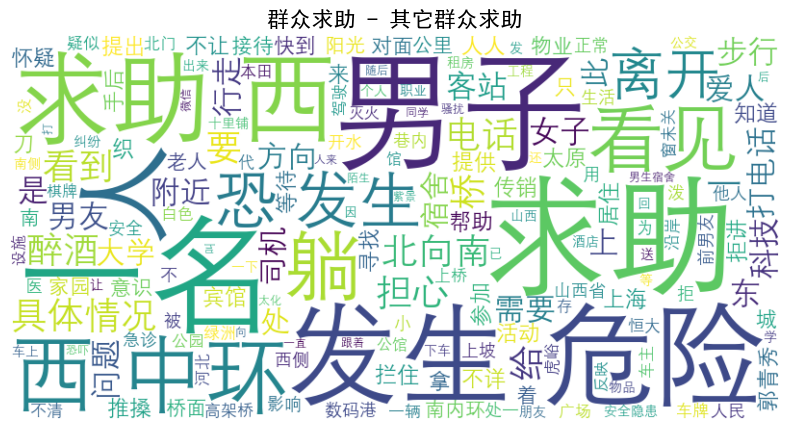

警情粗略类别: 群众求助 - 警情细致类别: 危急病人求助
娄烦: 1
峰: 1
高君宇: 1
纪念馆: 1
附近: 1
他: 1
老舅: 1
一个: 1
人家: 1
病危: 1
需要: 1
求助: 1




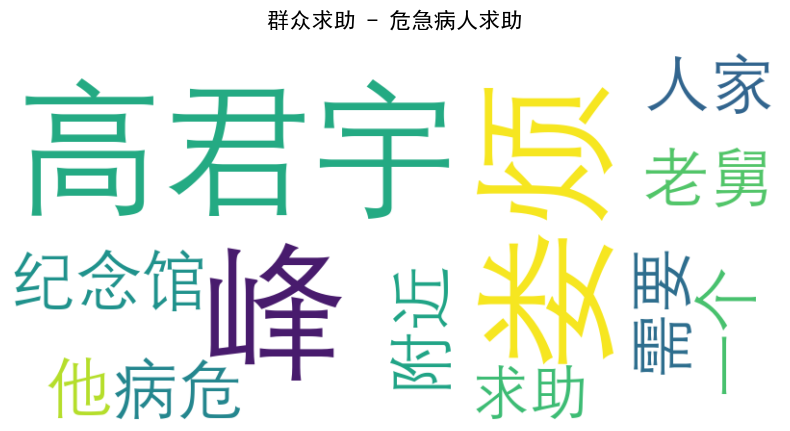

警情粗略类别: 群众求助 - 警情细致类别: 坠楼求助
一名: 2
女子: 2
下午: 1
点: 1
从山大一: 1
门诊: 1
四跳: 1
至: 1
二: 1
平台: 1
急诊: 1
救治: 1
伤势: 1
情况: 1
不清: 1
家属: 1
也场: 1
亲茂业: 1
天地: 1
酒吧: 1
醉酒: 1
男子: 1
从: 1
米处: 1
坠落: 1
目前: 1
人无事: 1
被: 1
挂: 1
空中: 1
已: 1
自行: 1
通知: 1
台人: 1
电话: 1




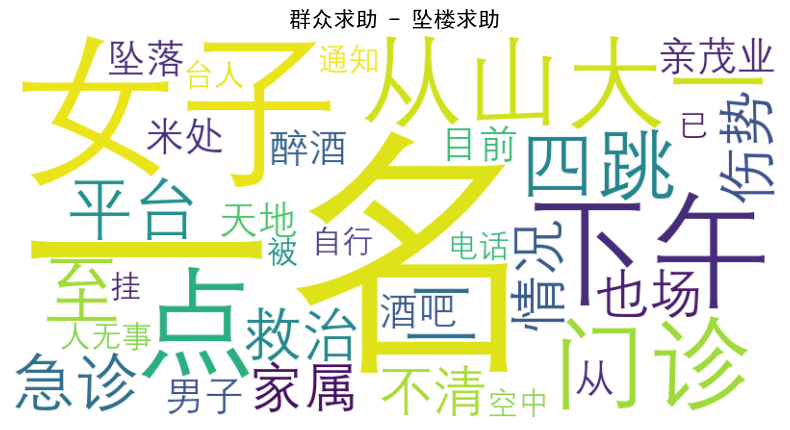

警情粗略类别: 群众求助 - 警情细致类别: 失物求助
遗失: 14
求助: 12
手机: 7
上: 5
丢失: 4
监控: 4
出租车: 4
许: 3
查看: 3
龙: 2
一部: 2
商场: 2
苹果: 2
不: 2
清楚: 2
还是: 2
被盗: 2
乘坐: 2
到: 2
车上: 2
捡: 2
吃饭: 1
候: 1
钟前: 1
千: 1
卖: 1
菠萝: 1
摊位: 1
一串: 1
钥匙: 1
星悦茂: 1
北侧: 1
卫生间: 1
内: 1
想要: 1
半小前: 1
保利: 1
西江: 1
对场: 1
平板: 1
电脑: 1
骑车: 1
过程: 1
中: 1
放: 1
袋中: 1
酒: 1
帮: 1
格林: 1
花园: 1
中间: 1
巷子: 1
内童乐: 1
幼儿园: 1
女儿: 1
包: 1
座位: 1
想: 1
西门: 1
处: 1
此: 1
下车: 1
笔记本电脑: 1
忘记: 1
白金: 1
人袋: 1
内元金: 1
需求: 1
助: 1
一辆: 1
电动: 1
自行车: 1
一个: 1
驾驶证: 1
联系: 1
不上: 1
失主: 1
富士康: 1
对面: 1
佳园: 1
生活: 1
广场: 1
女朋友: 1
手表: 1
通过: 1
调取: 1
系: 1
一名: 1
骑: 1
电动车: 1
陌生人: 1
走: 1
十三: 1
小: 1
对: 1
OPPO: 1
坐: 1
便: 1
椅放: 1
太原: 1
南站: 1
出站: 1
身份证: 1
网约: 1




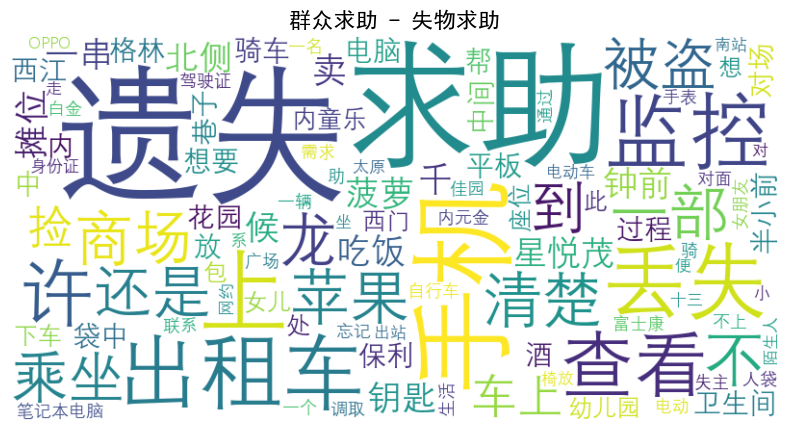

警情粗略类别: 群众求助 - 警情细致类别: 开锁求助
求助: 4
孙子: 2
遗失: 2
走失: 2
查看: 2
监控: 2
需要: 2
王家: 1
巷金盛园: 1
D座: 1
岁: 1
房间: 1
睡觉: 1
卧: 1
门锁: 1
打不开: 1
敲门: 1
无: 1
反应: 1
担心: 1
安危: 1
通知: 1
台: 1
东缉虎营: 1
蜜雪: 1
冰城: 1
放: 1
自行车: 1
上: 1
包包: 1
天美: 1
新天地: 1
兄弟: 1
通过: 1
长风: 1
东所: 1
看见: 1
人员: 1
此: 1
附近: 1
想: 1
东: 1
儿子: 1
昨天下午: 1
乘坐: 1
滴滴: 1
车至: 1
手机: 1
健: 1
湖滨: 1
文景: 1
苑岁: 1
小孩: 1
被: 1
反锁: 1
家中: 1
卧因: 1
锁具: 1
复杂: 1
破窗: 1
进入: 1
后: 1
开锁: 1
到场: 1
人: 1
联系方式: 1




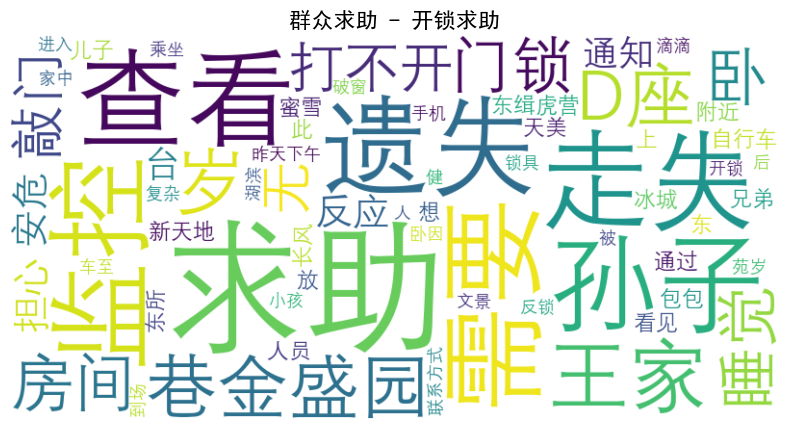

警情粗略类别: 群众求助 - 警情细致类别: 水、电、气、热险情求助
着火: 6
漏水: 5
求助: 4
人: 4
已: 4
不: 4
家中: 3
帮助: 3
也: 3
电话: 3
管道: 3
道: 2
家: 2
物业: 2
清楚: 2
通知: 2
接到: 2
消防队员: 2
仍: 2
联系: 2
供电局: 2
产权: 2
管辖: 2
太原: 2
二中: 2
上: 2
看到: 2
内: 2
车辆: 2
新欣苑: 1
里: 1
烟: 1
需求: 1
助: 1
半: 1
儿女: 1
均: 1
外地: 1
无: 1
玉门: 1
河东岸: 1
紫景苑: 1
背后: 1
车棚: 1
消防: 1
到场: 1
官: 1
地点: 1
式: 1
卫生间: 1
家人: 1
联系方式: 1
需要: 1
滨南: 1
沙河: 1
旭兴: 1
花园: 1
电线: 1
荣: 1
第二: 1
中学: 1
旁: 1
两根: 1
电线杆: 1
中: 1
变压器: 1
明火: 1
扑灭: 1
但是: 1
还: 1
未: 1
断电: 1
噼里啪啦: 1
放电: 1
停电: 1
个人: 1
不属: 1
他们: 1
工作人员: 1
场: 1
属: 1
范围: 1
明晰: 1
且: 1
可能: 1
存: 1
危险: 1
希望: 1
核实: 1
所属单位: 1
怡: 1
安居: 1
因: 1
问题: 1
郝: 1
晨光: 1
烧烤: 1
炉子: 1
是: 1
蓝水易: 1
居: 1
果园: 1
放炮: 1
河道: 1
尖: 1
草坪: 1
阳曲: 1
北: 1
委会: 1
东侧: 1
天燃气: 1
被: 1
撞损: 1
导致: 1
漏气: 1
肇事: 1
信息: 1
目前: 1
关闭: 1
上游: 1
球阀: 1
居民: 1
供气: 1
受: 1
影响: 1
他: 1
受损: 1
情况: 1
正: 1
排查: 1
暖气: 1
管: 1
不到: 1
上北二: 1
电厂: 1
宿舍: 1
地下: 1
厕所: 1
水管: 1
具体情况: 1
讲不清: 1




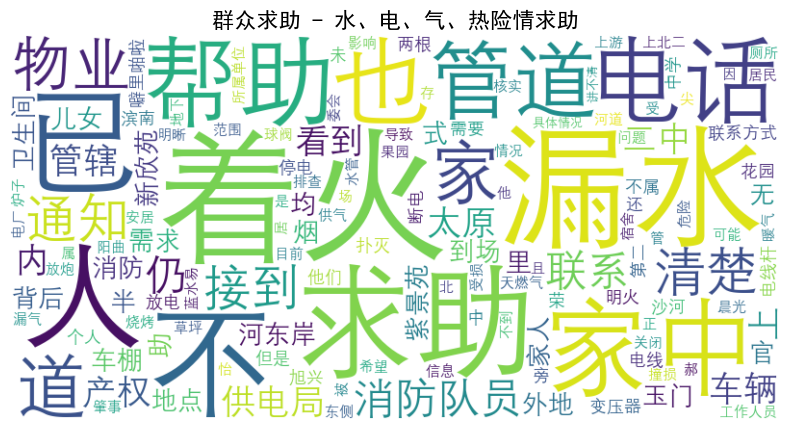

警情粗略类别: 群众求助 - 警情细致类别: 自杀求助
男友: 10
要: 7
人: 7
给: 5
自杀: 5
客服: 4
因: 4
不: 4
腾讯: 3
了: 3
朋友: 3
打电话: 3
清徐: 3
位置: 2
网友: 2
不想: 2
活: 2
着: 2
跳: 2
电话: 2
向阳: 2
店众鑫: 2
酒店: 2
厕所: 2
一: 2
女子: 2
倾向: 2
联系方式: 2
汾河: 2
求助: 2
T: 2
不让: 2
离开: 2
轻生: 2
帮助: 2
压力: 2
司机: 2
平台: 2
已: 2
准备: 2
姓名: 2
微信: 2
活着: 2
工作人员: 1
无: 1
游戏: 1
封: 1
问题: 1
:: 1
公众: 1
沟通: 1
想要: 1
跳该: 1
个人信息: 1
及: 1
不详: 1
手机: 1
码: 1
归属: 1
地: 1
太原: 1
值班: 1
经理: 1
亲茂业: 1
天地: 1
天: 1
台上: 1
欠元: 1
还: 1
顶: 1
站: 1
欲: 1
中: 1
一直: 1
哭泣: 1
山西太原: 1
咨询: 1
东莞: 1
心理咨询: 1
热线: 1
割腕自杀: 1
王伟: 1
发微信: 1
喝: 1
多: 1
酒: 1
马兰: 1
滩场: 1
桥头: 1
出租屋: 1
报案人: 1
情绪低落: 1
父: 1
漪: 1
汾桥: 1
东岸: 1
北侧: 1
边: 1
跳河: 1
身着: 1
灰色: 1
上衣: 1
华润: 1
来电: 1
自: 1
随后: 1
接过: 1
酒瓶: 1
打碎: 1
自己: 1
拦着: 1
需要: 1
三千: 1
渡因: 1
经济: 1
方面: 1
大想: 1
融创: 1
外滩: 1
公馆: 1
最靠近: 1
北门: 1
同学: 1
刚刚: 1
山东: 1
满意: 1
判则: 1
网约车: 1
遗书: 1
好: 1
就: 1
上: 1
躺: 1
去: 1
死: 1
接: 1
单人: 1
南京: 1
总部: 1
光信: 1
国信: 1
家园: 1
听: 1
说: 1
感情: 1
工作: 1
大: 1
服用: 1
本: 1
巴比: 1
妥: 1
安眠药: 1
片: 1
合肥: 1
东人: 1
通过: 1
短信: 1
于: 1
发短信: 1
贾雨萌: 1
龙晓林: 1
岁: 1
家住: 1
龙: 1
寻求: 1
龙骁

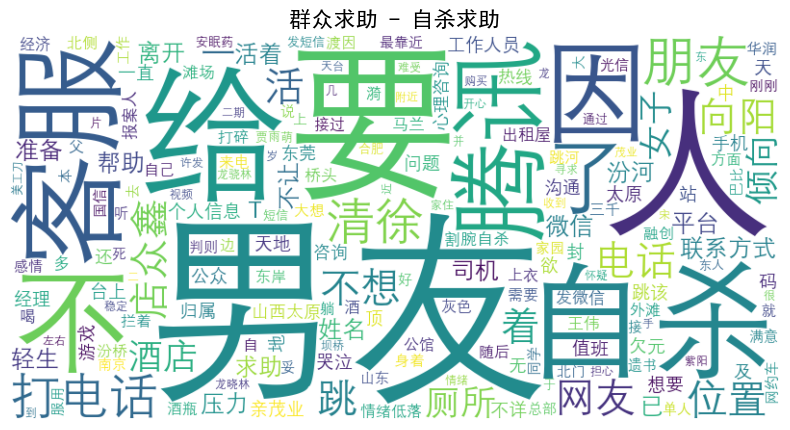

警情粗略类别: 群众求助 - 警情细致类别: 走失求助
求助: 9
离开: 7
后: 5
儿子: 5
找: 5
一直: 4
不到: 4
弟弟: 3
从家: 3
人: 3
马淑婷: 3
姐姐: 3
从: 3
家中: 3
女儿: 2
吵架: 2
学校: 2
未: 2
回家: 2
联系: 2
看到: 2
一名: 2
父亲: 2
少年宫: 2
内: 2
朋友: 2
走失: 2
和: 2
未归: 2
水: 1
中午: 1
不知去向: 1
杨家: 1
峪东: 1
不: 1
接电话: 1
担心: 1
安全: 1
问题: 1
尚依晨: 1
因: 1
爱人: 1
从城: 1
育英: 1
放学: 1
至今: 1
未到: 1
也: 1
没: 1
手机: 1
如此: 1
情况: 1
请人: 1
奥: 1
林下: 1
卷东: 1
男孩: 1
家长: 1
孩子: 1
哭: 1
具体情况: 1
无法: 1
询问: 1
许北富力: 1
广场: 1
母亲: 1
此: 1
走散: 1
未找到: 1
大南门: 1
刚刚: 1
山西: 1
中医药大学: 1
附属: 1
医: 1
收到: 1
同学: 1
发来: 1
微信: 1
让: 1
帮忙: 1
最近: 1
心情: 1
不好: 1
下午: 1
给: 1
发送: 1
抖音: 1
信息: 1
不医想: 1
死: 1
南内环: 1
西南角: 1
杨敬文: 1
干西: 1
姐夫: 1
闹矛盾: 1
干: 1
婆婆: 1
候未: 1
说: 1
去: 1
哪: 1
直至: 1
岁: 1
左右: 1
老大娘: 1
家: 1
老人: 1
穿: 1
黑底: 1
黄花: 1
棉袄: 1
红: 1
围裙: 1
丈: 1
委会: 1
附近: 1
康泽林: 1
昨天: 1
早晨: 1
尚: 1
安徽: 1
不上: 1
亲戚: 1
到: 1
无人: 1
许: 1
王保: 1
至: 1
目前: 1




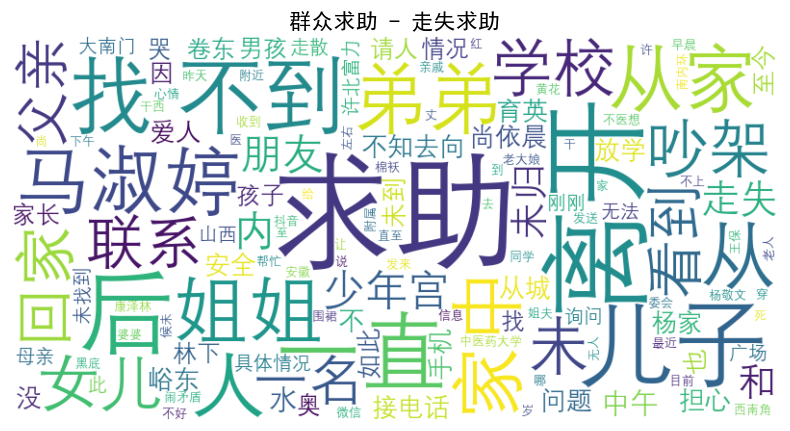

警情粗略类别: 群体事件 - 警情细致类别: 其它群体警情
问题: 10
反映: 6
不让: 6
余名: 6
因: 4
堵门: 4
内: 4
委会: 4
名: 3
工资: 3
工地: 3
工人: 3
公司: 3
群体: 2
行为: 2
房屋: 2
力特: 2
健身房: 2
维权: 2
进去: 2
是: 2
余: 2
人员: 2
居民: 2
要: 2
讨要: 2
杨家: 2
峪: 2
小: 2
东台: 2
停水: 2
业主: 2
无人: 2
不详: 2
影响: 2
家长: 2
出租车: 1
无: 1
过激: 1
北中能: 1
文化: 1
创意: 1
园人: 1
开车: 1
太局: 1
西: 1
刘钧案: 1
余人此: 1
山机: 1
十六: 1
宿舍: 1
拆迁: 1
余人: 1
回迁: 1
安置: 1
新: 1
展览馆: 1
内飞: 1
花元: 1
购买: 1
终身: 1
健身卡: 1
因飞: 1
倒闭: 1
无法: 1
使用: 1
包括: 1
名人: 1
此: 1
保安: 1
已经: 1
此等: 1
一: 1
下午: 1
没: 1
见到: 1
领导: 1
准备: 1
采取: 1
激烈: 1
场: 1
都: 1
老年人: 1
担心: 1
发生冲突: 1
进出: 1
东岗巷: 1
山西太原: 1
第三: 1
干休所: 1
办公: 1
下: 1
二十余名: 1
水电: 1
拉: 1
横幅: 1
内容: 1
我们: 1
生活: 1
等等: 1
钟前: 1
长宝佳: 1
近山庭: 1
电闸: 1
关闭: 1
施工: 1
杏花: 1
岭局: 1
张桂峰: 1
副局长: 1
报: 1
西华: 1
苑: 1
小学: 1
二三年: 1
级: 1
学生家长: 1
人到: 1
教育局: 1
回主校: 1
上课: 1
已: 1
上访: 1
全部: 1
信访: 1
大厅: 1
老人: 1
坐: 1
着: 1
车辆通行: 1
早上: 1
许往: 1
南米: 1
优客: 1
酒店: 1
光华: 1
建筑: 1
多名: 1
榆次: 1
同事: 1
被: 1
堵: 1
出去: 1
接待: 1
职工: 1
坚持: 1
见: 1
局长: 1
原因: 1
恒大: 1
森林: 1
府售部: 1
返还: 1
维修: 1
基金: 1
款事: 1
处理: 1
目前: 1
名业: 1
主场: 1
下班: 1
省建

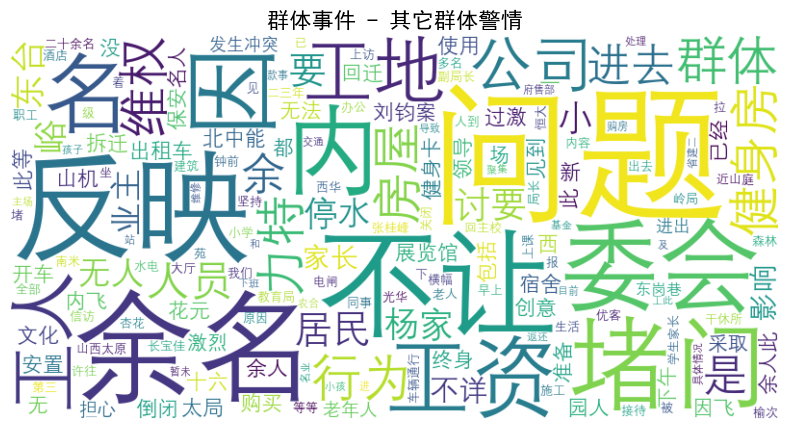

警情粗略类别: 群体事件 - 警情细致类别: 聚众上访
问题: 17
反映: 11
大厅: 8
上访: 7
人: 7
信访: 7
全部: 6
进: 5
业主: 5
因: 4
迎泽: 4
人员: 4
投资: 4
出租车: 3
不: 3
堵门: 3
无: 3
横幅: 3
劝离: 3
难度: 3
送: 3
东流: 3
正: 3
接待: 3
交房: 3
职工: 3
余人: 2
拆迁: 2
内: 2
情况: 2
局报: 2
山西省: 2
信访局: 2
煤矿: 2
堵: 2
场: 2
天禧: 2
城: 2
小: 2
限: 2
公司: 2
较大: 2
聚集: 2
局: 2
短信: 2
来自: 1
司机: 1
更换: 1
车辆: 1
电话: 1
通知: 1
山西: 1
焦煤: 1
东门: 1
柳林: 1
农民: 1
当地: 1
款: 1
来此: 1
辆: 1
左右: 1
新: 1
便: 1
道: 1
停放: 1
因商: 1
关: 1
告知: 1
班长: 1
郝秀梅: 1
带班: 1
指挥: 1
长: 1
李敏: 1
周义成: 1
公安局: 1
霍东局: 1
立案: 1
大于: 1
临汾: 1
进入: 1
凯通: 1
名: 1
长沟: 1
家属: 1
警力: 1
省: 1
西山: 1
煤电: 1
娄烦: 1
马家岩: 1
施工人员: 1
拖欠工资: 1
余: 1
退休职工: 1
购房: 1
了: 1
单位: 1
进出: 1
小门: 1
没拉: 1
没: 1
余名: 1
尖富力: 1
等待: 1
一个: 1
没人: 1
朔州: 1
右玉: 1
宏宇诚: 1
铸: 1
建设工程: 1
劳动合同: 1
劲松: 1
报告: 1
长子: 1
杨四女: 1
拖欠: 1
工程款: 1
杏: 1
红星: 1
天悦: 1
目前: 1
已: 1
劝: 1
至: 1
开展: 1
工作: 1
十余: 1
原因: 1
不清: 1
报杏: 1
东台: 1
自来水: 1
接通: 1
报: 1
安昌: 1
矿山: 1
驻华: 1
阳二矿: 1
项目部: 1
保险: 1
和: 1
待遇: 1
六七十个: 1
富力: 1
书记: 1
门不进: 1
临社: 1
平则: 1
政府: 1
侵占: 1
土地: 1
按: 1
要求: 1




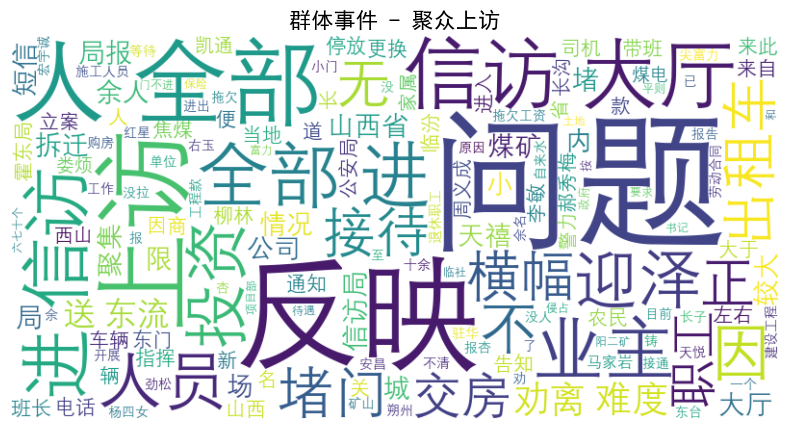

In [6]:
groups = df_unique.groupby(['bjlbmc警情粗略类别', 'bjlxmc警情细致类别'])

# 打开文件准备写入
with open('model/category.txt', 'w', encoding='utf-8') as f:
    for (coarse, fine), group in groups:
        text = ' '.join(group['bjnr报警内容'])
        word_list = jieba.lcut(text)

        # 过滤空格字符
        word_list_filtered = [word for word in word_list if word.strip() != '']
        counter = Counter(word_list_filtered)
        
        # 输出词频统计结果
        print(f"警情粗略类别: {coarse} - 警情细致类别: {fine}")
        for word, count in counter.most_common():  # 只输出前10个词汇及其频次
            print(f"{word}: {count}")
            f.write(f"{word}\n")
        print("\n")

        # 生成词云
        word_cloud_text = ' '.join(word_list)
        wordcloud = WordCloud(font_path='./Deng.ttf', width=800, height=400, background_color='white').generate(word_cloud_text)
        
        plt.figure(figsize=(10, 5))
        plt.imshow(wordcloud, interpolation='bilinear')
        plt.axis('off')
        plt.title(f'{coarse} - {fine}', fontname='SimHei', fontsize=16)
        plt.show()

In [1]:
#训练次数

epochs=100

In [2]:
#bert分词器主函数

import pandas as pd
import torch
from transformers import BertModel,BertTokenizer, BertForSequenceClassification, AdamW, get_linear_schedule_with_warmup
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from torch.utils.data import TensorDataset, DataLoader, RandomSampler, SequentialSampler

vocab_file = 'model/vocab.txt'
tokenizer = BertTokenizer(vocab_file)
bert = BertModel.from_pretrained("model/bert-base-chinese/")


# 加载提供的 Excel 文件
file_path = './data/cleand.xlsx'
data = pd.read_excel(file_path, sheet_name='Sheet1')

# 删除重复项
data_cleaned = data.drop_duplicates()

# 选择相关列
columns_to_keep = ['bjnr报警内容', 'bjlbmc警情粗略类别', 'bjlxmc警情细致类别']
data_cleaned = data_cleaned[columns_to_keep]

# 组合标签以便训练
data_cleaned['labels'] = data_cleaned['bjlbmc警情粗略类别'] + ' - ' + data_cleaned['bjlxmc警情细致类别']

# 初始化分词器
data_cleaned['bjnr报警内容'] = data_cleaned['bjnr报警内容'].astype(str)
tokenizer = BertTokenizer.from_pretrained('bert-base-chinese')

# 分词函数
def tokenize_function(examples):
    return tokenizer(examples['bjnr报警内容'], padding="max_length", truncation=True)

# 将分词器应用于数据
data_cleaned['inputs'] = data_cleaned['bjnr报警内容'].apply(lambda x: tokenizer(x, padding="max_length", truncation=True, return_tensors="pt"))

# 编码标签
label_encoder = LabelEncoder()
data_cleaned['label_ids'] = label_encoder.fit_transform(data_cleaned['labels'])


# 将数据分割为训练集和测试集
train_data, test_data = train_test_split(data_cleaned, test_size=0.0025)

# 提取训练集和测试集的文本和标签
train_texts, train_labels = train_data['inputs'], train_data['label_ids']
test_texts, test_labels = test_data['inputs'], test_data['label_ids']

# 转换为张量
def convert_to_tensors(texts, labels):
    input_ids = [text['input_ids'][0] for text in texts]
    attention_masks = [text['attention_mask'][0] for text in texts]
    labels = torch.tensor(labels.tolist())  # 将 Series 转换为列表再转换为张量
    return torch.stack(input_ids), torch.stack(attention_masks), labels

train_input_ids, train_attention_masks, train_labels = convert_to_tensors(train_texts, train_labels)
test_input_ids, test_attention_masks, test_labels = convert_to_tensors(test_texts, test_labels)

# 创建数据集和数据加载器
train_dataset = TensorDataset(train_input_ids, train_attention_masks, train_labels)
test_dataset = TensorDataset(test_input_ids, test_attention_masks, test_labels)

train_dataloader = DataLoader(train_dataset, sampler=RandomSampler(train_dataset), batch_size=16)
test_dataloader = DataLoader(test_dataset, sampler=SequentialSampler(test_dataset), batch_size=16)

# 加载模型
model = BertForSequenceClassification.from_pretrained("bert-base-chinese", num_labels=len(label_encoder.classes_))

# 设置优化器和学习率调度器
optimizer = AdamW(model.parameters(), lr=2e-5, eps=1e-8)
total_steps = len(train_dataloader) * epochs  # 假设进行 n 个 epoch
scheduler = get_linear_schedule_with_warmup(optimizer, num_warmup_steps=0, num_training_steps=total_steps)

# 设置设备
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)


c:\Users\18080\AppData\Local\Programs\Python\Python310\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-chinese and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
c:\Users\18080\AppData\Local\Programs\Python\Python310\lib\site-packages\transformers\optimization.py:588: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(


BertForSequenceClassification(
  (bert): BertModel(
    (embeddings): BertEmbeddings(
      (word_embeddings): Embedding(21128, 768, padding_idx=0)
      (position_embeddings): Embedding(512, 768)
      (token_type_embeddings): Embedding(2, 768)
      (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (encoder): BertEncoder(
      (layer): ModuleList(
        (0-11): 12 x BertLayer(
          (attention): BertAttention(
            (self): BertSdpaSelfAttention(
              (query): Linear(in_features=768, out_features=768, bias=True)
              (key): Linear(in_features=768, out_features=768, bias=True)
              (value): Linear(in_features=768, out_features=768, bias=True)
              (dropout): Dropout(p=0.1, inplace=False)
            )
            (output): BertSelfOutput(
              (dense): Linear(in_features=768, out_features=768, bias=True)
              (LayerNorm): LayerNorm((768,), eps=1e

In [9]:
#训练函数

from tqdm import tqdm
import os

# 定义保存检查点的目录
checkpoint_dir = './checkpoints/'
os.makedirs(checkpoint_dir, exist_ok=True)


def load_checkpoint(model, optimizer, scheduler, checkpoint_path):
    checkpoint = torch.load(checkpoint_path)
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    scheduler.load_state_dict(checkpoint['scheduler_state_dict'])
    start_epoch = checkpoint['epoch'] + 1  # 从下一个epoch开始
    loss = checkpoint['loss']
    print(f"Checkpoint loaded: epoch {start_epoch-1}, loss {loss:.4f}")
    return model, optimizer, scheduler, start_epoch

# 检查是否存在检查点
checkpoint_path = os.path.join(checkpoint_dir, 'latest_checkpoint.pt')
if os.path.exists(checkpoint_path):
    model, optimizer, scheduler, start_epoch = load_checkpoint(model, optimizer, scheduler, checkpoint_path)
else:
    start_epoch = 0


for epoch in range(epochs):
    model.train()
    total_loss = 0  # 初始化总损失
    for step, batch in enumerate(tqdm(train_dataloader, desc=f"Training Epoch {epoch+1}")):
        batch_input_ids, batch_attention_masks, batch_labels = tuple(t.to(device) for t in batch)
        model.zero_grad()
        outputs = model(batch_input_ids, attention_mask=batch_attention_masks, labels=batch_labels)
        loss = outputs.loss
        total_loss += loss.item()  # 累加损失值
        loss.backward()
        optimizer.step()
        scheduler.step()

    avg_loss = total_loss / len(train_dataloader)  # 计算平均损失
    print(f"Epoch {epoch+1}/{epochs}, Loss: {avg_loss:.4f}")  # 输出平均损失

    # 保存检查点
    checkpoint_filepath = os.path.join(checkpoint_dir, 'latest_checkpoint.pt')
    torch.save({
        'epoch': epoch,
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'scheduler_state_dict': scheduler.state_dict(),
        'loss': avg_loss,
    }, checkpoint_filepath)
    print(f"Checkpoint saved at {checkpoint_filepath}")



Training Epoch 1:   0%|          | 0/49 [00:00<?, ?it/s]c:\Users\18080\AppData\Local\Programs\Python\Python310\lib\site-packages\transformers\models\bert\modeling_bert.py:435: UserWarning: 1Torch was not compiled with flash attention. (Triggered internally at ..\aten\src\ATen\native\transformers\cuda\sdp_utils.cpp:455.)
  attn_output = torch.nn.functional.scaled_dot_product_attention(
Training Epoch 1: 100%|██████████| 49/49 [00:35<00:00,  1.39it/s]


Epoch 1/100, Loss: 4.1421
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 2: 100%|██████████| 49/49 [00:40<00:00,  1.22it/s]


Epoch 2/100, Loss: 3.6539
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 3: 100%|██████████| 49/49 [00:47<00:00,  1.03it/s]


Epoch 3/100, Loss: 3.1371
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 4: 100%|██████████| 49/49 [00:53<00:00,  1.08s/it]


Epoch 4/100, Loss: 2.5822
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 5: 100%|██████████| 49/49 [00:56<00:00,  1.16s/it]


Epoch 5/100, Loss: 2.1471
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 6: 100%|██████████| 49/49 [00:58<00:00,  1.20s/it]


Epoch 6/100, Loss: 1.8155
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 7: 100%|██████████| 49/49 [01:02<00:00,  1.28s/it]


Epoch 7/100, Loss: 1.4861
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 8: 100%|██████████| 49/49 [01:02<00:00,  1.27s/it]


Epoch 8/100, Loss: 1.2560
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 9: 100%|██████████| 49/49 [01:03<00:00,  1.29s/it]


Epoch 9/100, Loss: 1.0494
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 10: 100%|██████████| 49/49 [01:00<00:00,  1.24s/it]


Epoch 10/100, Loss: 0.8776
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 11: 100%|██████████| 49/49 [01:02<00:00,  1.27s/it]


Epoch 11/100, Loss: 0.7187
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 12: 100%|██████████| 49/49 [00:44<00:00,  1.11it/s]


Epoch 12/100, Loss: 0.6024
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 13: 100%|██████████| 49/49 [00:40<00:00,  1.21it/s]


Epoch 13/100, Loss: 0.5097
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 14: 100%|██████████| 49/49 [00:39<00:00,  1.25it/s]


Epoch 14/100, Loss: 0.4354
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 15: 100%|██████████| 49/49 [00:39<00:00,  1.24it/s]


Epoch 15/100, Loss: 0.3736
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 16: 100%|██████████| 49/49 [00:40<00:00,  1.21it/s]


Epoch 16/100, Loss: 0.3221
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 17: 100%|██████████| 49/49 [00:39<00:00,  1.25it/s]


Epoch 17/100, Loss: 0.2826
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 18: 100%|██████████| 49/49 [00:38<00:00,  1.26it/s]


Epoch 18/100, Loss: 0.2470
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 19: 100%|██████████| 49/49 [00:39<00:00,  1.24it/s]


Epoch 19/100, Loss: 0.2223
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 20: 100%|██████████| 49/49 [00:39<00:00,  1.25it/s]


Epoch 20/100, Loss: 0.2036
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 21: 100%|██████████| 49/49 [00:39<00:00,  1.24it/s]


Epoch 21/100, Loss: 0.1824
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 22: 100%|██████████| 49/49 [00:40<00:00,  1.22it/s]


Epoch 22/100, Loss: 0.1663
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 23: 100%|██████████| 49/49 [00:40<00:00,  1.21it/s]


Epoch 23/100, Loss: 0.1503
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 24: 100%|██████████| 49/49 [00:41<00:00,  1.19it/s]


Epoch 24/100, Loss: 0.1395
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 25: 100%|██████████| 49/49 [00:40<00:00,  1.20it/s]


Epoch 25/100, Loss: 0.1271
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 26: 100%|██████████| 49/49 [00:40<00:00,  1.21it/s]


Epoch 26/100, Loss: 0.1210
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 27: 100%|██████████| 49/49 [00:40<00:00,  1.21it/s]


Epoch 27/100, Loss: 0.1121
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 28: 100%|██████████| 49/49 [00:39<00:00,  1.24it/s]


Epoch 28/100, Loss: 0.1030
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 29: 100%|██████████| 49/49 [00:39<00:00,  1.25it/s]


Epoch 29/100, Loss: 0.0948
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 30: 100%|██████████| 49/49 [00:39<00:00,  1.25it/s]


Epoch 30/100, Loss: 0.0881
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 31: 100%|██████████| 49/49 [00:39<00:00,  1.25it/s]


Epoch 31/100, Loss: 0.0842
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 32: 100%|██████████| 49/49 [00:39<00:00,  1.25it/s]


Epoch 32/100, Loss: 0.0794
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 33: 100%|██████████| 49/49 [00:38<00:00,  1.26it/s]


Epoch 33/100, Loss: 0.0756
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 34: 100%|██████████| 49/49 [00:38<00:00,  1.26it/s]


Epoch 34/100, Loss: 0.0687
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 35: 100%|██████████| 49/49 [00:39<00:00,  1.25it/s]


Epoch 35/100, Loss: 0.0667
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 36: 100%|██████████| 49/49 [00:38<00:00,  1.26it/s]


Epoch 36/100, Loss: 0.0642
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 37: 100%|██████████| 49/49 [00:38<00:00,  1.26it/s]


Epoch 37/100, Loss: 0.0623
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 38: 100%|██████████| 49/49 [00:38<00:00,  1.26it/s]


Epoch 38/100, Loss: 0.0576
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 39: 100%|██████████| 49/49 [00:39<00:00,  1.25it/s]


Epoch 39/100, Loss: 0.0559
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 40: 100%|██████████| 49/49 [00:38<00:00,  1.26it/s]


Epoch 40/100, Loss: 0.0530
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 41: 100%|██████████| 49/49 [00:39<00:00,  1.25it/s]


Epoch 41/100, Loss: 0.0502
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 42: 100%|██████████| 49/49 [00:39<00:00,  1.25it/s]


Epoch 42/100, Loss: 0.0486
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 43: 100%|██████████| 49/49 [00:39<00:00,  1.25it/s]


Epoch 43/100, Loss: 0.0476
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 44: 100%|██████████| 49/49 [00:39<00:00,  1.25it/s]


Epoch 44/100, Loss: 0.0450
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 45: 100%|██████████| 49/49 [00:39<00:00,  1.25it/s]


Epoch 45/100, Loss: 0.0437
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 46: 100%|██████████| 49/49 [00:39<00:00,  1.24it/s]


Epoch 46/100, Loss: 0.0418
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 47: 100%|██████████| 49/49 [00:39<00:00,  1.25it/s]


Epoch 47/100, Loss: 0.0400
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 48: 100%|██████████| 49/49 [00:39<00:00,  1.25it/s]


Epoch 48/100, Loss: 0.0391
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 49: 100%|██████████| 49/49 [00:38<00:00,  1.26it/s]


Epoch 49/100, Loss: 0.0377
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 50: 100%|██████████| 49/49 [00:39<00:00,  1.26it/s]


Epoch 50/100, Loss: 0.0365
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 51: 100%|██████████| 49/49 [00:39<00:00,  1.25it/s]


Epoch 51/100, Loss: 0.0346
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 52: 100%|██████████| 49/49 [00:39<00:00,  1.24it/s]


Epoch 52/100, Loss: 0.0340
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 53: 100%|██████████| 49/49 [00:39<00:00,  1.24it/s]


Epoch 53/100, Loss: 0.0330
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 54: 100%|██████████| 49/49 [00:39<00:00,  1.25it/s]


Epoch 54/100, Loss: 0.0323
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 55: 100%|██████████| 49/49 [00:39<00:00,  1.25it/s]


Epoch 55/100, Loss: 0.0311
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 56: 100%|██████████| 49/49 [00:39<00:00,  1.24it/s]


Epoch 56/100, Loss: 0.0309
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 57: 100%|██████████| 49/49 [00:38<00:00,  1.26it/s]


Epoch 57/100, Loss: 0.0294
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 58: 100%|██████████| 49/49 [00:39<00:00,  1.25it/s]


Epoch 58/100, Loss: 0.0285
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 59: 100%|██████████| 49/49 [00:39<00:00,  1.25it/s]


Epoch 59/100, Loss: 0.0276
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 60: 100%|██████████| 49/49 [00:38<00:00,  1.26it/s]


Epoch 60/100, Loss: 0.0272
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 61: 100%|██████████| 49/49 [00:39<00:00,  1.25it/s]


Epoch 61/100, Loss: 0.0262
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 62: 100%|██████████| 49/49 [00:38<00:00,  1.26it/s]


Epoch 62/100, Loss: 0.0258
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 63: 100%|██████████| 49/49 [00:39<00:00,  1.26it/s]


Epoch 63/100, Loss: 0.0255
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 64: 100%|██████████| 49/49 [00:38<00:00,  1.26it/s]


Epoch 64/100, Loss: 0.0247
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 65: 100%|██████████| 49/49 [00:38<00:00,  1.26it/s]


Epoch 65/100, Loss: 0.0247
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 66: 100%|██████████| 49/49 [00:39<00:00,  1.24it/s]


Epoch 66/100, Loss: 0.0240
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 67: 100%|██████████| 49/49 [00:39<00:00,  1.25it/s]


Epoch 67/100, Loss: 0.0237
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 68: 100%|██████████| 49/49 [00:39<00:00,  1.24it/s]


Epoch 68/100, Loss: 0.0226
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 69: 100%|██████████| 49/49 [00:39<00:00,  1.25it/s]


Epoch 69/100, Loss: 0.0222
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 70: 100%|██████████| 49/49 [00:39<00:00,  1.24it/s]


Epoch 70/100, Loss: 0.0226
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 71: 100%|██████████| 49/49 [00:39<00:00,  1.25it/s]


Epoch 71/100, Loss: 0.0213
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 72: 100%|██████████| 49/49 [00:38<00:00,  1.26it/s]


Epoch 72/100, Loss: 0.0214
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 73: 100%|██████████| 49/49 [00:39<00:00,  1.25it/s]


Epoch 73/100, Loss: 0.0207
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 74: 100%|██████████| 49/49 [00:39<00:00,  1.25it/s]


Epoch 74/100, Loss: 0.0206
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 75: 100%|██████████| 49/49 [00:39<00:00,  1.25it/s]


Epoch 75/100, Loss: 0.0201
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 76: 100%|██████████| 49/49 [00:39<00:00,  1.25it/s]


Epoch 76/100, Loss: 0.0194
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 77: 100%|██████████| 49/49 [00:39<00:00,  1.24it/s]


Epoch 77/100, Loss: 0.0193
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 78: 100%|██████████| 49/49 [00:39<00:00,  1.24it/s]


Epoch 78/100, Loss: 0.0190
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 79: 100%|██████████| 49/49 [00:39<00:00,  1.25it/s]


Epoch 79/100, Loss: 0.0186
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 80: 100%|██████████| 49/49 [00:39<00:00,  1.24it/s]


Epoch 80/100, Loss: 0.0177
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 81: 100%|██████████| 49/49 [00:39<00:00,  1.23it/s]


Epoch 81/100, Loss: 0.0178
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 82: 100%|██████████| 49/49 [00:39<00:00,  1.24it/s]


Epoch 82/100, Loss: 0.0177
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 83: 100%|██████████| 49/49 [00:39<00:00,  1.25it/s]


Epoch 83/100, Loss: 0.0172
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 84: 100%|██████████| 49/49 [00:39<00:00,  1.23it/s]


Epoch 84/100, Loss: 0.0173
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 85: 100%|██████████| 49/49 [00:39<00:00,  1.25it/s]


Epoch 85/100, Loss: 0.0171
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 86: 100%|██████████| 49/49 [00:39<00:00,  1.25it/s]


Epoch 86/100, Loss: 0.0170
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 87: 100%|██████████| 49/49 [00:39<00:00,  1.25it/s]


Epoch 87/100, Loss: 0.0171
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 88: 100%|██████████| 49/49 [00:39<00:00,  1.25it/s]


Epoch 88/100, Loss: 0.0169
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 89: 100%|██████████| 49/49 [00:39<00:00,  1.25it/s]


Epoch 89/100, Loss: 0.0166
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 90: 100%|██████████| 49/49 [00:39<00:00,  1.25it/s]


Epoch 90/100, Loss: 0.0163
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 91: 100%|██████████| 49/49 [00:39<00:00,  1.24it/s]


Epoch 91/100, Loss: 0.0168
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 92: 100%|██████████| 49/49 [00:39<00:00,  1.23it/s]


Epoch 92/100, Loss: 0.0163
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 93: 100%|██████████| 49/49 [00:39<00:00,  1.25it/s]


Epoch 93/100, Loss: 0.0162
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 94: 100%|██████████| 49/49 [00:39<00:00,  1.24it/s]


Epoch 94/100, Loss: 0.0160
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 95: 100%|██████████| 49/49 [00:39<00:00,  1.24it/s]


Epoch 95/100, Loss: 0.0160
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 96: 100%|██████████| 49/49 [00:39<00:00,  1.24it/s]


Epoch 96/100, Loss: 0.0161
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 97: 100%|██████████| 49/49 [00:39<00:00,  1.25it/s]


Epoch 97/100, Loss: 0.0154
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 98: 100%|██████████| 49/49 [00:39<00:00,  1.24it/s]


Epoch 98/100, Loss: 0.0159
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 99: 100%|██████████| 49/49 [00:39<00:00,  1.25it/s]


Epoch 99/100, Loss: 0.0156
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


Training Epoch 100: 100%|██████████| 49/49 [00:39<00:00,  1.24it/s]


Epoch 100/100, Loss: 0.0156
Checkpoint saved at ./checkpoints/latest_checkpoint.pt


In [5]:
import pandas as pd

# 假设你已经加载了清理过的数据到 data_cleaned 变量中
# 提取标签及其对应的ID
labels_and_ids = data_cleaned[['labels', 'label_ids']].drop_duplicates().sort_values('label_ids')

# 保存到CSV文件
labels_and_ids.to_csv('./data/labels_and_ids.csv', index=False)

print(labels_and_ids.head())


            labels  label_ids
698  举报线索 - 其它举报线索          0
679    举报线索 - 提供线索          1
344    交通警情 - 交通事故          2
437    交通警情 - 交通保障          3
422    交通警情 - 交通秩序          4


In [11]:
from sklearn.metrics import classification_report

model.eval()
predictions, true_labels = [], []

for batch in test_dataloader:
    batch_input_ids, batch_attention_masks, batch_labels = tuple(t.to(device) for t in batch)
    with torch.no_grad():
        outputs = model(batch_input_ids, attention_mask=batch_attention_masks)
    logits = outputs.logits
    predictions.extend(torch.argmax(logits, axis=-1).cpu().numpy())
    true_labels.extend(batch_labels.cpu().numpy())

# 生成分类报告，确保标签数量匹配
target_names = label_encoder.classes_.tolist()
all_labels = list(range(len(target_names)))  # 包含所有标签的范围

print(classification_report(true_labels, predictions, labels=all_labels, target_names=target_names))


                    precision    recall  f1-score   support

     举报线索 - 其它举报线索       0.00      0.00      0.00         0
       举报线索 - 提供线索       0.00      0.00      0.00         0
       交通警情 - 交通事故       0.00      0.00      0.00         0
       交通警情 - 交通保障       0.00      0.00      0.00         0
       交通警情 - 交通秩序       0.00      0.00      0.00         0
       交通警情 - 交通设施       0.00      0.00      0.00         0
       交通警情 - 交通违法       0.00      0.00      0.00         0
       交通警情 - 交通逃逸       0.00      0.00      0.00         0
     交通警情 - 其它交通管理       0.00      0.00      0.00         0
   其他报警类别 - 其它报警类型       0.00      0.00      0.00         1
         刑事案件 - 伤害       0.00      0.00      0.00         0
      刑事案件 - 其它刑警情       0.00      0.00      0.00         0
         刑事案件 - 强奸       0.00      0.00      0.00         0
         刑事案件 - 抢劫       0.00      0.00      0.00         0
         刑事案件 - 抢夺       0.00      0.00      0.00         0
       刑事案件 - 敲诈勒索       0.00      0.00

c:\Users\18080\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\18080\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\18080\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, mod

In [3]:
#独立测试函数


import pandas as pd
import torch
from transformers import BertModel,BertTokenizer
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
import os
from sklearn.metrics import accuracy_score,classification_report

vocab_file = 'model/vocab.txt'
tokenizer = BertTokenizer(vocab_file)
bert = BertModel.from_pretrained("model/bert-base-chinese/")



# 加载提供的 Excel 文件
file_path = './data/cleand.xlsx'
data = pd.read_excel(file_path, sheet_name='Sheet1')
# 删除重复项
data_cleaned = data.drop_duplicates()
# 选择相关列
columns_to_keep = ['bjnr报警内容', 'bjlbmc警情粗略类别', 'bjlxmc警情细致类别']
data_cleaned = data_cleaned[columns_to_keep]
# 组合标签以便训练
data_cleaned['labels'] = data_cleaned['bjlbmc警情粗略类别'] + ' - ' + data_cleaned['bjlxmc警情细致类别']
# 初始化分词器
data_cleaned['bjnr报警内容'] = data_cleaned['bjnr报警内容'].astype(str)
tokenizer = BertTokenizer.from_pretrained('bert-base-chinese')
# 分词函数
def tokenize_function(examples):
    return tokenizer(examples['bjnr报警内容'], padding="max_length", truncation=True)
# 将分词器应用于数据
data_cleaned['inputs'] = data_cleaned['bjnr报警内容'].apply(lambda x: tokenizer(x, padding="max_length", truncation=True, return_tensors="pt"))
# 编码标签
label_encoder = LabelEncoder()
data_cleaned['label_ids'] = label_encoder.fit_transform(data_cleaned['labels'])




# 将数据分割为训练集和测试集
train_data, test_data = train_test_split(data_cleaned, test_size=0.995)

# 保存训练集和测试集到Excel文件
train_data.to_excel('data/train_data.xlsx', index=False)
test_data.to_excel('data/test_data.xlsx', index=False)


# 提取训练集和测试集的文本和标签
train_texts, train_labels = train_data['inputs'], train_data['label_ids']
test_texts, test_labels = test_data['inputs'], test_data['label_ids']

# 转换为张量
def convert_to_tensors(texts, labels):
    input_ids = [text['input_ids'][0] for text in texts]
    attention_masks = [text['attention_mask'][0] for text in texts]
    labels = torch.tensor(labels.tolist())  # 将 Series 转换为列表再转换为张量
    return torch.stack(input_ids), torch.stack(attention_masks), labels

train_input_ids, train_attention_masks, train_labels = convert_to_tensors(train_texts, train_labels)
test_input_ids, test_attention_masks, test_labels = convert_to_tensors(test_texts, test_labels)

# 创建数据集和数据加载器
train_dataset = TensorDataset(train_input_ids, train_attention_masks, train_labels)
test_dataset = TensorDataset(test_input_ids, test_attention_masks, test_labels)

train_dataloader = DataLoader(train_dataset, sampler=RandomSampler(train_dataset), batch_size=16)
test_dataloader = DataLoader(test_dataset, sampler=SequentialSampler(test_dataset), batch_size=16)

# 加载模型
model = BertForSequenceClassification.from_pretrained("bert-base-chinese", num_labels=len(label_encoder.classes_))

# 设置优化器和学习率调度器
optimizer = AdamW(model.parameters(), lr=2e-5, eps=1e-8)
total_steps = len(train_dataloader) * 100  # 假设进行 n 个 epoch
scheduler = get_linear_schedule_with_warmup(optimizer, num_warmup_steps=0, num_training_steps=total_steps)

# 设置设备
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

# 定义保存检查点的目录
checkpoint_dir = './checkpoints/'
os.makedirs(checkpoint_dir, exist_ok=True)


def load_checkpoint(model, optimizer, scheduler, checkpoint_path):
    checkpoint = torch.load(checkpoint_path)
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    scheduler.load_state_dict(checkpoint['scheduler_state_dict'])
    start_epoch = checkpoint['epoch'] + 1  # 从下一个epoch开始
    loss = checkpoint['loss']
    print(f"Checkpoint loaded: epoch {start_epoch-1}, loss {loss:.4f}")
    return model, optimizer, scheduler, start_epoch

# 读取检查点
checkpoint_path = os.path.join(checkpoint_dir, 'latest_checkpoint.pt')
if os.path.exists(checkpoint_path):
    model, optimizer, scheduler, start_epoch = load_checkpoint(model, optimizer, scheduler, checkpoint_path)
else:
    print("Do not find checkpoints.")



# 计算准确度



model.eval()
predictions, true_labels = [], []

for batch in test_dataloader:
    batch_input_ids, batch_attention_masks, batch_labels = tuple(t.to(device) for t in batch)
    with torch.no_grad():
        outputs = model(batch_input_ids, attention_mask=batch_attention_masks)
    logits = outputs.logits
    predictions.extend(torch.argmax(logits, axis=-1).cpu().numpy())
    true_labels.extend(batch_labels.cpu().numpy())

# 生成分类报告，确保标签数量匹配
target_names = label_encoder.classes_.tolist()
all_labels = list(range(len(target_names)))  # 包含所有标签的范围

print(classification_report(true_labels, predictions, labels=all_labels, target_names=target_names))


accuracy = accuracy_score(true_labels, predictions)
print(f"Accuracy: {accuracy}")


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-chinese and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
c:\Users\18080\AppData\Local\Programs\Python\Python310\lib\site-packages\transformers\optimization.py:588: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(


Checkpoint loaded: epoch 99, loss 0.0156
                    precision    recall  f1-score   support

     举报线索 - 其它举报线索       1.00      1.00      1.00        20
       举报线索 - 提供线索       0.95      1.00      0.97        19
       交通警情 - 交通事故       1.00      1.00      1.00        20
       交通警情 - 交通保障       1.00      1.00      1.00         5
       交通警情 - 交通秩序       1.00      1.00      1.00        15
       交通警情 - 交通设施       1.00      1.00      1.00        20
       交通警情 - 交通违法       1.00      1.00      1.00        20
       交通警情 - 交通逃逸       1.00      1.00      1.00        18
     交通警情 - 其它交通管理       1.00      1.00      1.00        20
   其他报警类别 - 其它报警类型       1.00      0.94      0.97        17
         刑事案件 - 伤害       1.00      1.00      1.00         3
      刑事案件 - 其它刑警情       1.00      1.00      1.00        19
         刑事案件 - 强奸       0.94      1.00      0.97        15
         刑事案件 - 抢劫       1.00      1.00      1.00        15
         刑事案件 - 抢夺       1.00      1.00      1.00         

In [6]:
#十折测试
import pandas as pd
import torch
from transformers import BertTokenizer, BertForSequenceClassification, AdamW, get_linear_schedule_with_warmup
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import accuracy_score, classification_report
from torch.utils.data import TensorDataset, DataLoader, RandomSampler, SequentialSampler
import os

# 加载提供的 Excel 文件
file_path = 'bjsj(脱敏).xlsx'
data = pd.read_excel(file_path, sheet_name='Sheet0')
# 删除重复项
data_cleaned = data.drop_duplicates()
# 选择相关列
columns_to_keep = ['bjnr报警内容', 'bjlbmc警情粗略类别', 'bjlxmc警情细致类别']
data_cleaned = data_cleaned[columns_to_keep]
# 组合标签以便训练
data_cleaned['labels'] = data_cleaned['bjlbmc警情粗略类别'] + ' - ' + data_cleaned['bjlxmc警情细致类别']
# 初始化分词器
data_cleaned['bjnr报警内容'] = data_cleaned['bjnr报警内容'].astype(str)
tokenizer = BertTokenizer.from_pretrained('bert-base-chinese')
# 分词函数
def tokenize_function(examples):
    return tokenizer(examples, padding="max_length", truncation=True, return_tensors="pt")
# 将分词器应用于数据
data_cleaned['inputs'] = data_cleaned['bjnr报警内容'].apply(lambda x: tokenize_function(x))
# 编码标签
label_encoder = LabelEncoder()
data_cleaned['label_ids'] = label_encoder.fit_transform(data_cleaned['labels'])

# 提取文本和标签
texts, labels = data_cleaned['inputs'], data_cleaned['label_ids']

# 转换为张量
def convert_to_tensors(texts, labels):
    input_ids = [text['input_ids'][0] for text in texts]
    attention_masks = [text['attention_mask'][0] for text in texts]
    labels = torch.tensor(labels.tolist())  # 将 Series 转换为列表再转换为张量
    return torch.stack(input_ids), torch.stack(attention_masks), labels

input_ids, attention_masks, labels = convert_to_tensors(texts, labels)

# 创建数据集
dataset = TensorDataset(input_ids, attention_masks, labels)

# 设置设备
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# 定义保存检查点的目录
checkpoint_dir = './checkpoints/'
os.makedirs(checkpoint_dir, exist_ok=True)

# 十折交叉验证
k_folds = 10
skf = StratifiedKFold(n_splits=k_folds, shuffle=True, random_state=27)

# 存储每折的预测和真实标签
all_predictions = []
all_true_labels = []

for fold, (train_index, val_index) in enumerate(skf.split(input_ids, labels)):
    print(f'Fold {fold+1}/{k_folds}')

    # 创建训练集和验证集数据加载器
    train_dataset = TensorDataset(input_ids[train_index], attention_masks[train_index], labels[train_index])
    val_dataset = TensorDataset(input_ids[val_index], attention_masks[val_index], labels[val_index])
    
    train_dataloader = DataLoader(train_dataset, sampler=RandomSampler(train_dataset), batch_size=16)
    val_dataloader = DataLoader(val_dataset, sampler=SequentialSampler(val_dataset), batch_size=16)
    
    # 加载模型
    model = BertForSequenceClassification.from_pretrained("bert-base-chinese", num_labels=len(label_encoder.classes_))
    model.to(device)
    
    # 定义优化器和调度器
    optimizer = AdamW(model.parameters(), lr=2e-5, eps=1e-8)
    total_steps = len(train_dataloader) * 1  # 假设每个折只训练一个 epoch
    scheduler = get_linear_schedule_with_warmup(optimizer, num_warmup_steps=0, num_training_steps=total_steps)

    # 读取检查点（如果存在）
    checkpoint_path = os.path.join(checkpoint_dir, f'latest_checkpoint.pt')
    if os.path.exists(checkpoint_path):
        checkpoint = torch.load(checkpoint_path, map_location=device)
        model.load_state_dict(checkpoint['model_state_dict'])
        optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
        scheduler.load_state_dict(checkpoint['scheduler_state_dict'])
        print(f"Checkpoint loaded for fold {fold+1}")
    else:
        print(f"No checkpoint found for fold {fold+1}, skipping.")
        continue

    # 计算验证集上的准确度
    model.eval()
    predictions, true_labels = [], []

    for batch in val_dataloader:
        batch_input_ids, batch_attention_masks, batch_labels = tuple(t.to(device) for t in batch)
        with torch.no_grad():
            outputs = model(batch_input_ids, attention_mask=batch_attention_masks)
        logits = outputs.logits
        predictions.extend(torch.argmax(logits, axis=-1).cpu().numpy())
        true_labels.extend(batch_labels.cpu().numpy())

    all_predictions.extend(predictions)
    all_true_labels.extend(true_labels)

# 生成分类报告，确保标签数量匹配
target_names = label_encoder.classes_.tolist()
all_labels = list(range(len(target_names)))  # 包含所有标签的范围

print(classification_report(all_true_labels, all_predictions, labels=all_labels, target_names=target_names))

accuracy = accuracy_score(all_true_labels, all_predictions)
print(f"Accuracy: {accuracy}")


c:\Users\18080\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\model_selection\_split.py:776: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=10.
  warnings.warn(


Fold 1/10


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-chinese and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
c:\Users\18080\AppData\Local\Programs\Python\Python310\lib\site-packages\transformers\optimization.py:588: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(


Checkpoint loaded for fold 1
Fold 2/10


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-chinese and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Checkpoint loaded for fold 2
Fold 3/10


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-chinese and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Checkpoint loaded for fold 3
Fold 4/10


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-chinese and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Checkpoint loaded for fold 4
Fold 5/10


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-chinese and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Checkpoint loaded for fold 5
Fold 6/10


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-chinese and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Checkpoint loaded for fold 6
Fold 7/10


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-chinese and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Checkpoint loaded for fold 7
Fold 8/10


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-chinese and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Checkpoint loaded for fold 8
Fold 9/10


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-chinese and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Checkpoint loaded for fold 9
Fold 10/10


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-chinese and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Checkpoint loaded for fold 10
                    precision    recall  f1-score   support

     举报线索 - 其它举报线索       1.00      0.75      0.86        20
       举报线索 - 提供线索       1.00      0.40      0.57        20
       交通警情 - 交通事故       1.00      1.00      1.00        20
       交通警情 - 交通保障       1.00      0.60      0.75         5
       交通警情 - 交通秩序       0.93      0.93      0.93        15
       交通警情 - 交通设施       1.00      0.85      0.92        20
       交通警情 - 交通违法       1.00      1.00      1.00        20
       交通警情 - 交通逃逸       1.00      1.00      1.00        20
     交通警情 - 其它交通管理       0.74      0.85      0.79        20
   其他报警类别 - 其它报警类型       0.94      0.85      0.89        20
         刑事案件 - 伤害       1.00      1.00      1.00         3
      刑事案件 - 其它刑警情       0.61      0.95      0.75        20
         刑事案件 - 强奸       0.95      1.00      0.98        20
         刑事案件 - 抢劫       0.69      0.90      0.78        20
         刑事案件 - 抢夺       1.00      0.29      0.44         7
       刑事

c:\Users\18080\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\18080\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\18080\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, mo